# Clustering

NOTE: OLD VERSION WITHOUT ANOMALY DETECTION. SEE NEW VERSION (Clustering with AD)

In [1]:
import os
import pandas as pd
import matplotlib.pyplot as plt
from libraries.clustering import apply_pca, plot_results, apply_tsne, apply_umap
from libraries import clustering
from sklearn.cluster import KMeans, OPTICS, DBSCAN
from scipy.spatial.distance import squareform
from sklearn.cluster import DBSCAN
import numpy as np
from sklearn.cluster import SpectralClustering
from pyclustering.cluster.optics import optics, ordering_analyser
from libraries.clustering import sil_vs_coh
from sklearn.metrics import pairwise_distances

In [2]:
DATASET_DIR = "dataset" + os.sep
RESULTS_DIR = "results" + os.sep

Loading OLD tables

In [3]:
# Load dataset without advanced anomaly detection
merged_df = pd.read_csv(DATASET_DIR + "merge_clean_v2-AD.csv", parse_dates=["date"])
cyclist_df = pd.read_csv(DATASET_DIR + "cyclist_clean_v2-AD.csv")
stages_df = pd.read_csv(DATASET_DIR + "stages_clean_v2-AD.csv", parse_dates=["date"])

In [4]:
cyclist_df.info()
stages_df.info()
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3039 entries, 0 to 3038
Data columns (total 9 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   _url         3039 non-null   object 
 1   name         3039 non-null   object 
 2   birth_year   3039 non-null   int64  
 3   height       3039 non-null   float64
 4   nationality  3039 non-null   object 
 5   avg_pos      3039 non-null   float64
 6   num_races    3039 non-null   int64  
 7   BMI          3039 non-null   float64
 8   continent    3039 non-null   object 
dtypes: float64(3), int64(2), object(4)
memory usage: 213.8+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3021 entries, 0 to 3020
Data columns (total 14 columns):
 #   Column             Non-Null Count  Dtype         
---  ------             --------------  -----         
 0   _url               3021 non-null   object        
 1   stage              3021 non-null   object        
 2   race               3021 non-null   o

In [5]:
# Drop unnecessary columns from the 'cyclist_df' DataFrame.
# These columns are not required for further analysis or modeling, so they are removed.
cyclist_df.drop(columns=["name", "nationality", 'continent', "BMI"], inplace=True)

# Drop unnecessary columns from the 'stages_df' DataFrame.
# These columns are also not needed for the analysis or modeling process.
stages_df.drop(columns=["stage", "date", "race"], inplace=True)

# Reset the index of the 'cyclist_df' DataFrame to ensure continuous and sequential indexing.
# The drop=True argument ensures that the old index is not added as a new column in the DataFrame.
cyclist_df.reset_index(drop=True, inplace=True)

# Reset the index of the 'stages_df' DataFrame similarly to ensure a continuous index.
stages_df.reset_index(drop=True, inplace=True)

# Drop rows containing missing values (NaN) in the 'cyclist_df' DataFrame.
# This ensures that any incomplete data is removed from the DataFrame before analysis or modeling.
cyclist_df = cyclist_df.dropna()

# Drop rows containing missing values (NaN) in the 'stages_df' DataFrame in the same manner.
# This keeps the dataset clean by removing rows with missing or incomplete data.
stages_df = stages_df.dropna()


In [6]:
cyclist_df.info()
stages_df.info()
merged_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3039 entries, 0 to 3038
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   _url        3039 non-null   object 
 1   birth_year  3039 non-null   int64  
 2   height      3039 non-null   float64
 3   avg_pos     3039 non-null   float64
 4   num_races   3039 non-null   int64  
dtypes: float64(2), int64(2), object(1)
memory usage: 118.8+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3021 entries, 0 to 3020
Data columns (total 11 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   _url               3021 non-null   object 
 1   points             3021 non-null   int64  
 2   length             3021 non-null   int64  
 3   climb_total        3021 non-null   int64  
 4   profile            3021 non-null   int64  
 5   startlist_quality  3021 non-null   int64  
 6   year               3021 non-null   int64  
 7  

Scaling of tables

In [7]:
# List of categorical columns for transformation in the 'cyclist_df' DataFrame.
# These columns will not be transformed since we are leaving them as categorical features.
cat_cyclist = []

# List of columns to standardize in the 'cyclist_df' DataFrame.
# These columns will be standardized (i.e., scaled to have mean 0 and standard deviation 1).
stand_cyclist = ["height", "birth_year", 'avg_pos', 'num_races']

# List of columns to apply MinMax scaling in the 'cyclist_df' DataFrame.
# In this case, there are no columns specified for MinMax scaling.
minmax_cyclist = []

# Apply the transformation to the 'cyclist_df' DataFrame using the 'clustering.transform' method.
# It applies standardization, MinMax scaling, and encoding for categorical columns (if any).
# The result is the transformed data and the preprocessor (which holds information about how the data was transformed).
transformed_cyclists_data, preprocessor_cyclists = clustering.transform(
    cyclist_df,
    categorical_cols=cat_cyclist,
    standardize_cols=stand_cyclist,
    minmax_cols=minmax_cyclist,
)

# List of categorical columns for transformation in the 'stages_df' DataFrame.
# These columns are not specified here, as no categorical columns are being transformed.
cat_stage = []

# List of columns to standardize in the 'stages_df' DataFrame.
# These columns will be standardized (i.e., scaled to have mean 0 and standard deviation 1).
stand_stage = ["year", "length", "startlist_quality", 'avg_age_by_url', 'avg_delta_by_url', 'min_age_by_url', 'points']

# List of columns to apply MinMax scaling in the 'stages_df' DataFrame.
# Again, no columns are specified for MinMax scaling.
minmax_stage = []

# Apply the transformation to the 'stages_df' DataFrame using the 'clustering.transform' method.
# This applies standardization, MinMax scaling, and encoding for categorical columns (if any).
transformed_stages_data, preprocessor_stages = clustering.transform(
    stages_df,
    categorical_cols=cat_stage,
    minmax_cols=minmax_stage,
    standardize_cols=stand_stage
)

# Convert the transformed data for cyclists into a DataFrame.
# The transformed data now contains the processed values based on the specified transformations.
transformed_cyclists_df = pd.DataFrame(transformed_cyclists_data)

# Convert the transformed data for stages into a DataFrame.
# Similarly, the transformed stage data is now structured into a DataFrame.
transformed_stages_df = pd.DataFrame(transformed_stages_data)

# Add back the one-hot encoded columns' names to the transformed DataFrame for cyclists.
# This ensures that the transformed DataFrame has appropriate column names reflecting the transformations applied.
transformed_cyclists_df.columns = preprocessor_cyclists.get_feature_names_out(
    cyclist_df.columns
)

# Add back the one-hot encoded columns' names to the transformed DataFrame for stages.
# This ensures that the transformed DataFrame for stages has appropriate column names.
transformed_stages_df.columns = preprocessor_stages.get_feature_names_out(
    stages_df.columns
)

# Reset the index of the transformed cyclists DataFrame to ensure that indices are continuous after transformation.
transformed_cyclists_df.reset_index(drop=True, inplace=True)

# Reset the index of the transformed stages DataFrame in the same way to ensure continuous indices.
transformed_stages_df.reset_index(drop=True, inplace=True)

# Add the '_url' column back to the transformed cyclists DataFrame.
# The '_url' column is kept from the original 'cyclist_df' DataFrame for reference.
transformed_cyclists_df["_url"] = cyclist_df["_url"]

# Add the '_url' column back to the transformed stages DataFrame for reference.
transformed_stages_df["_url"] = stages_df["_url"]

# Drop the '_url' column from the transformed cyclists DataFrame as it's no longer needed after adding it back.
transformed_cyclists_df.drop(columns=["_url"], inplace=True)

# Drop the '_url' column from the transformed stages DataFrame similarly.
transformed_stages_df.drop(columns=["_url"], inplace=True)


In [8]:
transformed_cyclists_df.info()
transformed_stages_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3039 entries, 0 to 3038
Data columns (total 4 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   standardize__height      3039 non-null   float64
 1   standardize__birth_year  3039 non-null   float64
 2   standardize__avg_pos     3039 non-null   float64
 3   standardize__num_races   3039 non-null   float64
dtypes: float64(4)
memory usage: 95.1 KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3021 entries, 0 to 3020
Data columns (total 7 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   standardize__year               3021 non-null   float64
 1   standardize__length             3021 non-null   float64
 2   standardize__startlist_quality  3021 non-null   float64
 3   standardize__avg_age_by_url     3021 non-null   float64
 4   standardize__avg_delta_by_url   3021 non-null   floa

Create a version of the dataframes without categorical columns

In [9]:
def filter_one_hot_columns(df):
    return df.loc[:, ~df.columns.str.startswith("cat__")]


real_cyclists_df = filter_one_hot_columns(transformed_cyclists_df)
real_stages_df = filter_one_hot_columns(transformed_stages_df)

real_cyclists_df.info()
real_stages_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3039 entries, 0 to 3038
Data columns (total 4 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   standardize__height      3039 non-null   float64
 1   standardize__birth_year  3039 non-null   float64
 2   standardize__avg_pos     3039 non-null   float64
 3   standardize__num_races   3039 non-null   float64
dtypes: float64(4)
memory usage: 95.1 KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3021 entries, 0 to 3020
Data columns (total 7 columns):
 #   Column                          Non-Null Count  Dtype  
---  ------                          --------------  -----  
 0   standardize__year               3021 non-null   float64
 1   standardize__length             3021 non-null   float64
 2   standardize__startlist_quality  3021 non-null   float64
 3   standardize__avg_age_by_url     3021 non-null   float64
 4   standardize__avg_delta_by_url   3021 non-null   floa

In [10]:
cyclists = clustering.inverse_transform(transformed_cyclists_data, preprocessor_cyclists,
                                                      minmax_cols=minmax_cyclist,
                                                      standardize_cols=stand_cyclist,
                                                      categorical_cols=cat_cyclist)
stages = clustering.inverse_transform(transformed_stages_data, preprocessor_stages,
                                                      standardize_cols=stand_stage,
                                                      minmax_cols=minmax_stage,
                                                      categorical_cols=cat_stage)

## K-means

### K-Means cyclists

Let's see the plot silhouette and cohesion

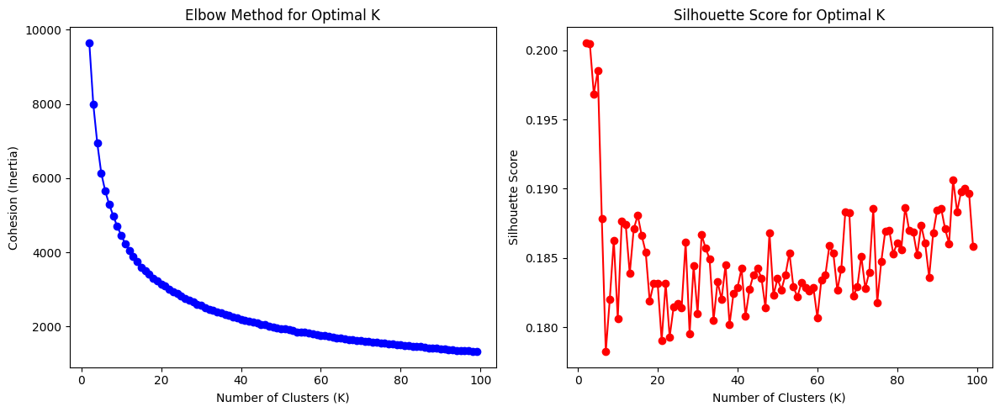

In [11]:
kmeans_list = clustering.plot_scores(real_cyclists_df)

Reverse centers

In [12]:
kmeans = kmeans_list[7]
centers = clustering.inverse_transform(kmeans.cluster_centers_, preprocessor_cyclists,
                                                      minmax_cols=minmax_cyclist,
                                                      standardize_cols=stand_cyclist,
                                                      categorical_cols=cat_cyclist)
#clustering.optimal_pair_plot(cyclists, 'KCluster', kmeans.labels_)

Plot optimal K

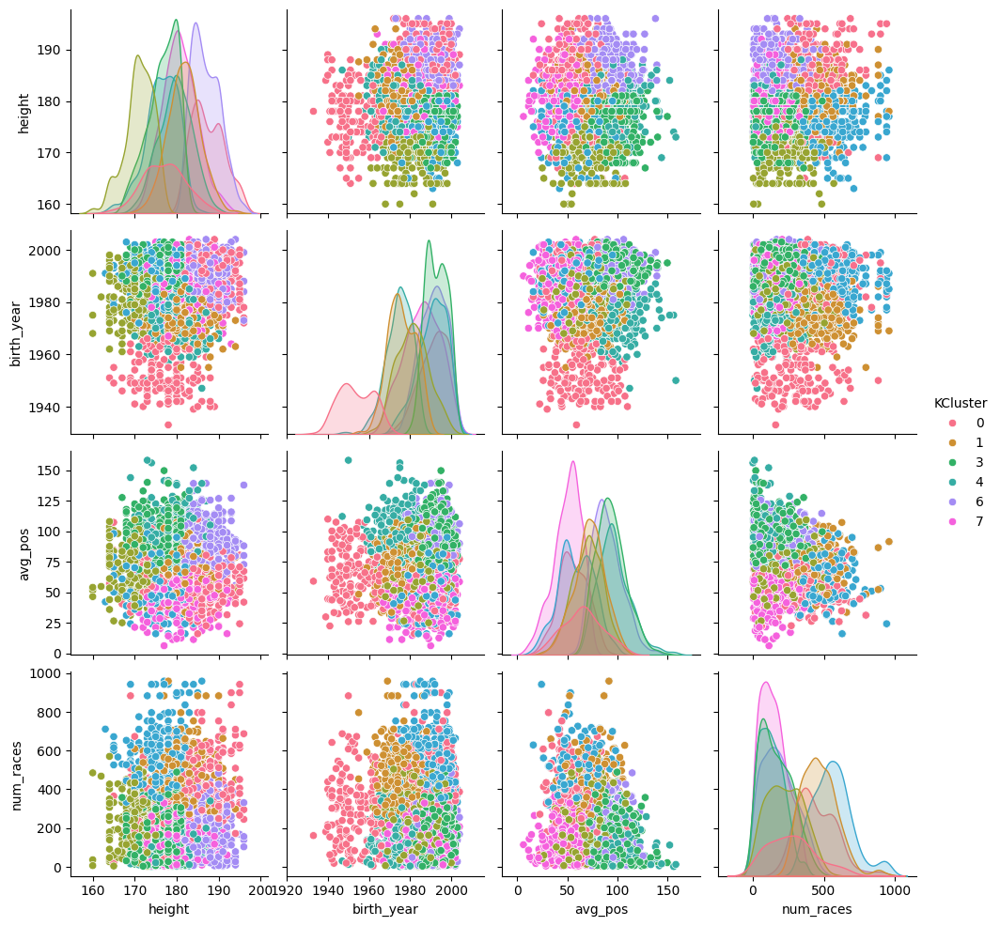

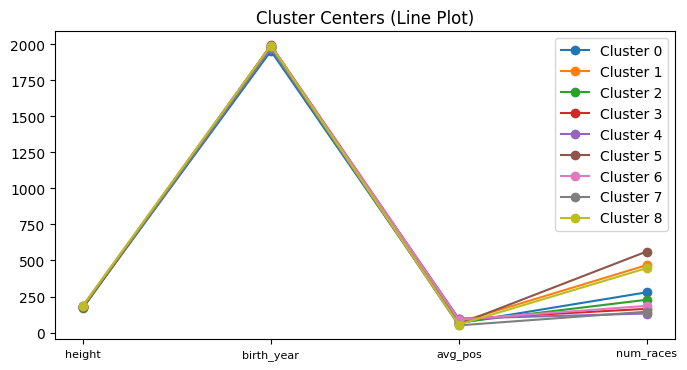

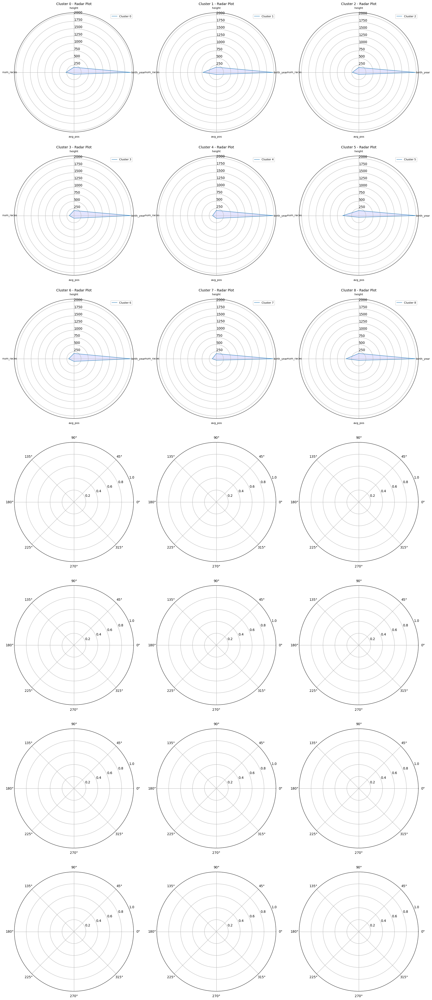

       height   birth_year    avg_pos   num_races
0  176.976190  1953.625000  65.498479  279.095238
1  181.686364  1975.886364  71.921937  467.698864
2  171.030960  1981.198142  69.950475  227.374613
3  176.689655  1992.618227  93.405107  164.692118
4  179.660423  1974.528701  96.512727  131.918429
5  176.386932  1990.636364  58.636903  562.125000
6  186.928866  1991.146907  89.597815  185.167526
7  180.738702  1985.778523  49.736650  144.617450
8  187.411765  1991.430147  55.508610  447.000000
height          5.236399
birth_year     12.614661
avg_pos        17.177584
num_races     160.910117
dtype: float64


In [13]:
clustering.optimal_pair_plot(cyclists, 'KCluster', kmeans.labels_)
clustering.plot_centers(cyclists, centers, 7, 3)
print(centers)
print(centers.std().sort_values())

Visualize the clusters

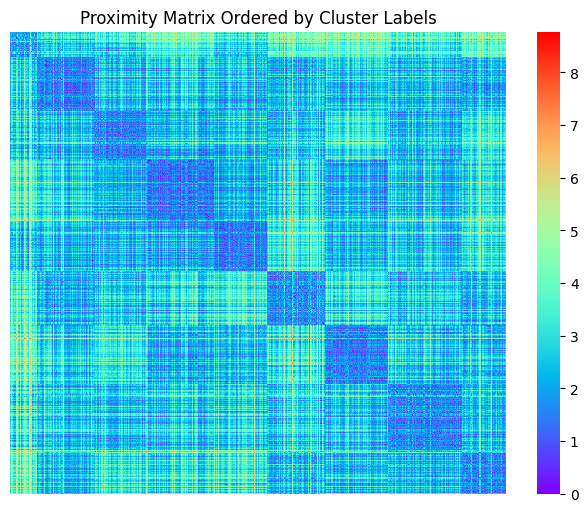

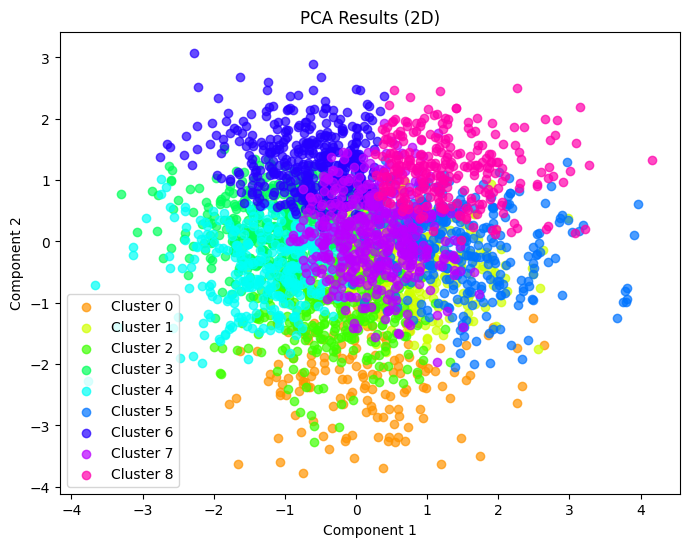

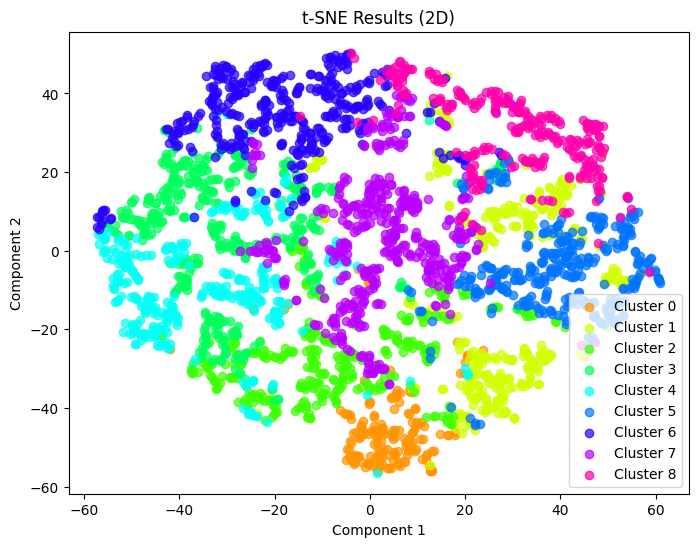

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


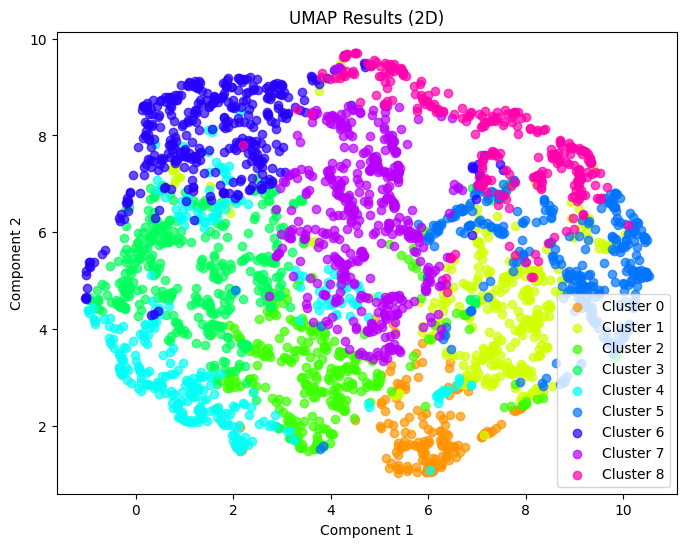

In [14]:
data_scaled = real_cyclists_df
labels = kmeans.labels_

clustering.similarity_matrix(real_cyclists_df, labels)

# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

### K-Means stages

NB: Same as for cyclists

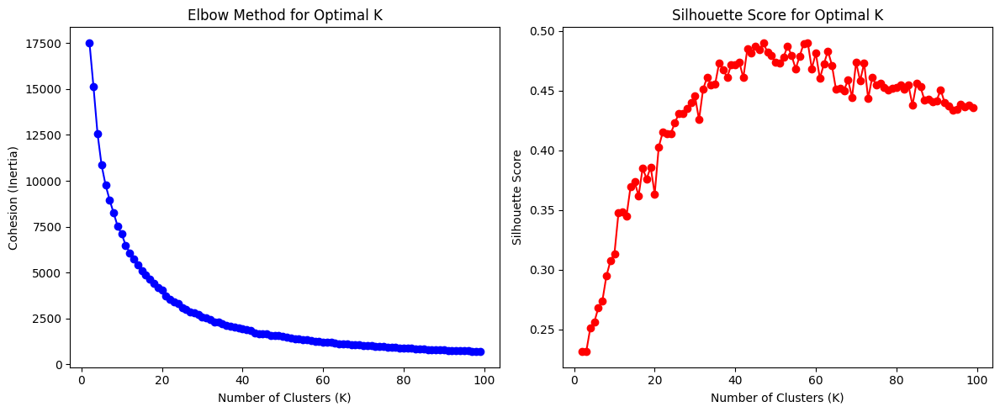

In [11]:
kmeans_list = clustering.plot_scores(real_stages_df)

Plots for optimal K

In [18]:
kmeans = kmeans_list[10]
centers = clustering.inverse_transform(kmeans.cluster_centers_, preprocessor_stages,
                                                      standardize_cols=stand_stage,
                                                      minmax_cols=minmax_stage,
                                                      categorical_cols=cat_stage)

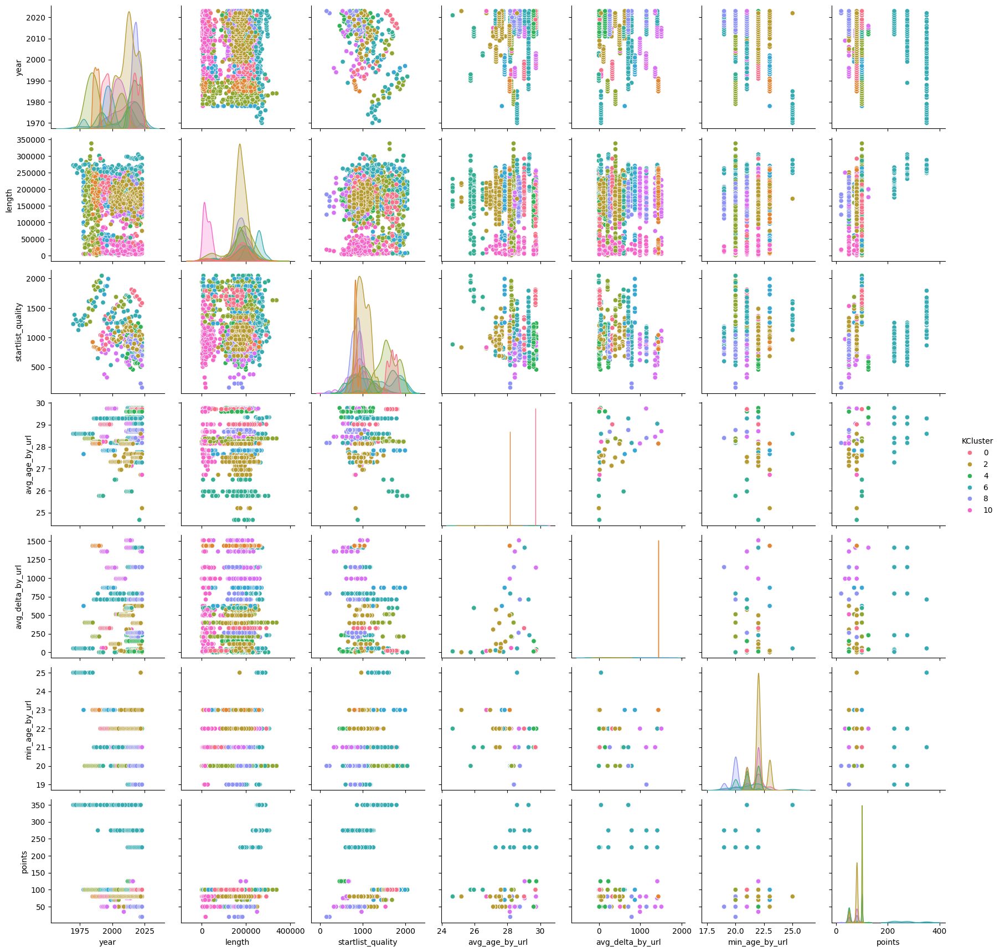

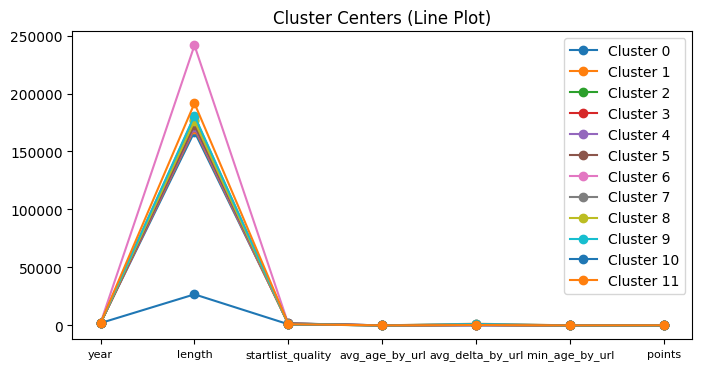

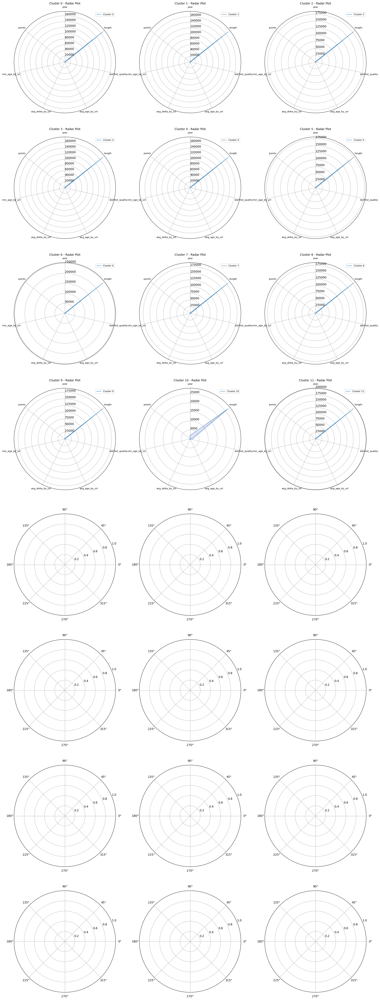

           year         length  startlist_quality  avg_age_by_url  \
0   2019.070513  167057.051282        1685.282051       29.708571   
1   1987.638462  169697.692308         843.523077       28.140940   
2   2012.303965  177048.017621        1007.406755       27.552679   
3   1992.382500  170971.375000        1599.910000       28.293318   
4   2017.538462  171143.076923         925.430769       29.644963   
5   2004.685897  172844.871795        1726.487179       25.845849   
6   2011.404372  241533.005464        1004.748634       28.801803   
7   1994.748503  180154.491018        1629.622754       27.809147   
8   2018.083056  176356.744186         829.534884       28.523298   
9   2005.605263  180907.142857         859.488722       28.633657   
10  2009.891667   26776.583333         976.150000       28.374848   
11  1994.760274  191600.684932        1014.732877       29.012231   

    avg_delta_by_url  min_age_by_url      points  
0          19.902857       21.000000  100.000000  


In [19]:
clustering.optimal_pair_plot(stages, 'KCluster', kmeans.labels_)
clustering.plot_centers(stages, centers, 8, 3)
print(centers)
print(centers.std().sort_values())

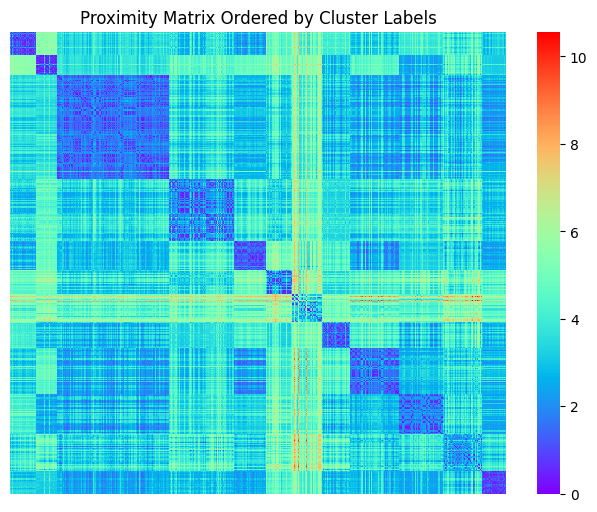

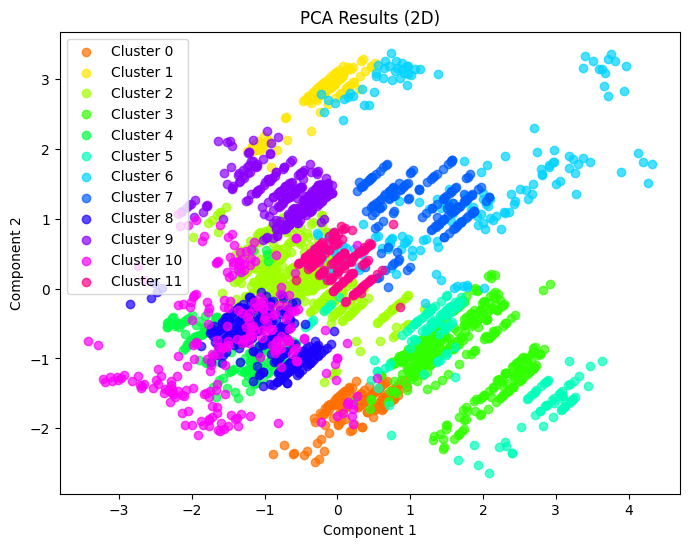

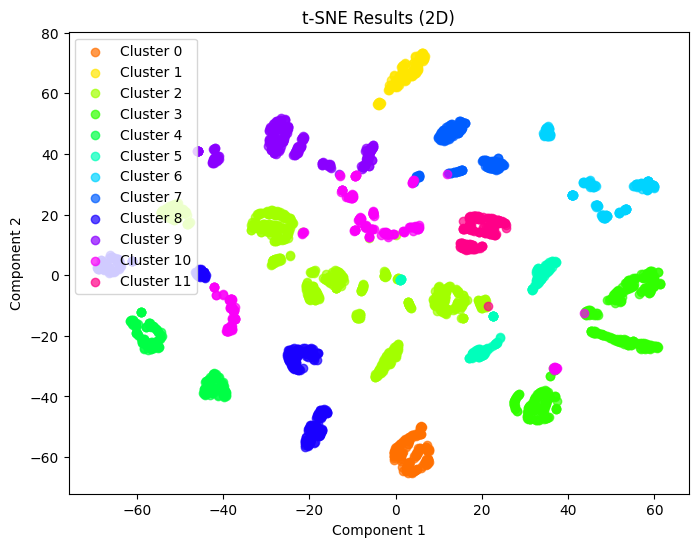

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


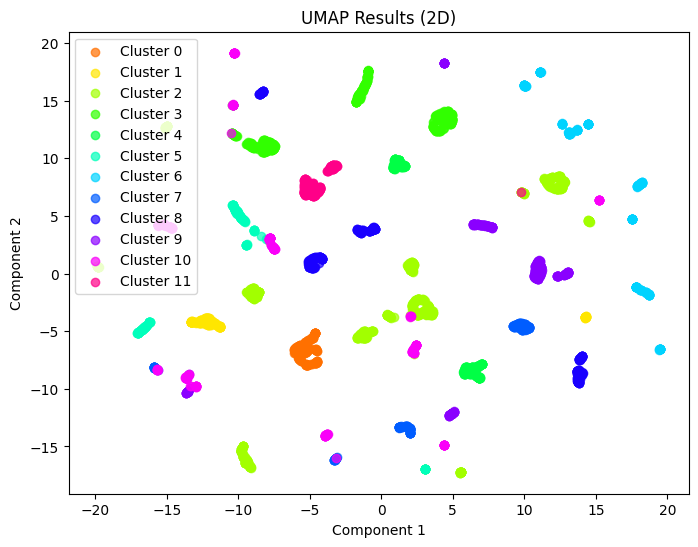

In [20]:
data_scaled = real_stages_df
labels = kmeans.labels_

clustering.similarity_matrix(real_stages_df, labels)

# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

### X-means cyclists

In [19]:
from sklearn.metrics import silhouette_score

labels, centroid = clustering.x_means(real_cyclists_df)

print(f"Silouette: {silhouette_score(real_cyclists_df, labels)}")

Done
Silouette: 0.20173142874222563


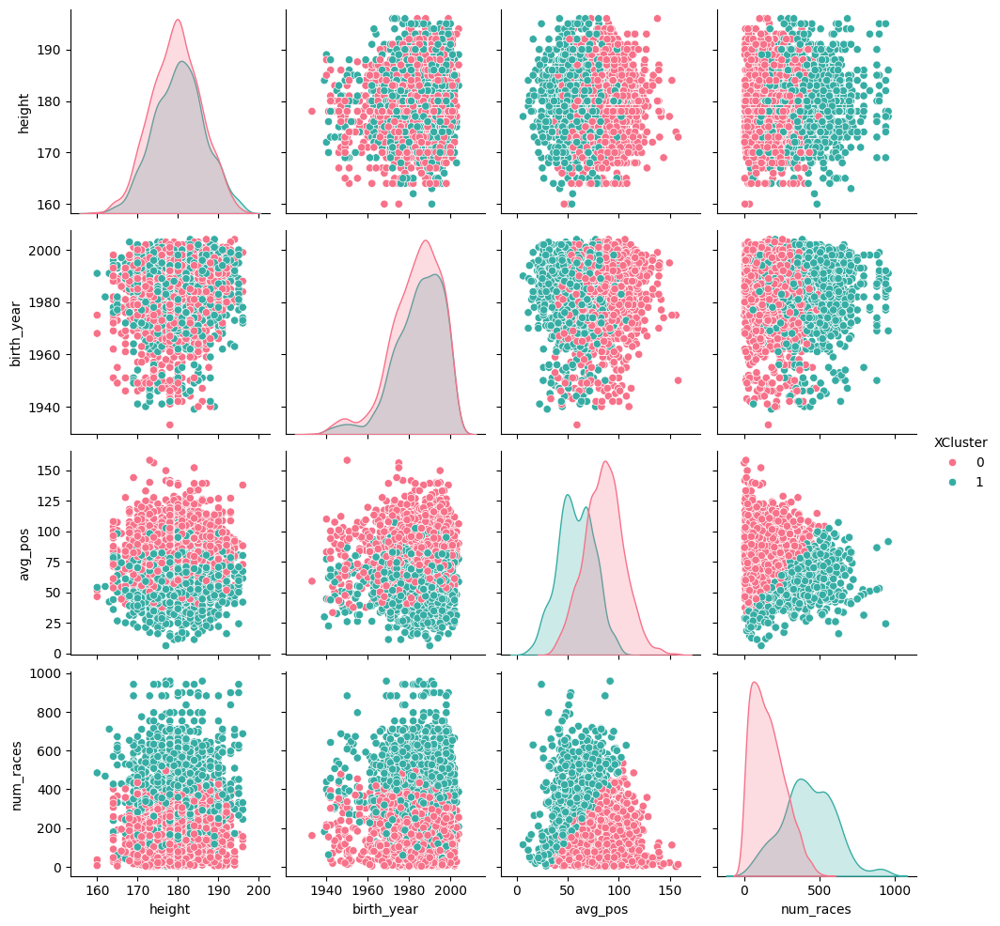

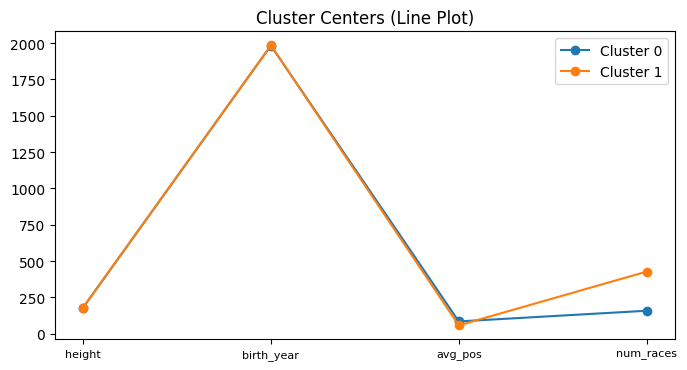

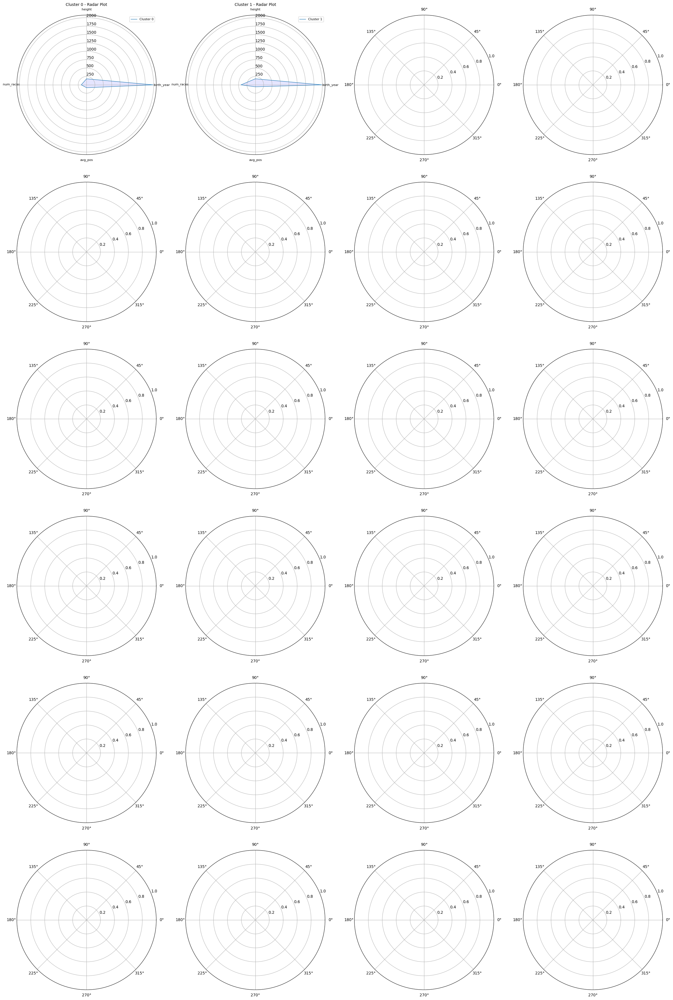

       height   birth_year    avg_pos   num_races
0  179.457794  1983.193046  85.130914  158.627098
1  180.291320  1984.562363  58.000626  428.038658
height          0.589392
birth_year      0.968254
avg_pos        19.184011
num_races     190.502741
dtype: float64


In [20]:
centers = clustering.inverse_transform(np.array(centroid), preprocessor_cyclists,
                                                      minmax_cols=minmax_cyclist,
                                                      standardize_cols=stand_cyclist,
                                                      categorical_cols=cat_cyclist)
clustering.optimal_pair_plot(cyclists, 'XCluster', labels)
clustering.plot_centers(cyclists, centers, 6, 4)
print(centers)
print(centers.std().sort_values())

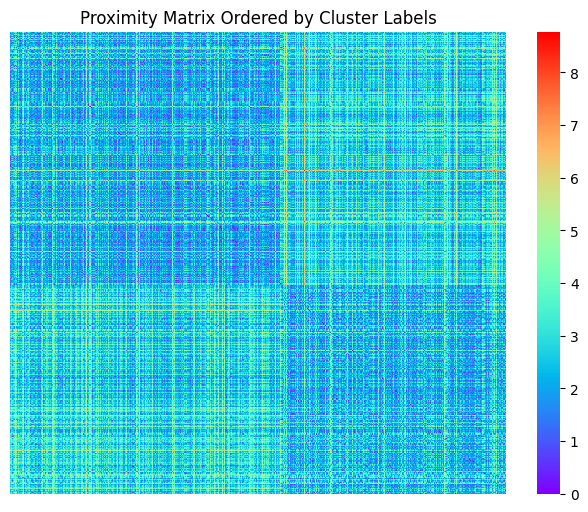

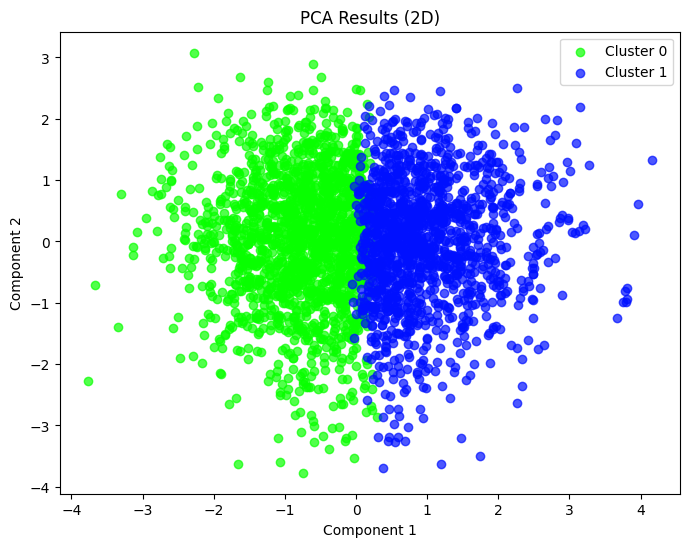

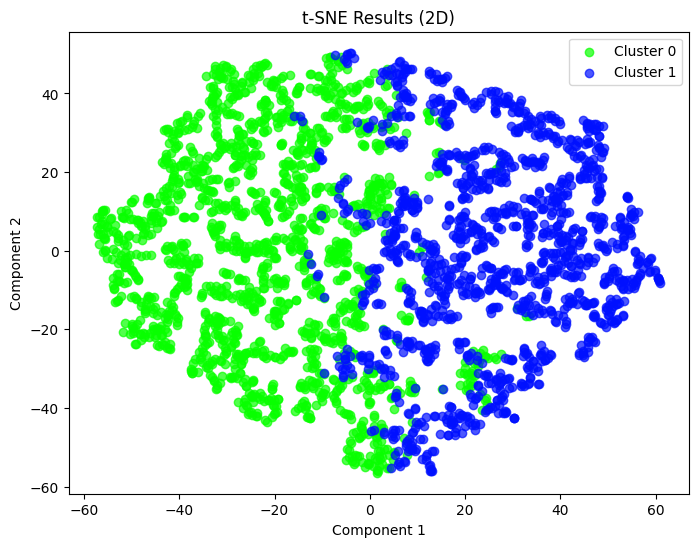

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


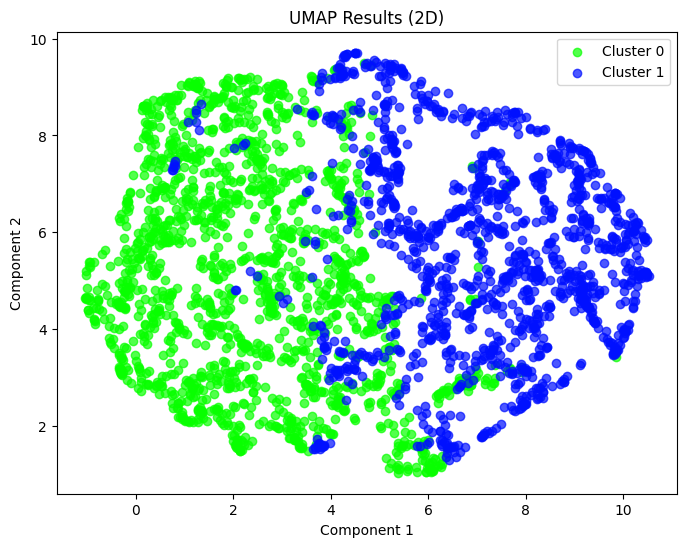

In [21]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

### X-means stages

In [22]:
labels, centroid = clustering.x_means(real_stages_df)

print(f"Silouette: {silhouette_score(real_stages_df, labels)}")

Done
Silouette: 0.38721739800851923


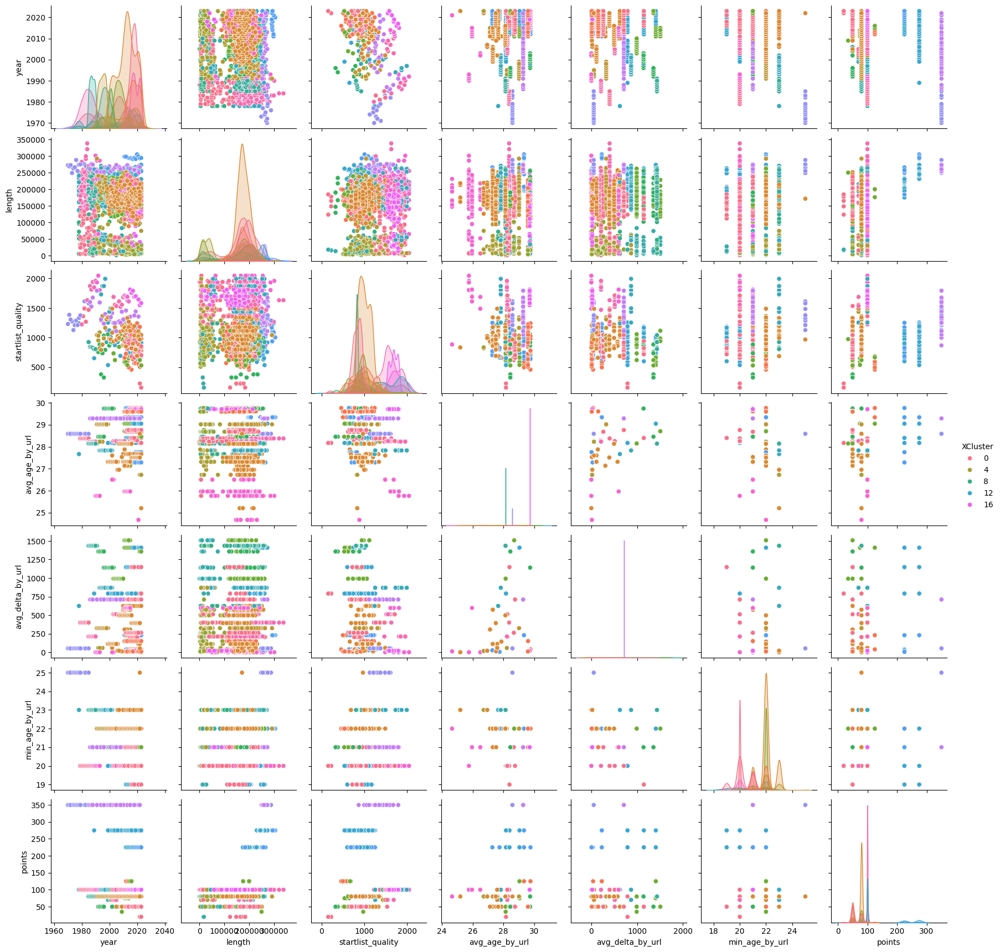

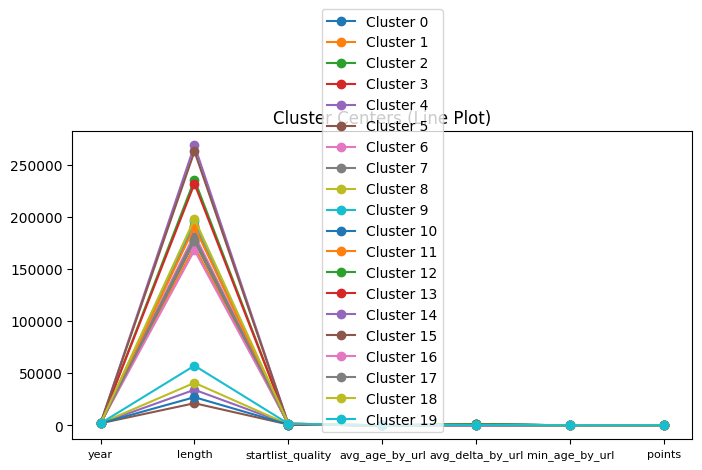

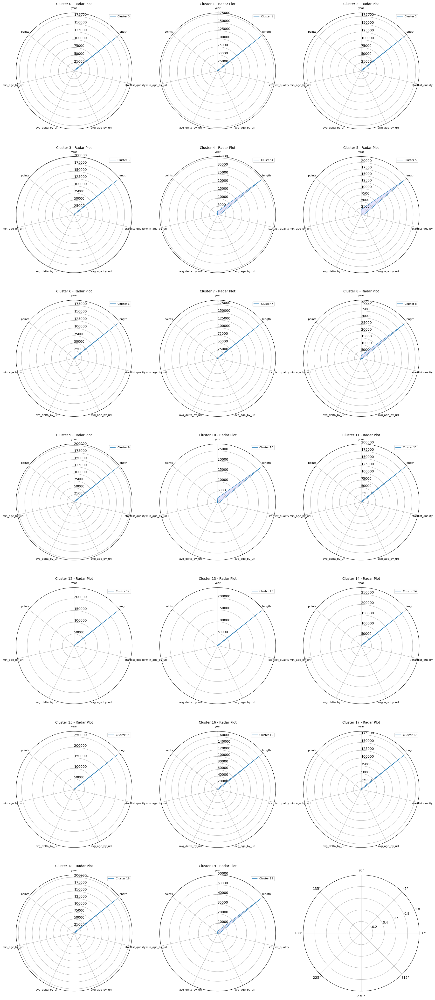

           year         length  startlist_quality  avg_age_by_url  \
0   2018.083612  176862.474916         829.541806       28.522250   
1   2017.520619  171547.422680         924.819588       29.645160   
2   2012.312684  177419.616519        1006.853982       27.553408   
3   1994.760274  191600.684932        1014.732877       29.012231   
4   2006.190476   34179.761905        1088.214286       27.874641   
5   2017.780822   21265.616438         855.178082       29.091932   
6   2008.535912  183234.806630         871.795580       28.282545   
7   1999.158537  180314.634146         829.219512       29.409165   
8   1985.888889   40833.333333         938.777778       28.034890   
9   1987.541284  195804.587156         841.807339       28.140940   
10  2008.043478   27044.347826         855.369565       28.585944   
11  1995.187097  190485.806452        1636.574194       27.812894   
12  2015.116279  235706.976744         900.500000       28.600229   
13  2018.226415  231871.698113    

In [23]:
centers = clustering.inverse_transform(np.array(centroid), preprocessor_stages,
                                                      standardize_cols=stand_stage,
                                                      minmax_cols=minmax_stage,
                                                      categorical_cols=cat_stage)
clustering.optimal_pair_plot(stages, 'XCluster', labels)
clustering.plot_centers(stages, centers, 7, 3)
print(centers)
print(centers.std().sort_values())

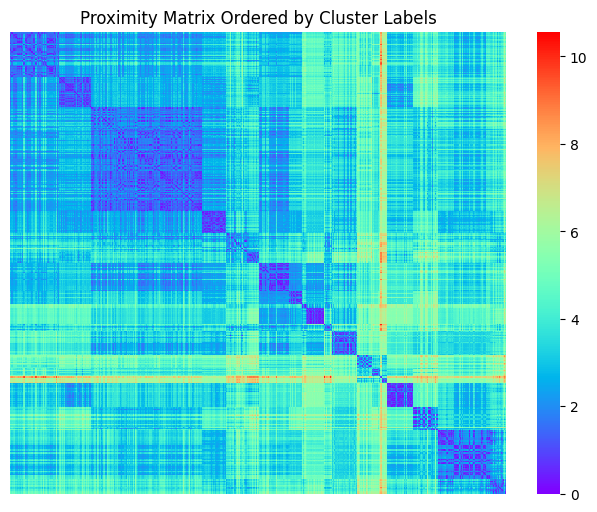

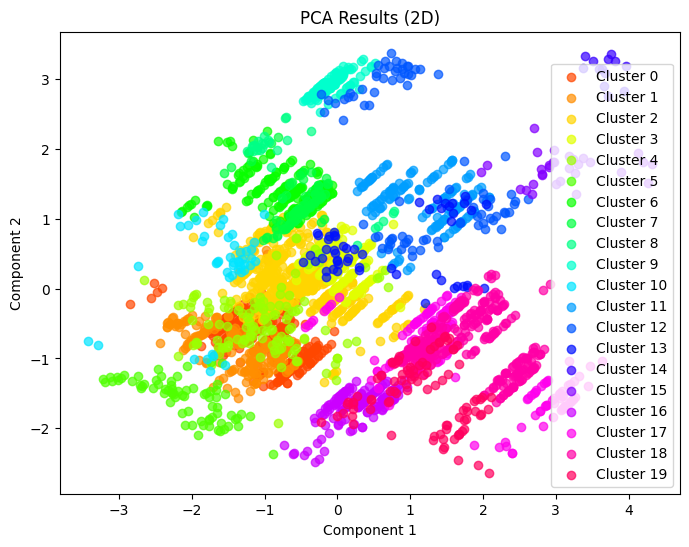

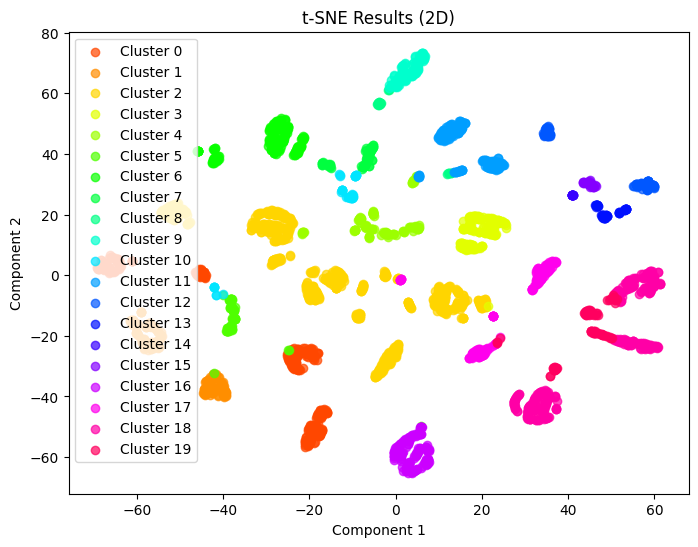

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


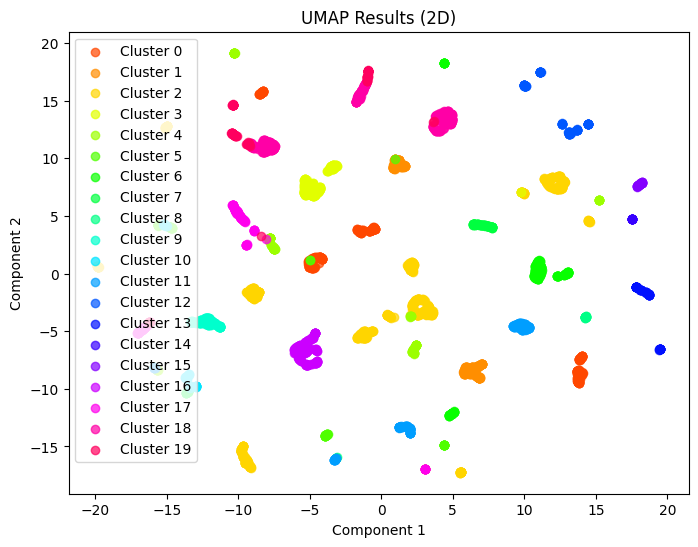

In [24]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

## Hierarchical 

Define linkage methods to try

In [25]:
# Let's use methods less susceptible to outliers and noise
# linkage_methods = ["single", "complete", "average", "ward", "centroid", "median"]
linkage_methods = ["average", "ward", "centroid"]

### Cyclists link

Compute distance matrices for cyclists

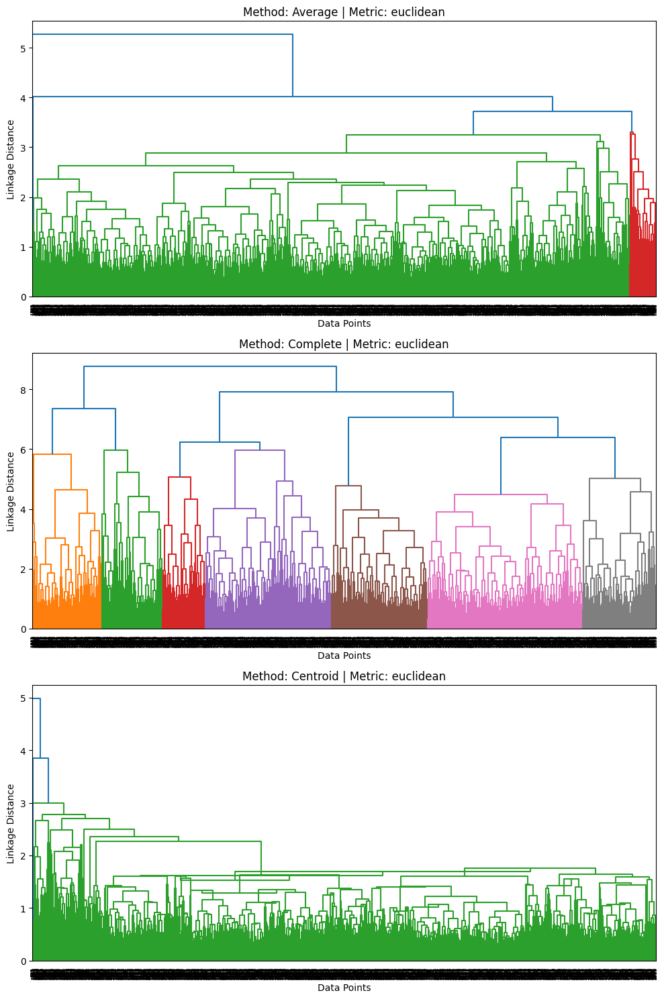

In [26]:
dst_matrix_euclid_cyclists = clustering.compute_distance_matrix(real_cyclists_df,"euclidean")
euclid_link = clustering.compute_hc(dst_matrix_euclid_cyclists, methods=['average', 'complete', 'centroid'])
clustering.plot_all_hc(euclid_link, "euclidean")

Here the number of clusters is not perfectly clear, but the maximum distance is enough clear and we can see that the number of clusters is between 2 3 or 4

### Stages links

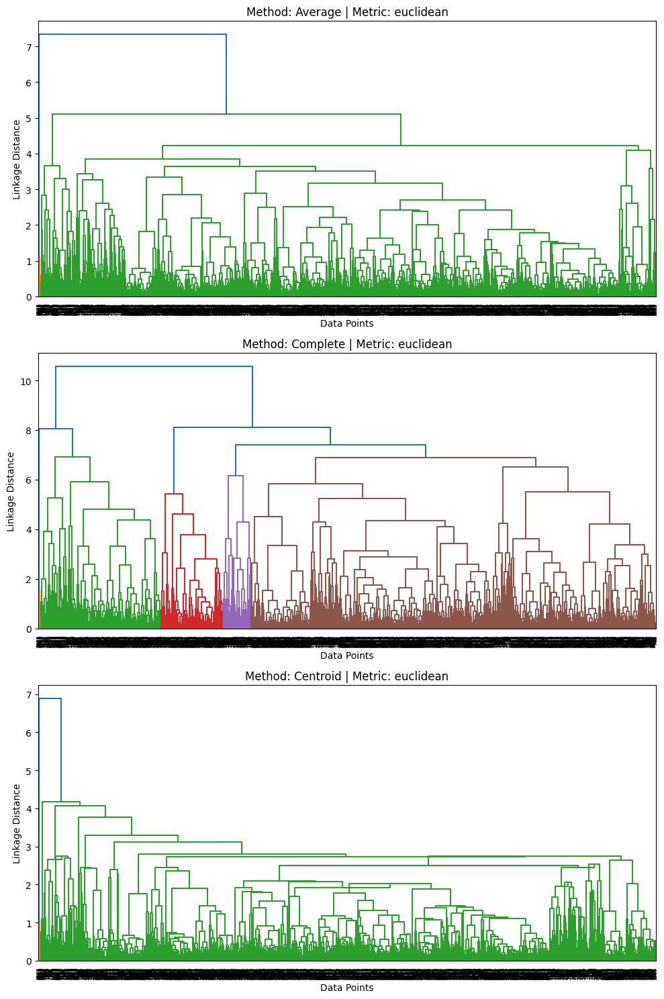

In [27]:
dst_matrix_euclid_stages = clustering.compute_distance_matrix(real_stages_df, "euclidean")
euclid_link = clustering.compute_hc(dst_matrix_euclid_stages, methods=['average', 'complete', 'centroid'])
clustering.plot_all_hc(euclid_link, "euclidean")

2 is where there is the maximum distance. so clusters are 2

### Spectral method

According to spectral method. No clusters are found

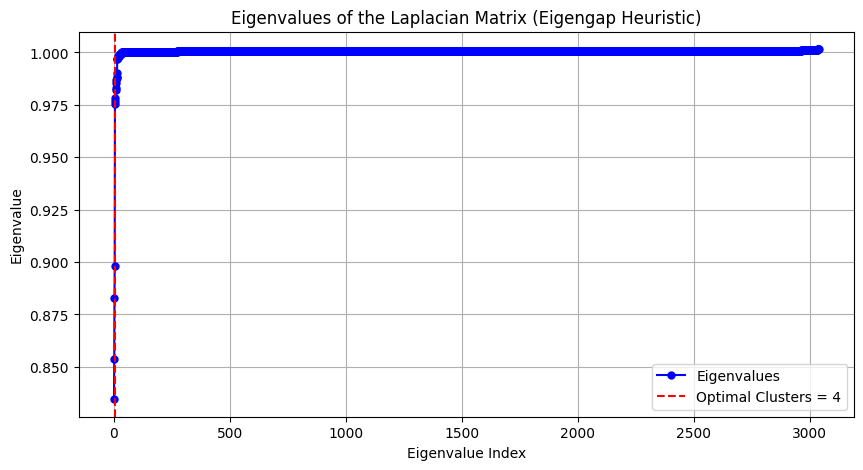

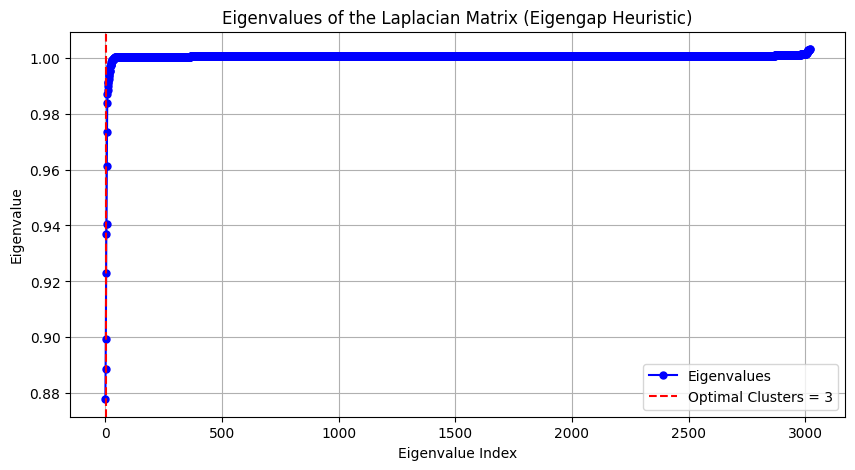

In [28]:
import libraries.clustering as clustering
clustering.spectral_eigen_gap(real_cyclists_df.values)
clustering.spectral_eigen_gap(real_stages_df.values)

### Cyclists agglomerative

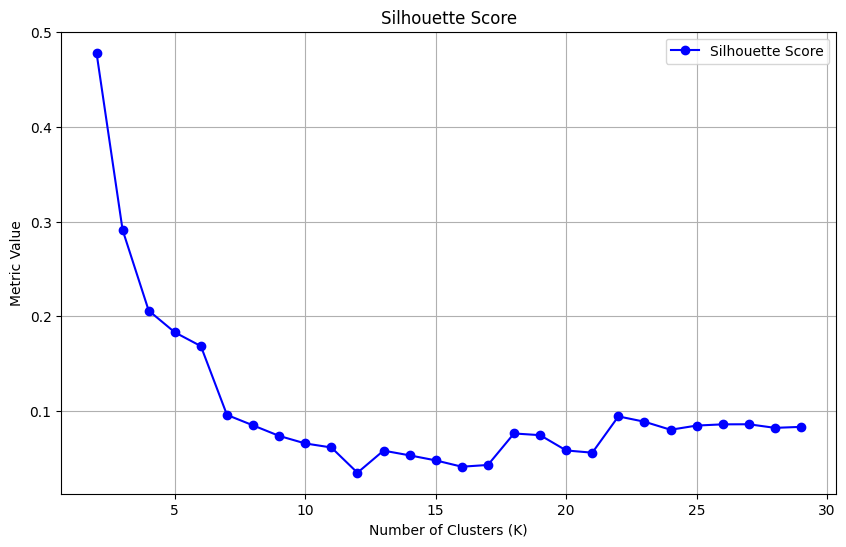

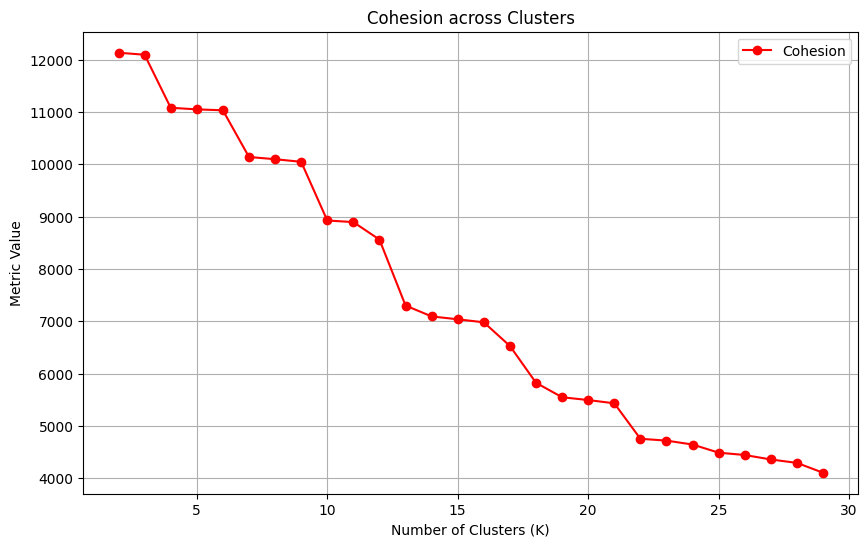

In [29]:
from sklearn.cluster import AgglomerativeClustering

agglr_labels_cyclists = []
for num_clusters in range(2, 30):
    agg_clustering = AgglomerativeClustering(n_clusters=num_clusters, linkage='average')
    agglr_labels_cyclists.append(agg_clustering.fit_predict(real_cyclists_df))

sil1,coh1 = sil_vs_coh(real_cyclists_df, agglr_labels_cyclists, list(range(2,30)))

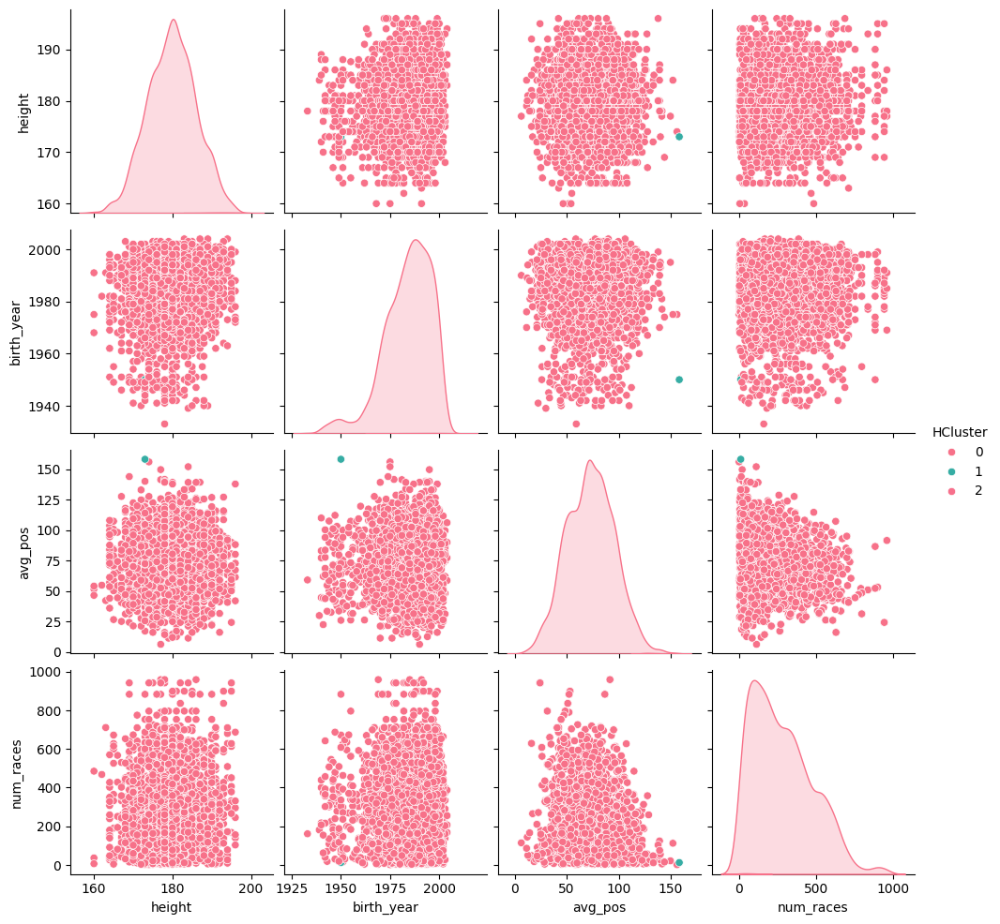

In [30]:
agg_clustering = AgglomerativeClustering(n_clusters=3, linkage='average')
labels = agg_clustering.fit_predict(real_cyclists_df)
clustering.optimal_pair_plot(cyclists, 'HCluster', labels)

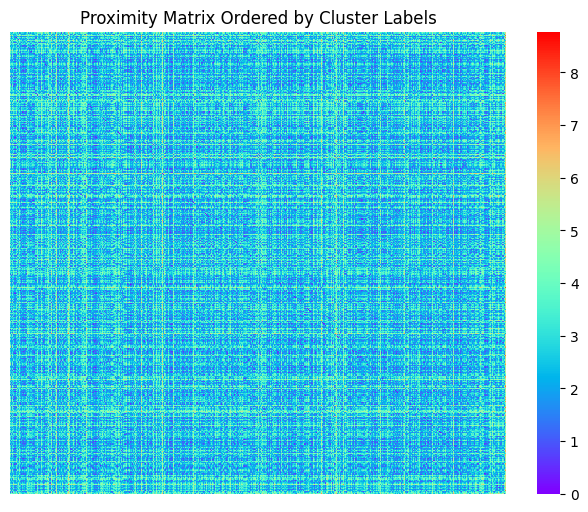

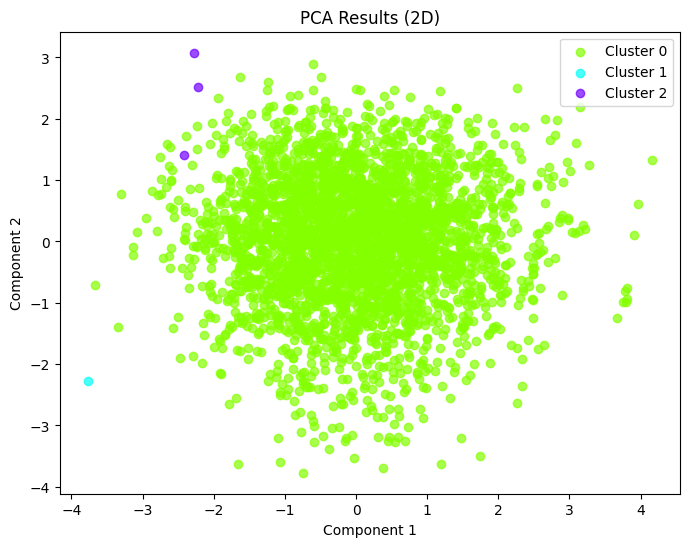

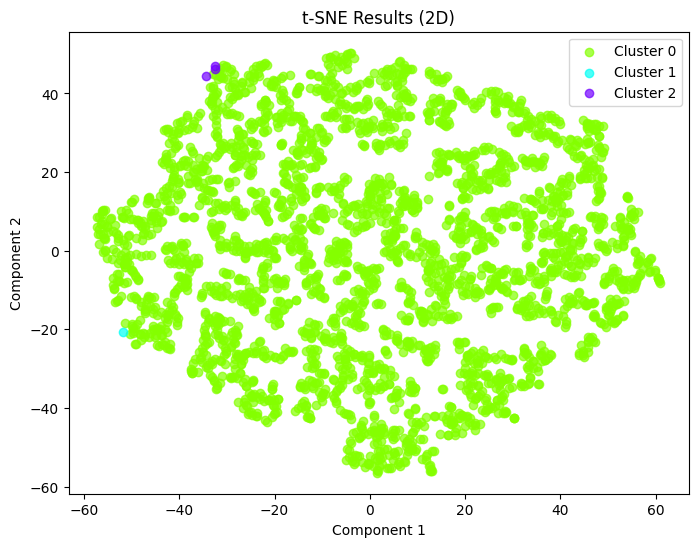

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


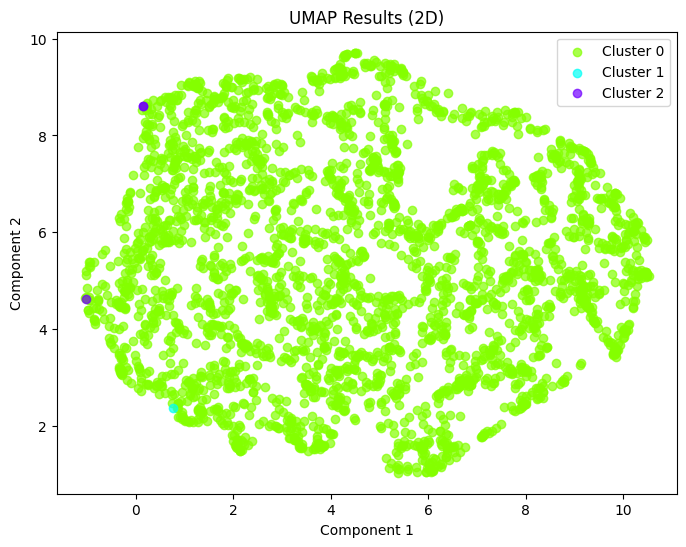

In [31]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

### Stages agglomerative

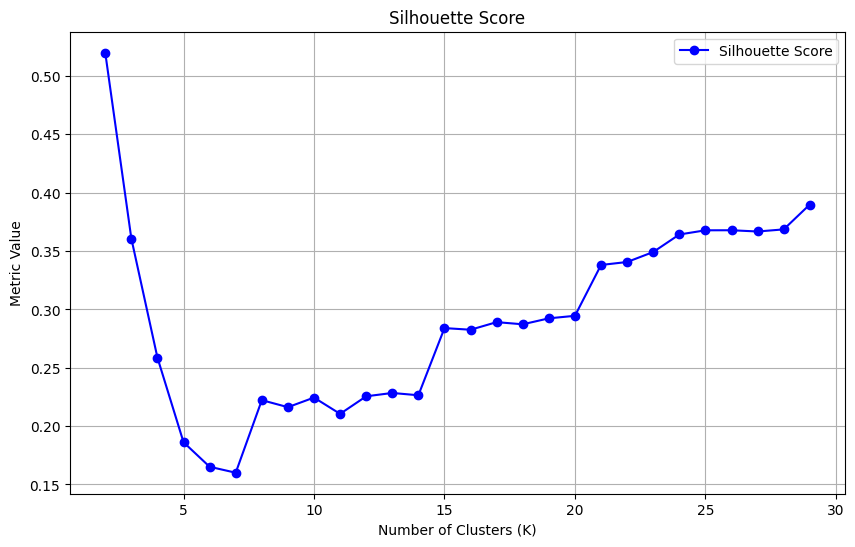

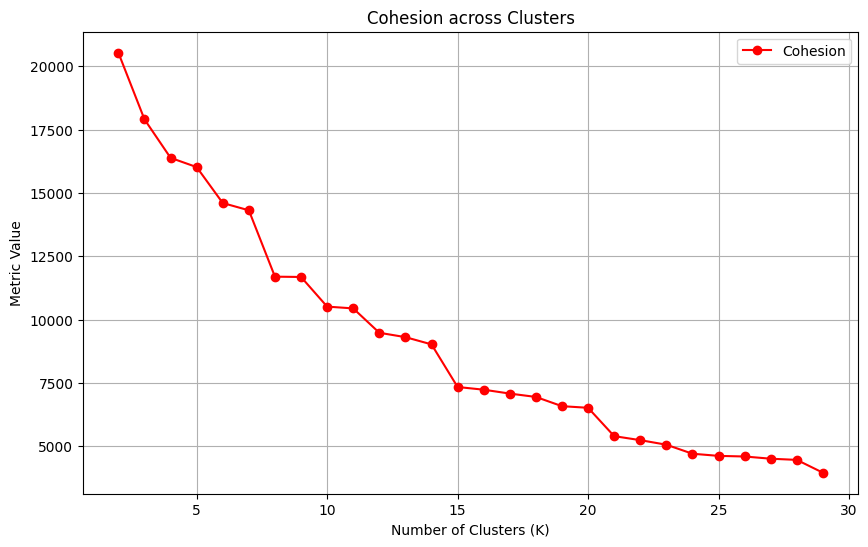

In [32]:
from sklearn.cluster import AgglomerativeClustering

agglr_labels_stages = []
for num_clusters in range(2, 30):
    agg_clustering = AgglomerativeClustering(n_clusters=num_clusters, linkage='average')
    agglr_labels_stages.append(agg_clustering.fit_predict(real_stages_df))

sil1,coh1 = sil_vs_coh(real_stages_df, agglr_labels_stages, list(range(2,30)))

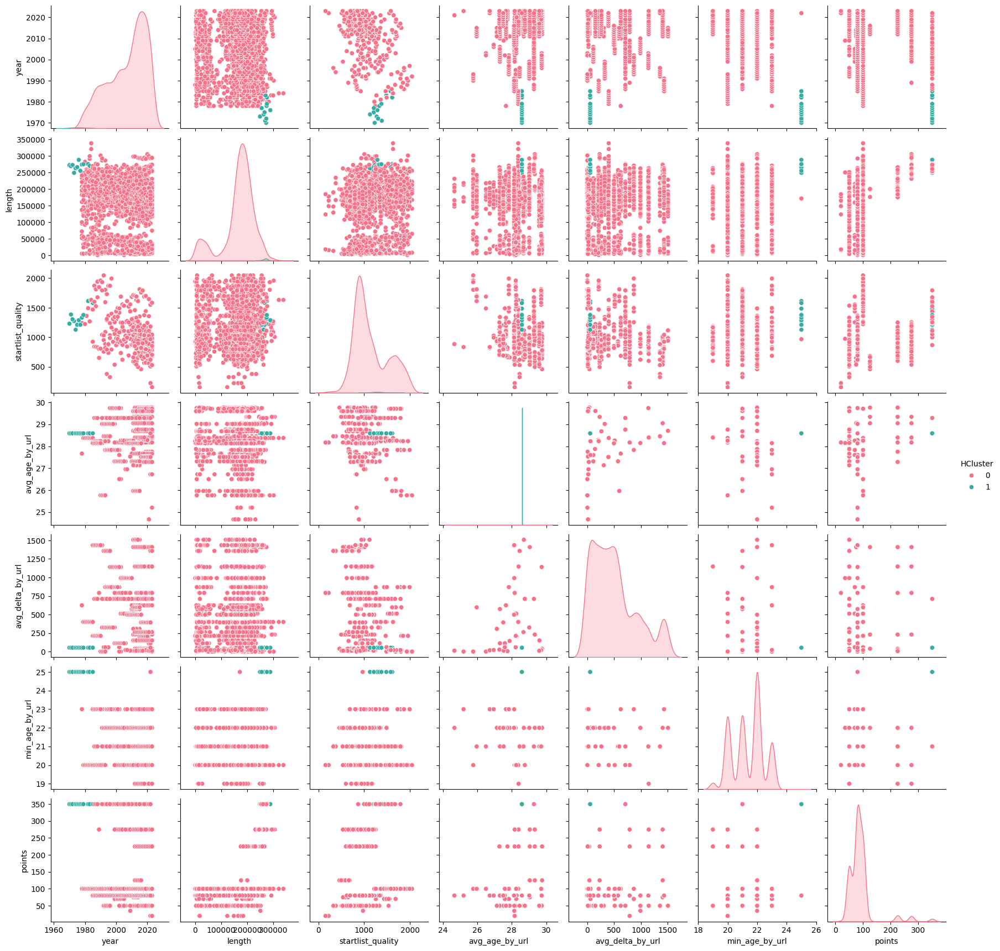

In [33]:
agg_clustering = AgglomerativeClustering(n_clusters=2, linkage='average')
labels = agg_clustering.fit_predict(real_stages_df)
clustering.optimal_pair_plot(stages, 'HCluster', labels)

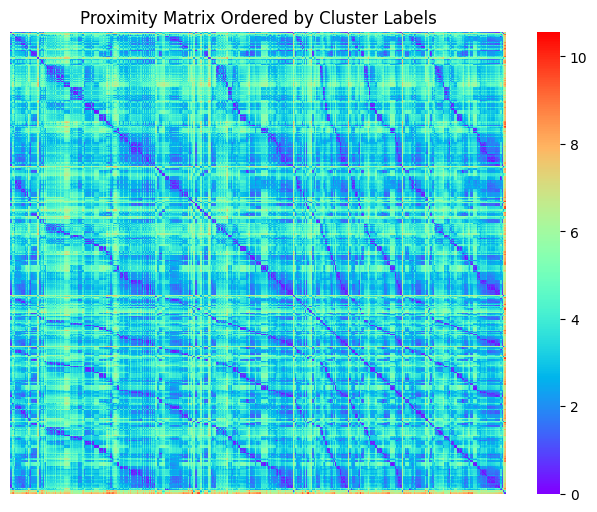

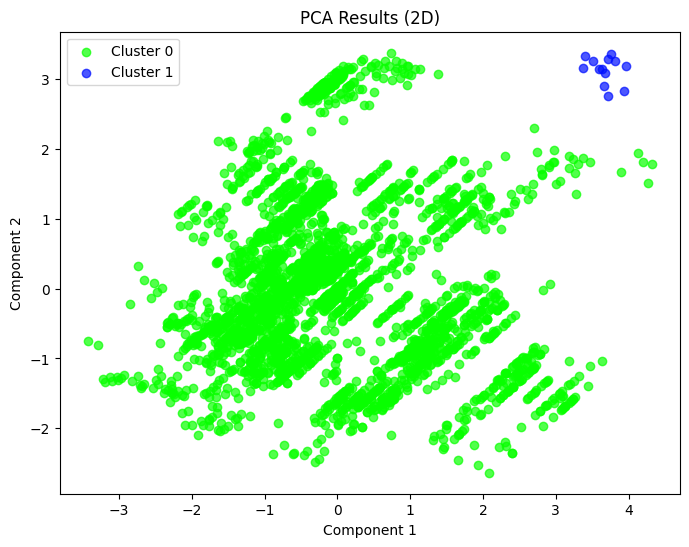

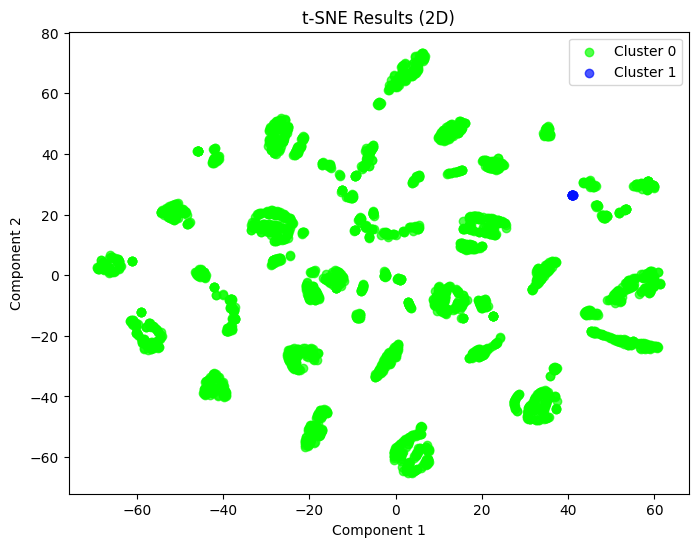

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


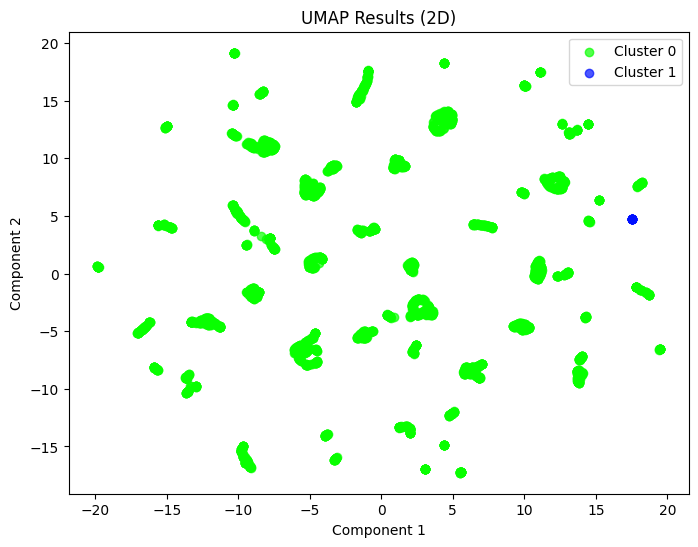

In [34]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

### Cyclists spectral

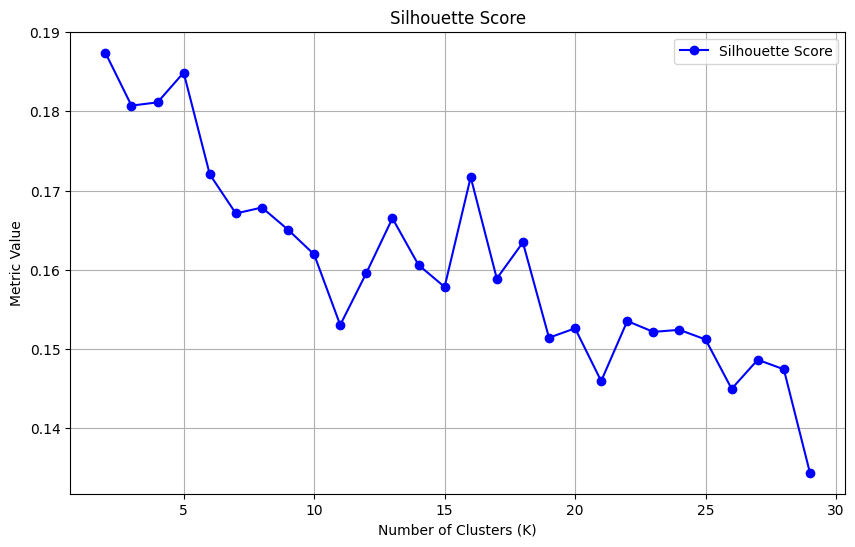

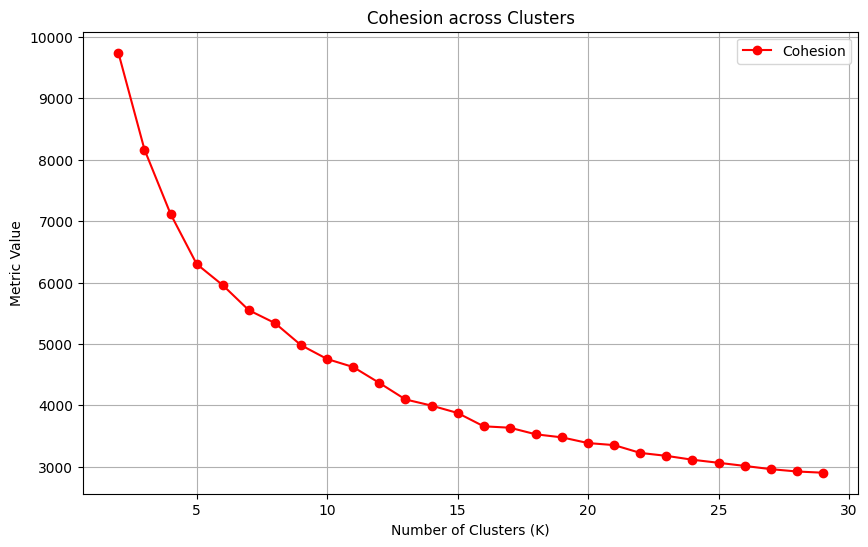

In [35]:
spect_labels_cyclists = []
for n_clusters in range(2, 30):
    spectral = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', random_state=1804)
    spect_labels_cyclists.append(spectral.fit_predict(real_cyclists_df))

sil3,coh3 = sil_vs_coh(real_cyclists_df, spect_labels_cyclists, list(range(2,30)))

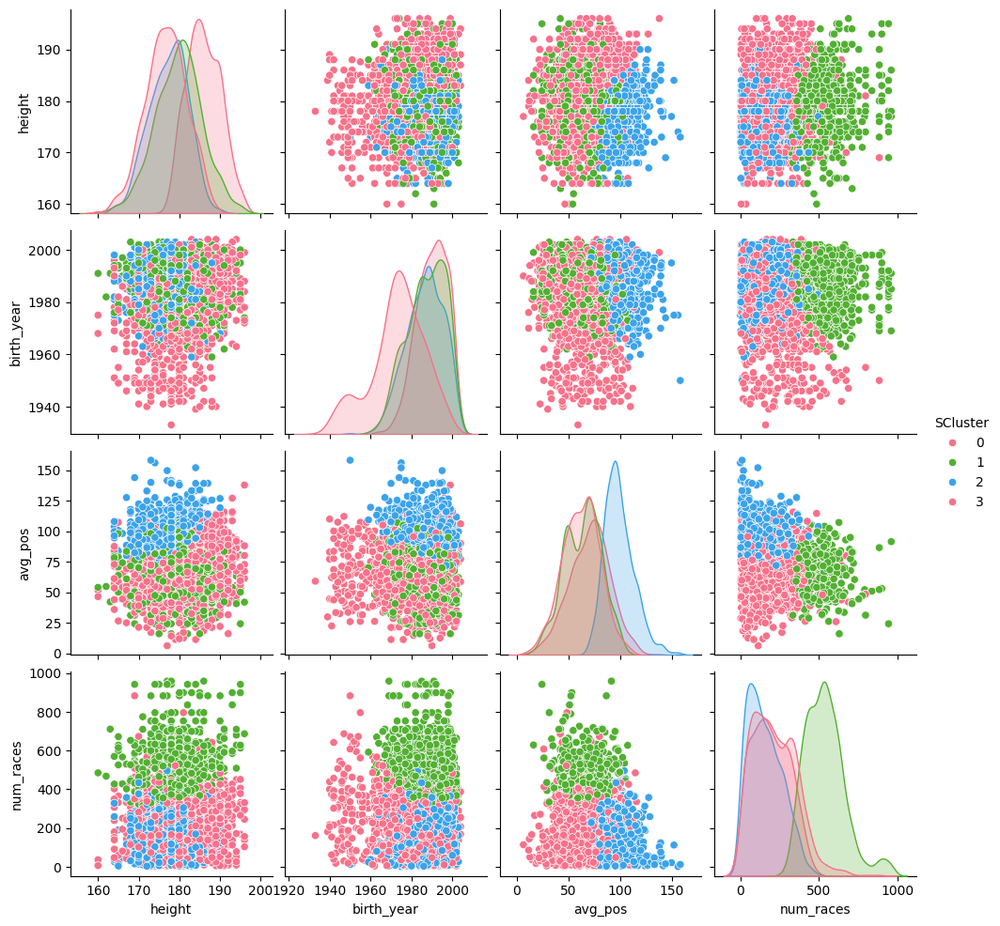

In [36]:
spect_clustering = SpectralClustering(n_clusters=4, affinity='nearest_neighbors', random_state=1804)
labels = spect_clustering.fit_predict(real_cyclists_df)
clustering.optimal_pair_plot(cyclists, 'SCluster', labels)

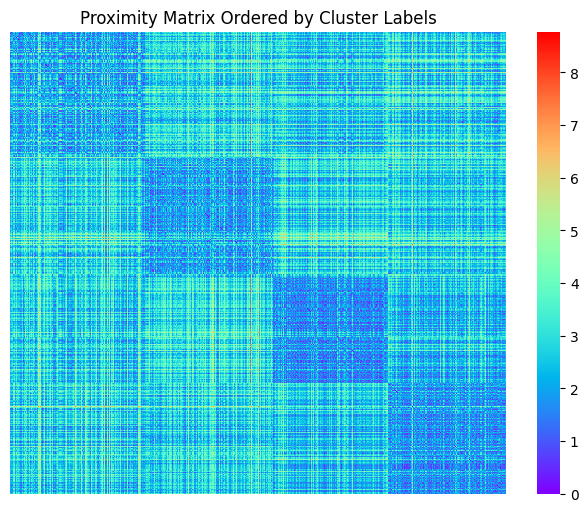

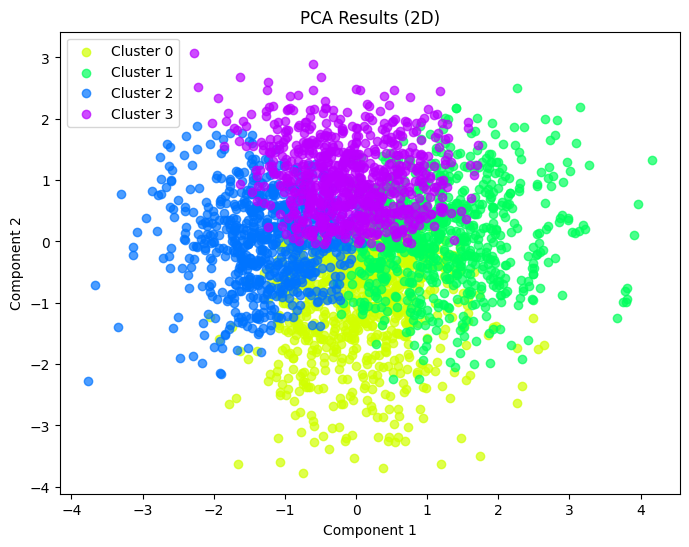

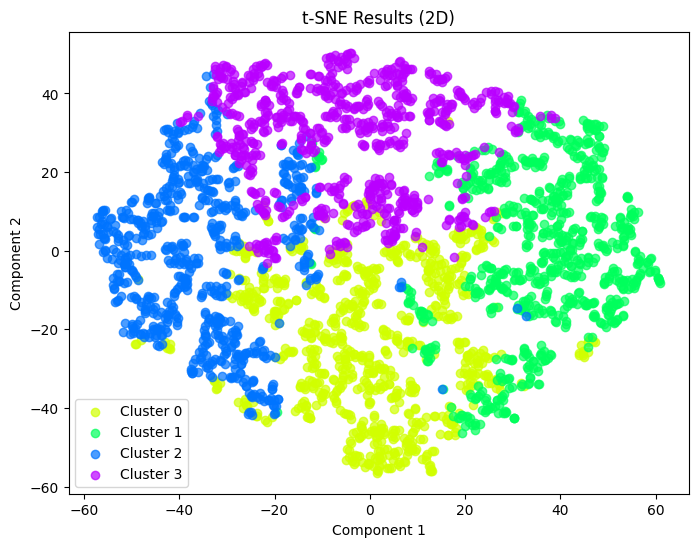

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


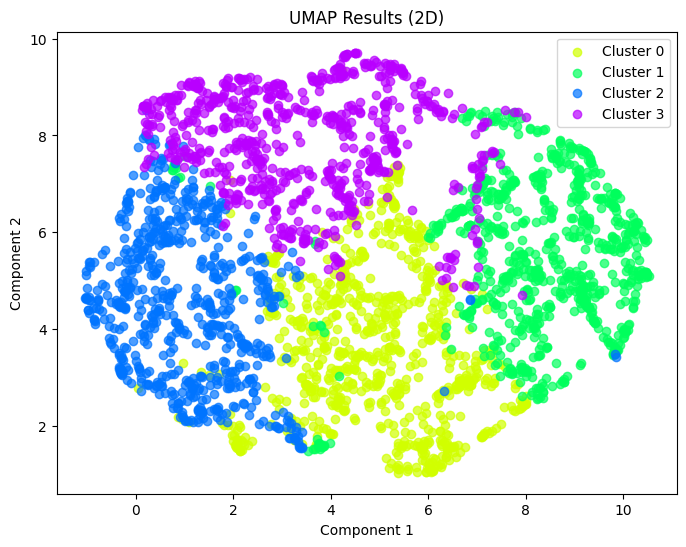

In [37]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

### Stages spectral

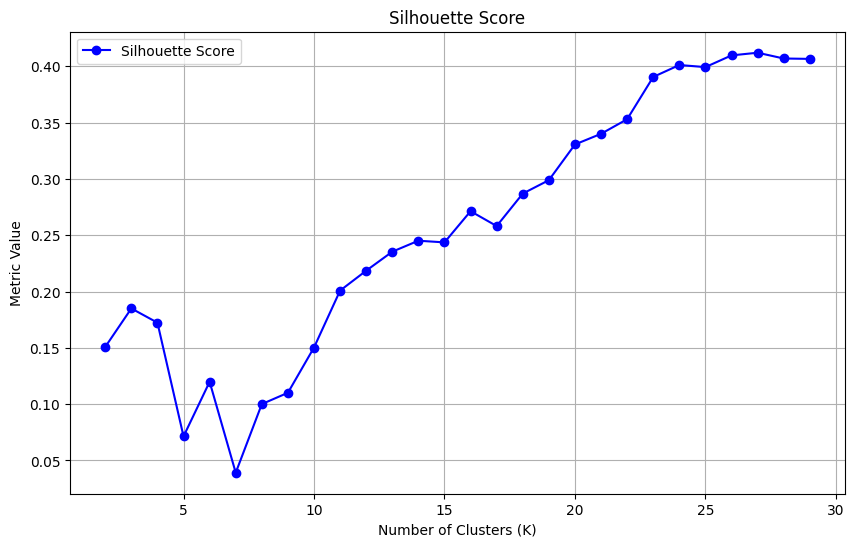

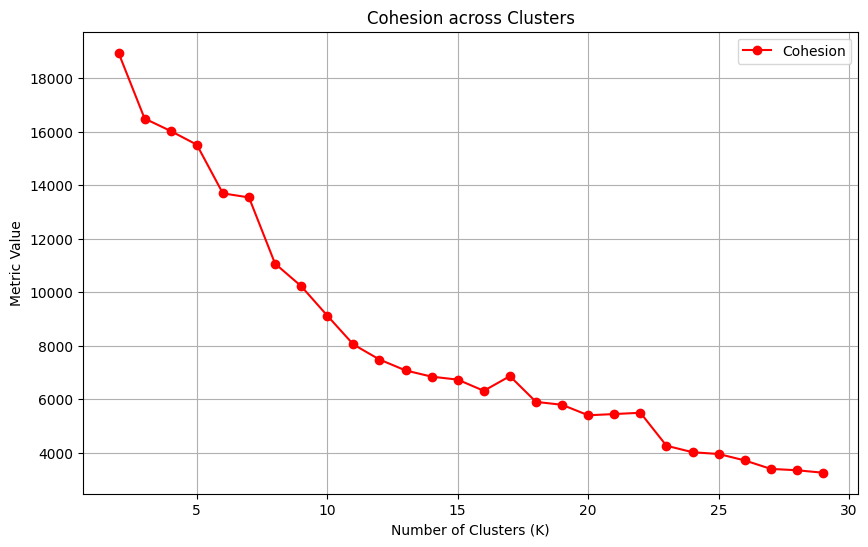

In [38]:
from sklearn.cluster import SpectralClustering

spect_labels_stages = []
for n_clusters in range(2, 30):
    spectral = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', n_neighbors=50, random_state=1804)
    spect_labels_stages.append(spectral.fit_predict(real_stages_df))

sil4,coh4 = sil_vs_coh(real_stages_df, spect_labels_stages, list(range(2,30)))

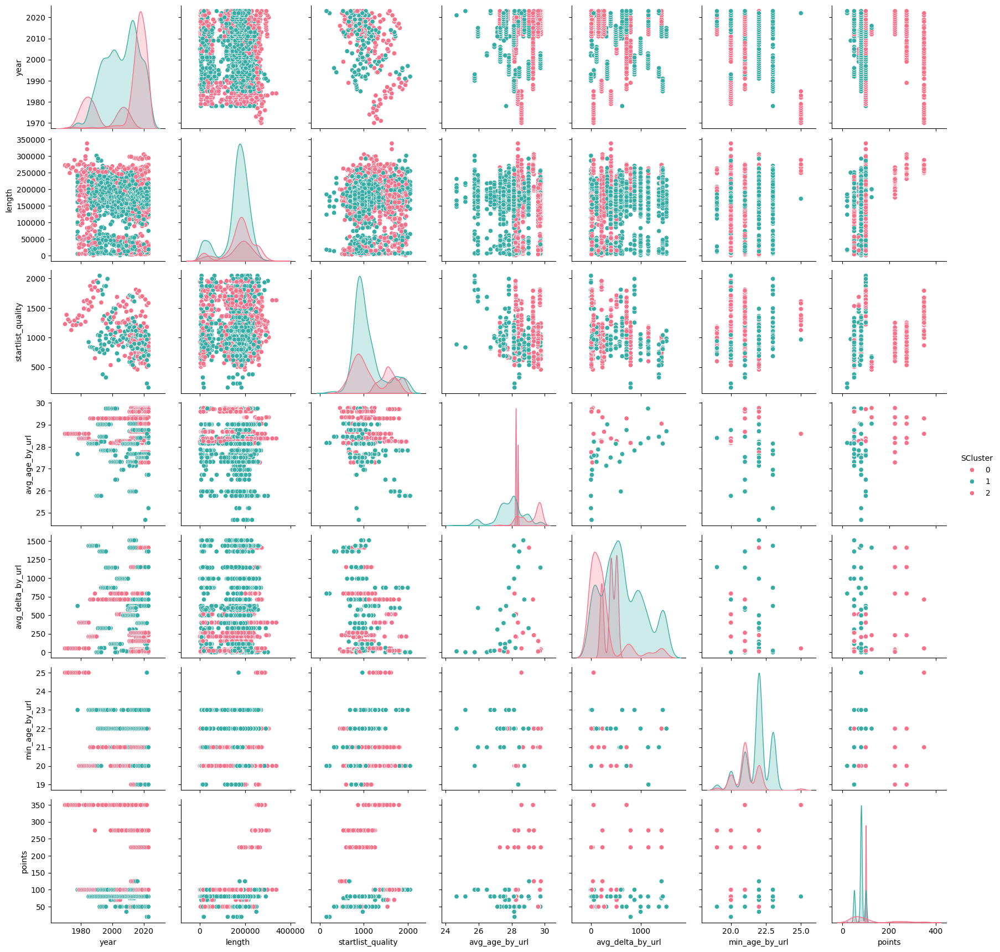

In [39]:
spect_clustering = SpectralClustering(n_clusters=3, affinity='nearest_neighbors', n_neighbors=50, random_state=1804)
labels = spect_clustering.fit_predict(real_stages_df)
clustering.optimal_pair_plot(stages, 'SCluster', labels)

Note: Spectral clustering detects isolated points for stages with KNN

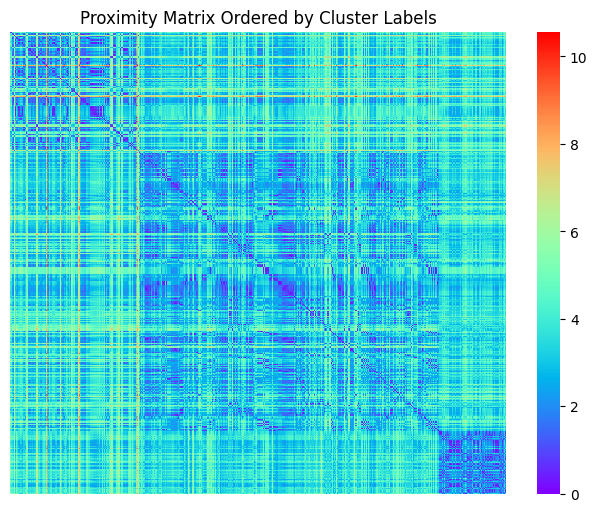

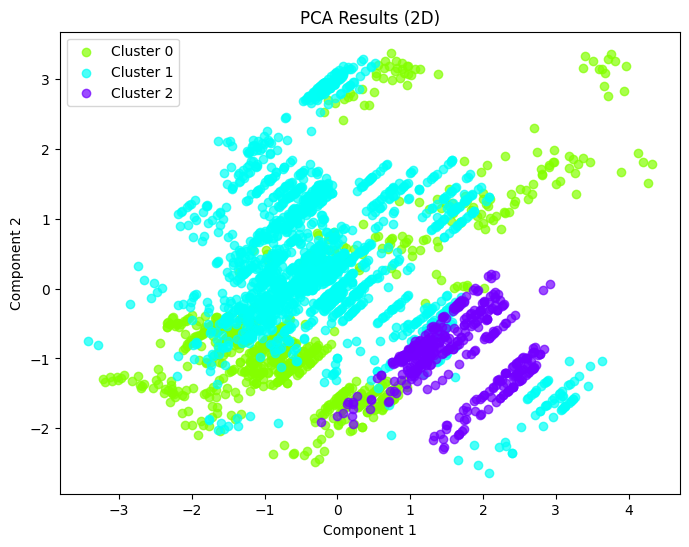

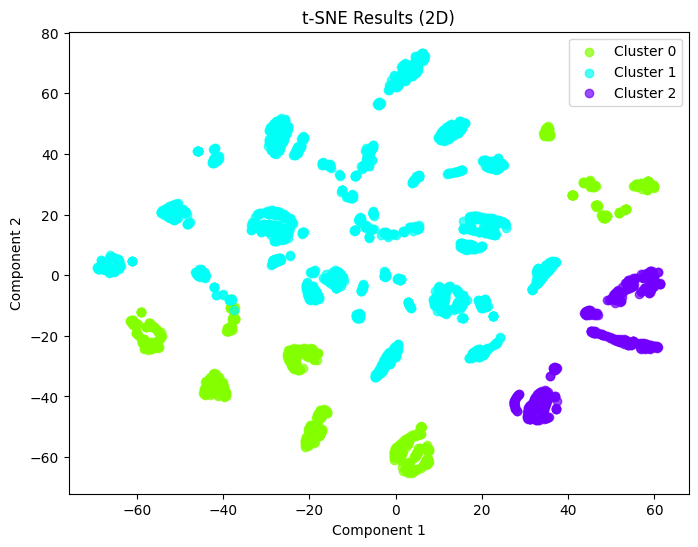

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


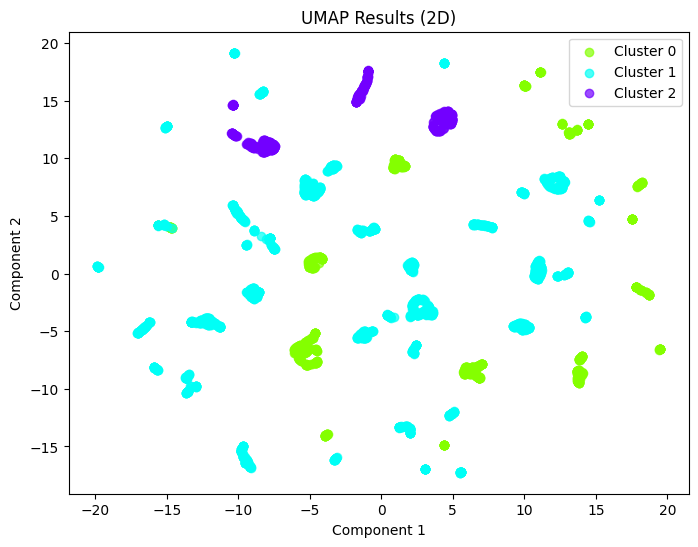

In [40]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels, title="PCA Results (2D)", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels, title="t-SNE Results (2D)", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels, title="UMAP Results (2D)", dimensions=2)

## DBscan

### Cyclists

In [12]:
dst_matrix_euclid_cyclists = clustering.compute_distance_matrix(real_cyclists_df,"euclidean")
dst_matrix_euclid_cyclists = squareform(dst_matrix_euclid_cyclists)
ks = [2*real_cyclists_df.shape[1], pow(2,real_cyclists_df.shape[1])]

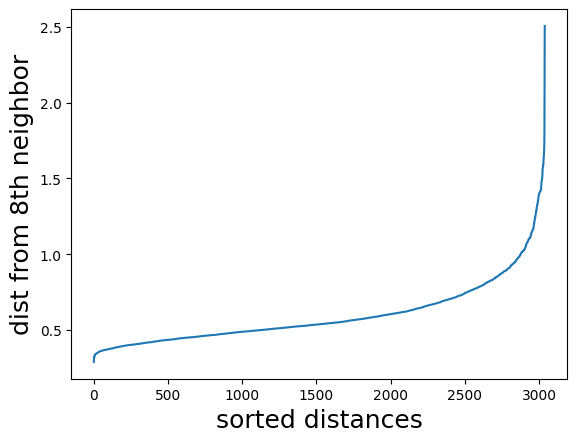

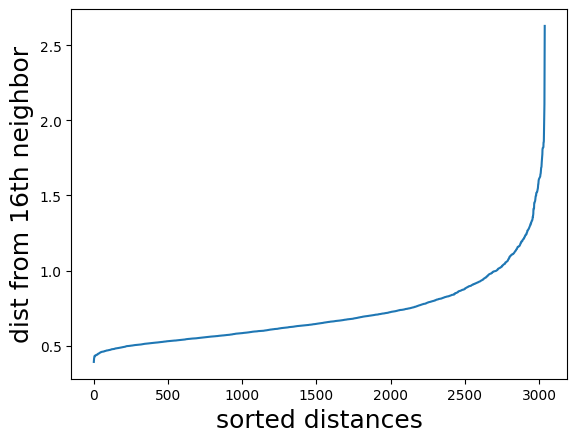

In [12]:
for dist, k in zip([dst_matrix_euclid_cyclists, dst_matrix_euclid_cyclists], ks):
    kth_distances = list()
    for d in dist:
        index_kth_distance = np.argsort(d)[k]
        kth_distances.append(d[index_kth_distance])

    plt.plot(range(0, len(kth_distances)), sorted(kth_distances))
    plt.ylabel("dist from %sth neighbor" % k, fontsize=18)
    plt.xlabel("sorted distances", fontsize=18)
    plt.show()

     eps  Clusters   Noise
0   0.50      10.0  1038.0
1   0.51       8.0   939.0
2   0.52       5.0   871.0
3   0.53       3.0   800.0
4   0.54       1.0   757.0
5   0.55       1.0   712.0
6   0.56       2.0   641.0
7   0.57       2.0   603.0
8   0.58       1.0   577.0
9   0.59       1.0   549.0
10  0.60       1.0   517.0
11  0.61       2.0   484.0
12  0.62       2.0   446.0
13  0.63       2.0   425.0
14  0.64       2.0   398.0
15  0.65       1.0   382.0
16  0.66       1.0   364.0
17  0.67       1.0   342.0
18  0.68       1.0   325.0
19  0.69       2.0   307.0
20  0.70       4.0   263.0
21  0.71       4.0   248.0
22  0.72       4.0   239.0
23  0.73       4.0   225.0
24  0.74       4.0   210.0
25  0.75       4.0   193.0
26  0.76       4.0   175.0
27  0.77       4.0   164.0
28  0.78       3.0   147.0
29  0.79       2.0   145.0
30  0.80       2.0   137.0
31  0.81       1.0   125.0
32  0.82       1.0   115.0
33  0.83       1.0   113.0
34  0.84       1.0   105.0
35  0.85       1.0   102.0
3

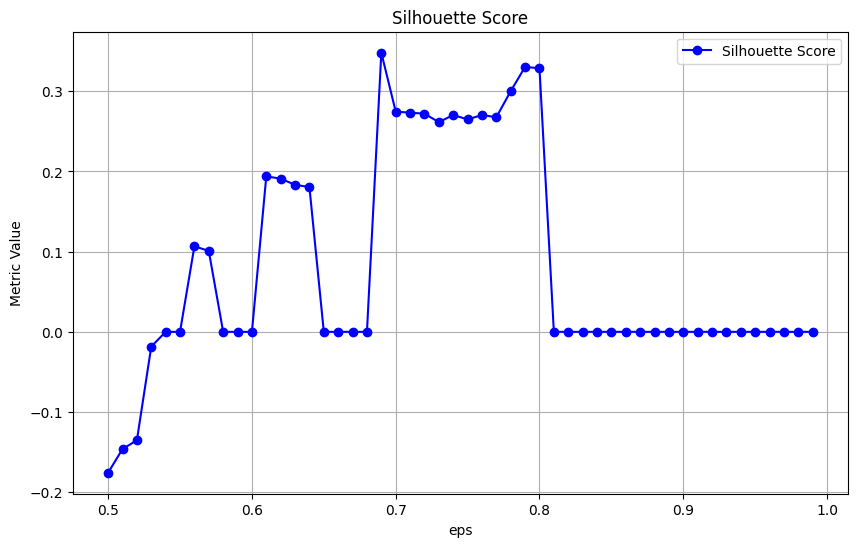

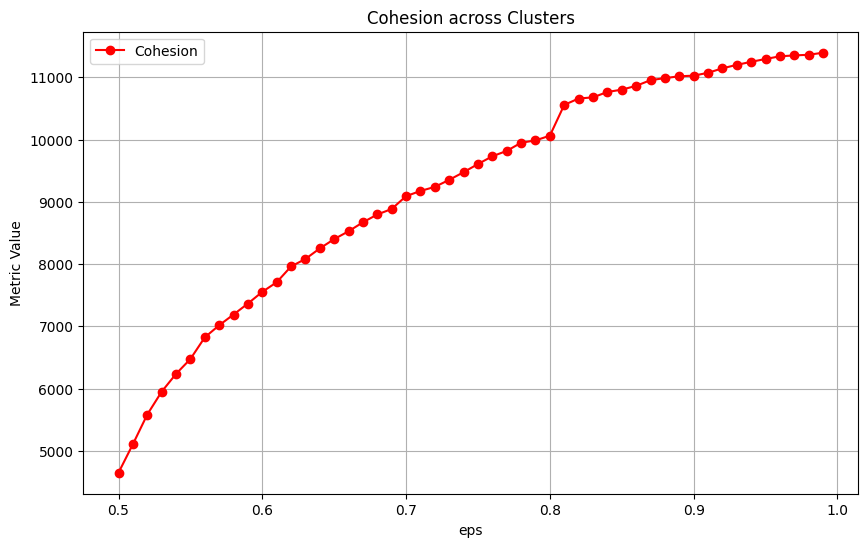

     eps  Clusters   Noise
0   0.50       2.0  2065.0
1   0.51       2.0  1929.0
2   0.52       3.0  1801.0
3   0.53       4.0  1681.0
4   0.54       3.0  1618.0
5   0.55       4.0  1468.0
6   0.56       2.0  1370.0
7   0.57       2.0  1268.0
8   0.58       3.0  1189.0
9   0.59       2.0  1092.0
10  0.60       2.0   995.0
11  0.61       1.0   916.0
12  0.62       2.0   855.0
13  0.63       2.0   793.0
14  0.64       2.0   731.0
15  0.65       2.0   691.0
16  0.66       2.0   646.0
17  0.67       1.0   589.0
18  0.68       1.0   537.0
19  0.69       1.0   507.0
20  0.70       1.0   477.0
21  0.71       1.0   450.0
22  0.72       1.0   427.0
23  0.73       1.0   393.0
24  0.74       1.0   379.0
25  0.75       1.0   359.0
26  0.76       1.0   337.0
27  0.77       1.0   318.0
28  0.78       1.0   306.0
29  0.79       1.0   289.0
30  0.80       1.0   268.0
31  0.81       1.0   255.0
32  0.82       1.0   245.0
33  0.83       1.0   231.0
34  0.84       1.0   225.0
35  0.85       1.0   208.0
3

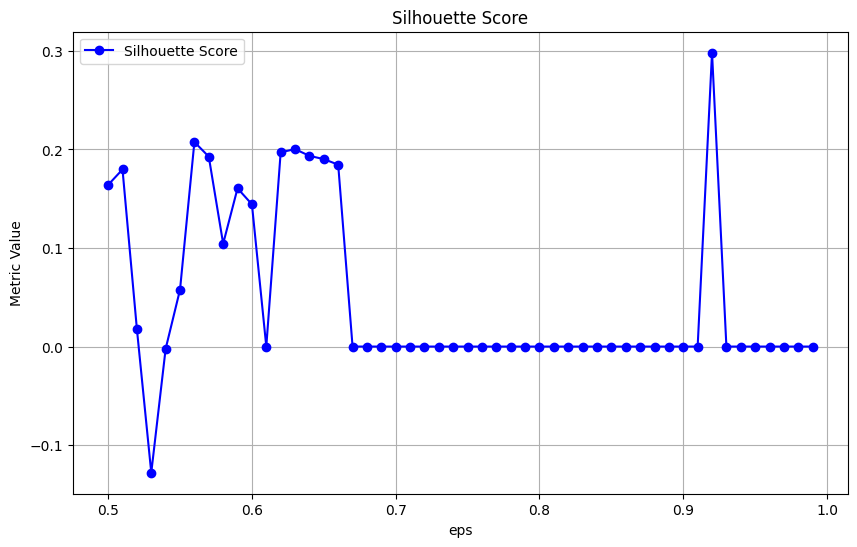

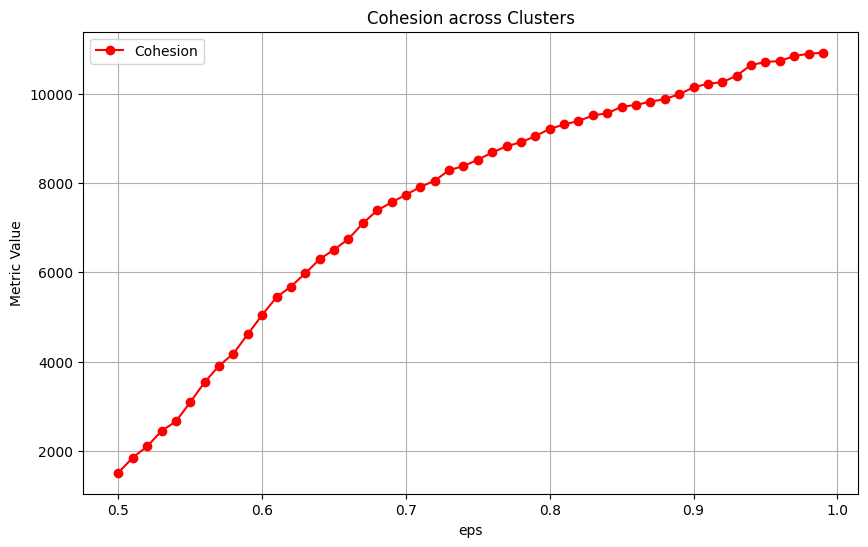

In [13]:
clustering.dbscan_tune(real_cyclists_df, dst_matrix_euclid_cyclists, np.arange(0.5, 1.0, 0.01), 2*real_cyclists_df.shape[1])
clustering.dbscan_tune(real_cyclists_df, dst_matrix_euclid_cyclists, np.arange(0.5, 1.0, 0.01), pow(2,real_cyclists_df.shape[1]))

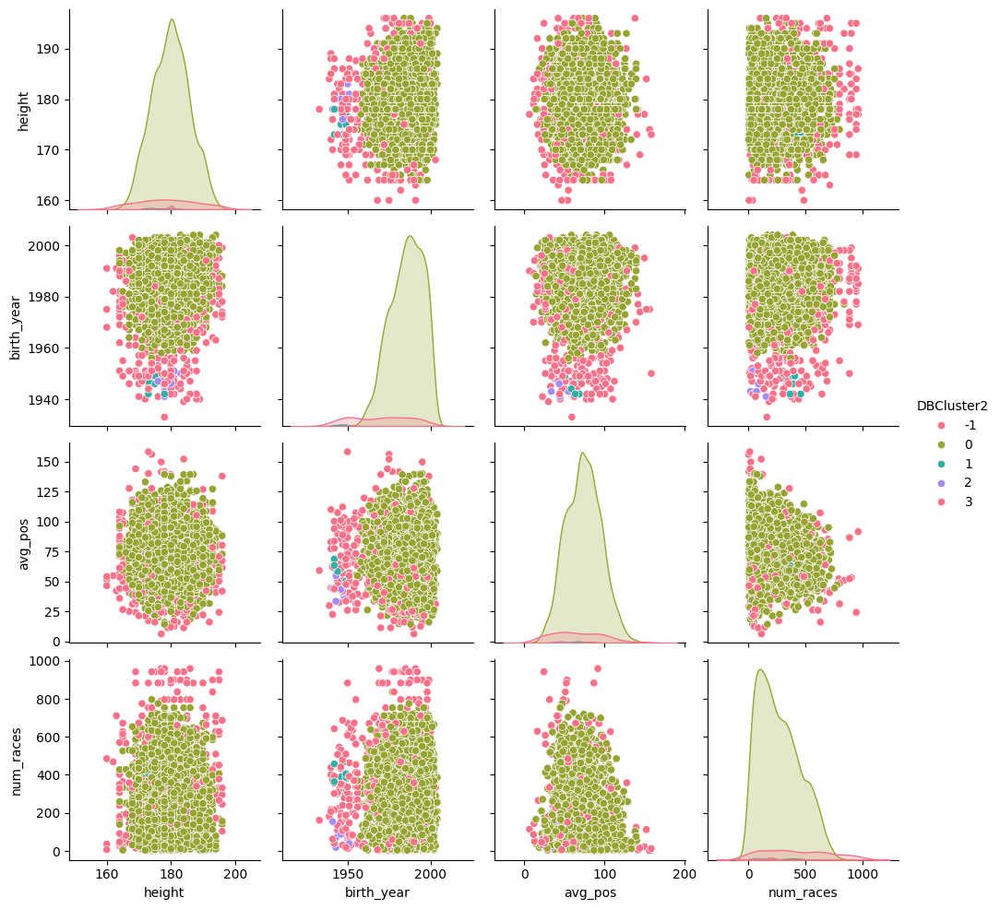

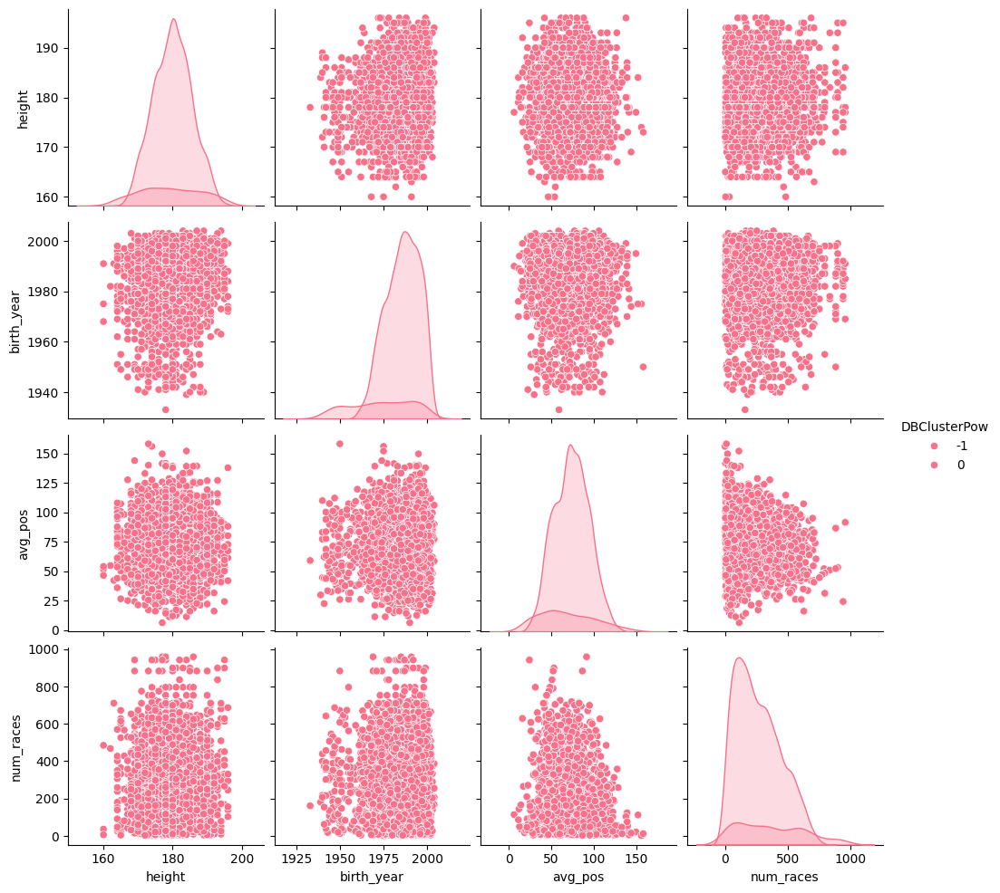

In [13]:
dbscan = DBSCAN(eps=0.7, min_samples=2*real_cyclists_df.shape[1], metric="precomputed", n_jobs=-1)
dbscan.fit_predict(dst_matrix_euclid_cyclists)
labels1 = dbscan.labels_

clustering.optimal_pair_plot(cyclists, 'DBCluster2', labels1)

dbscan = DBSCAN(eps=0.7, min_samples=pow(2,real_cyclists_df.shape[1]), metric="precomputed", n_jobs=-1)
dbscan.fit_predict(dst_matrix_euclid_cyclists)
labels2 = dbscan.labels_

clustering.optimal_pair_plot(cyclists, 'DBClusterPow', labels2)

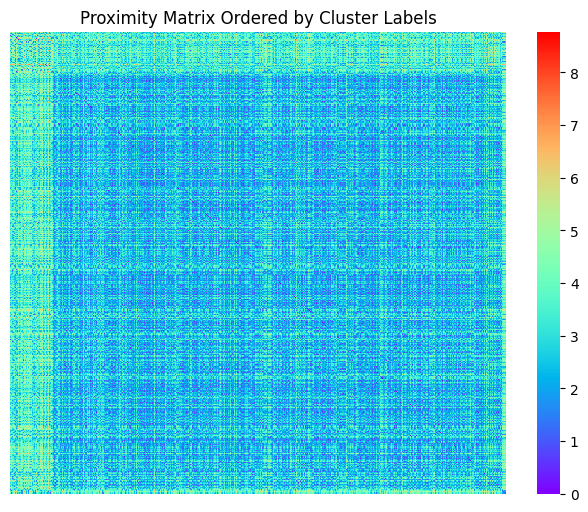

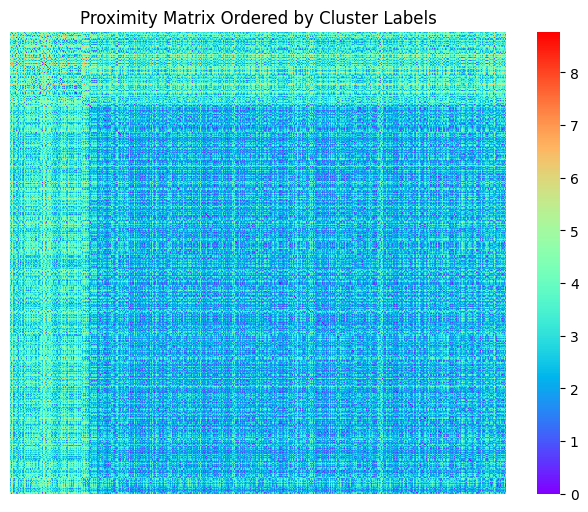

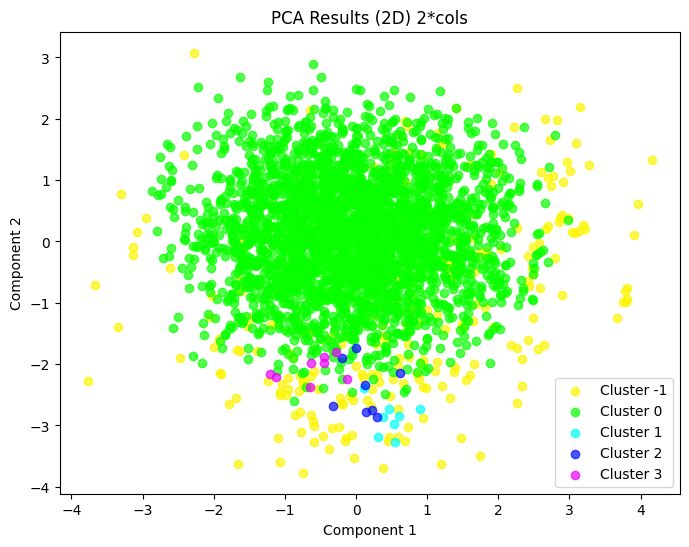

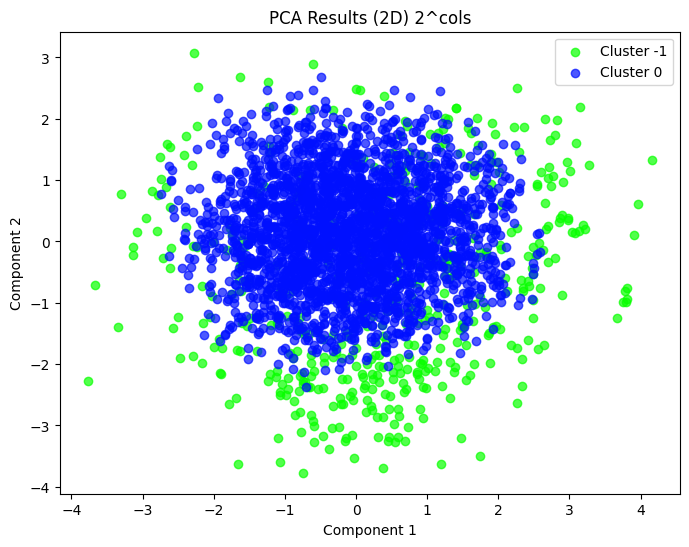

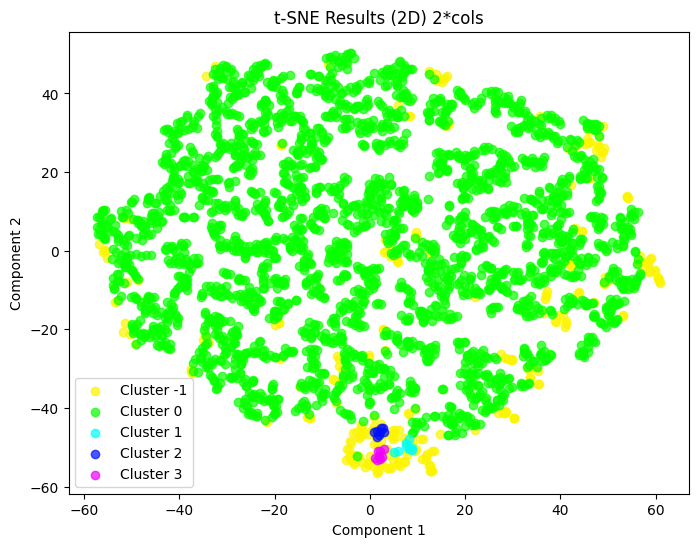

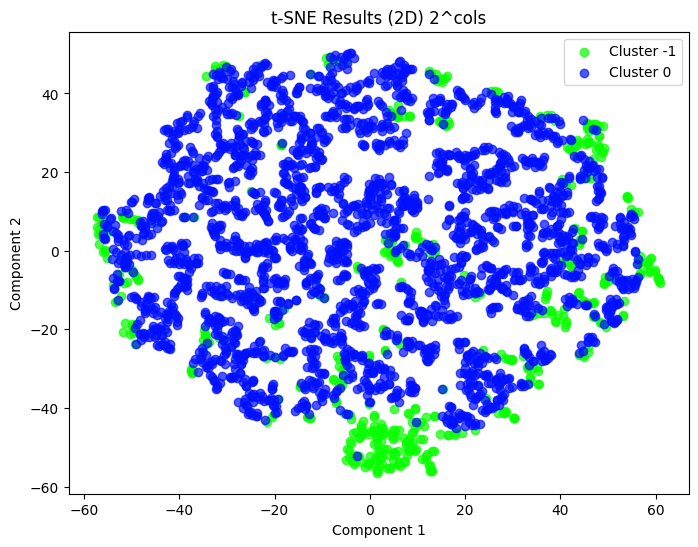

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


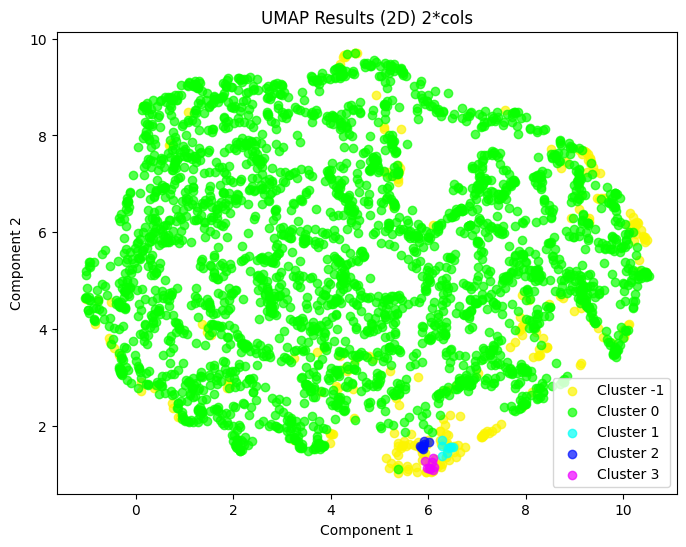

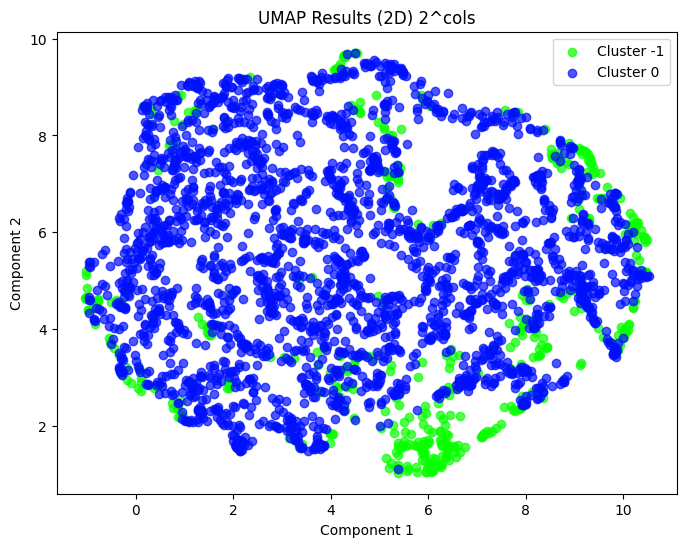

In [14]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels1)
clustering.similarity_matrix(real_cyclists_df, labels2)

pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels1, title="PCA Results (2D) 2*cols", dimensions=2)
plot_results(pca_2d, labels2, title="PCA Results (2D) 2^cols", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels1, title="t-SNE Results (2D) 2*cols", dimensions=2)
plot_results(tsne_2d, labels2, title="t-SNE Results (2D) 2^cols", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels1, title="UMAP Results (2D) 2*cols", dimensions=2)
plot_results(umap_2d, labels2, title="UMAP Results (2D) 2^cols", dimensions=2)

### Stages

In [15]:
dst_matrix_euclid_stages = clustering.compute_distance_matrix(real_stages_df, "euclidean")
dst_matrix_euclid_stages = squareform(dst_matrix_euclid_stages)
ks = [real_stages_df.shape[1] * 2, pow(2, real_stages_df.shape[1])]

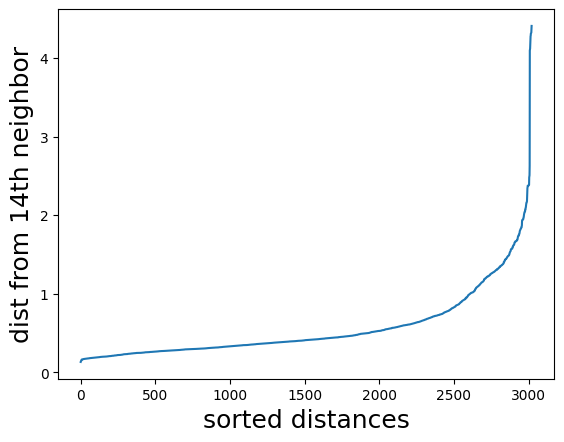

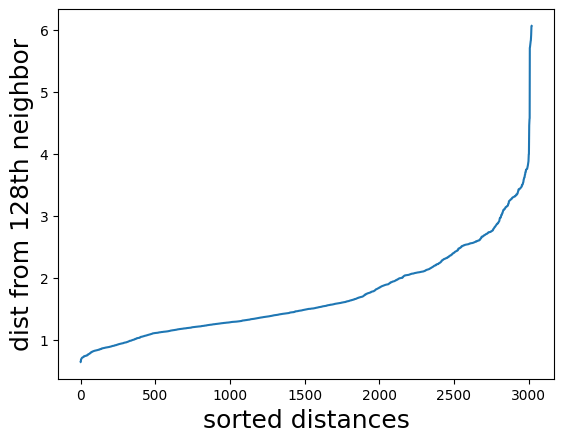

In [65]:
for dist, k in zip([dst_matrix_euclid_stages, dst_matrix_euclid_stages], ks):
    kth_distances = list()
    for d in dist:
        index_kth_distance = np.argsort(d)[k]
        kth_distances.append(d[index_kth_distance])

    plt.plot(range(0, len(kth_distances)), sorted(kth_distances))
    plt.ylabel("dist from %sth neighbor" % k, fontsize=18)
    plt.xlabel("sorted distances", fontsize=18)
    plt.show()

     eps  Clusters  Noise
0   0.80      36.0  343.0
1   0.81      36.0  341.0
2   0.82      36.0  340.0
3   0.83      36.0  340.0
4   0.84      36.0  339.0
..   ...       ...    ...
65  1.45      13.0   76.0
66  1.46      13.0   74.0
67  1.47      13.0   74.0
68  1.48      13.0   72.0
69  1.49      13.0   62.0

[70 rows x 3 columns]


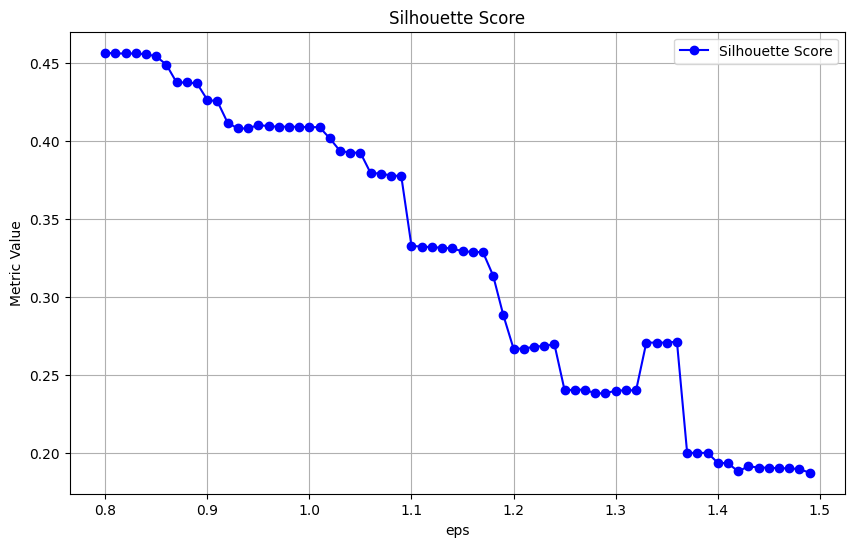

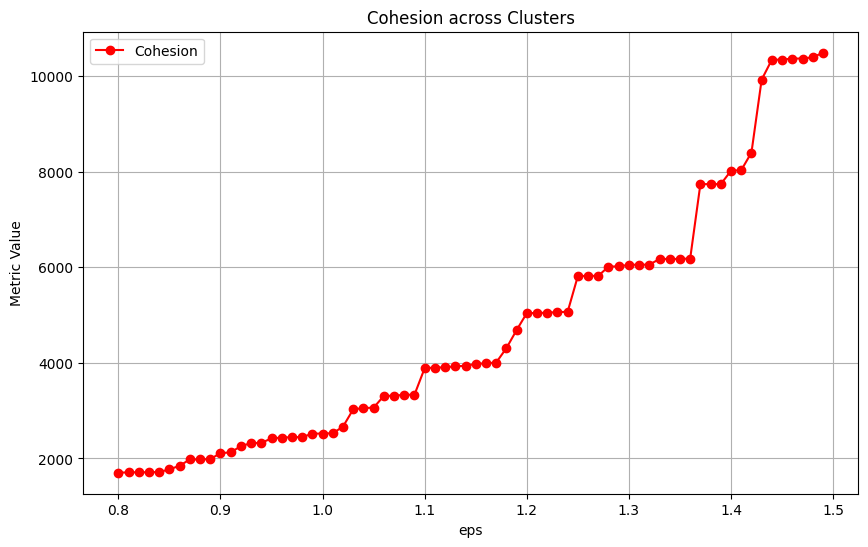

      eps  Clusters  Noise
0    2.00       1.0  240.0
1    2.01       1.0  239.0
2    2.02       1.0  239.0
3    2.03       1.0  236.0
4    2.04       1.0  227.0
..    ...       ...    ...
195  3.95       1.0   13.0
196  3.96       1.0   13.0
197  3.97       1.0   13.0
198  3.98       1.0   13.0
199  3.99       1.0   13.0

[200 rows x 3 columns]


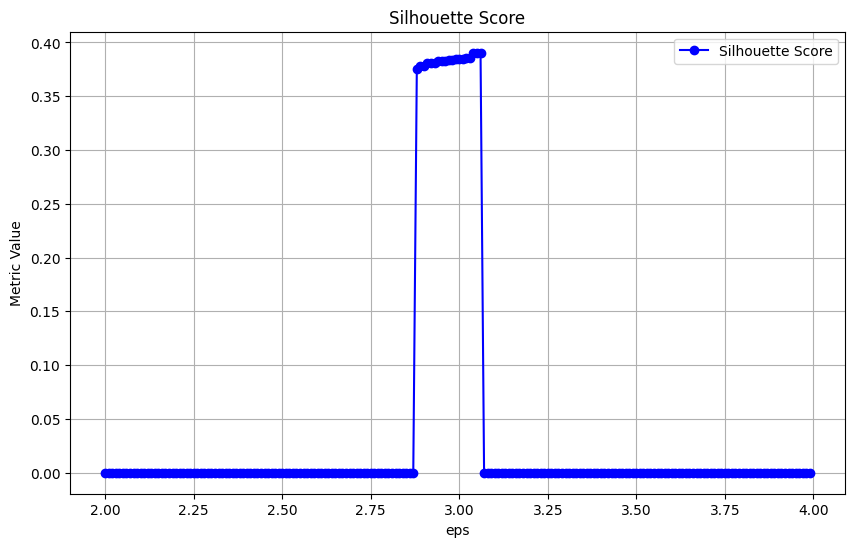

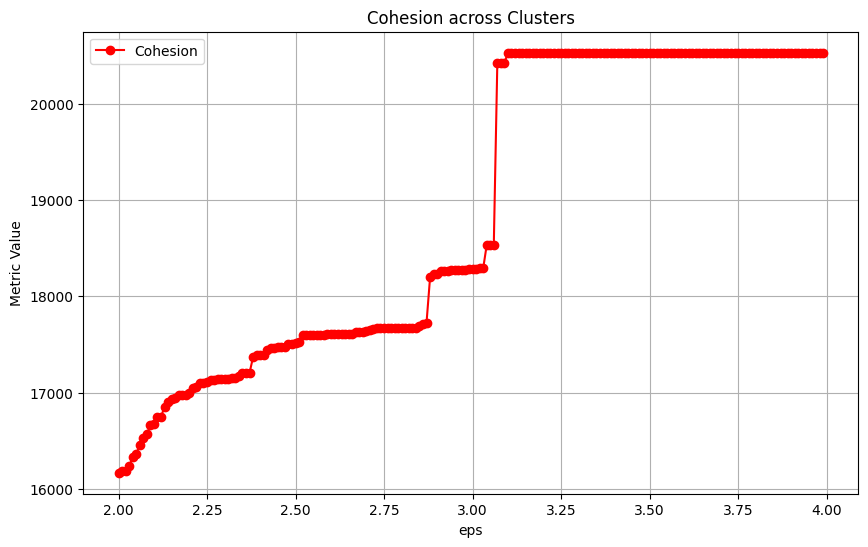

In [17]:
clustering.dbscan_tune(real_stages_df, dst_matrix_euclid_stages, np.arange(0.8, 1.5, 0.01), 2* real_stages_df.shape[1])
clustering.dbscan_tune(real_stages_df, dst_matrix_euclid_stages, np.arange(2, 4, 0.01), pow(2,real_stages_df.shape[1]))

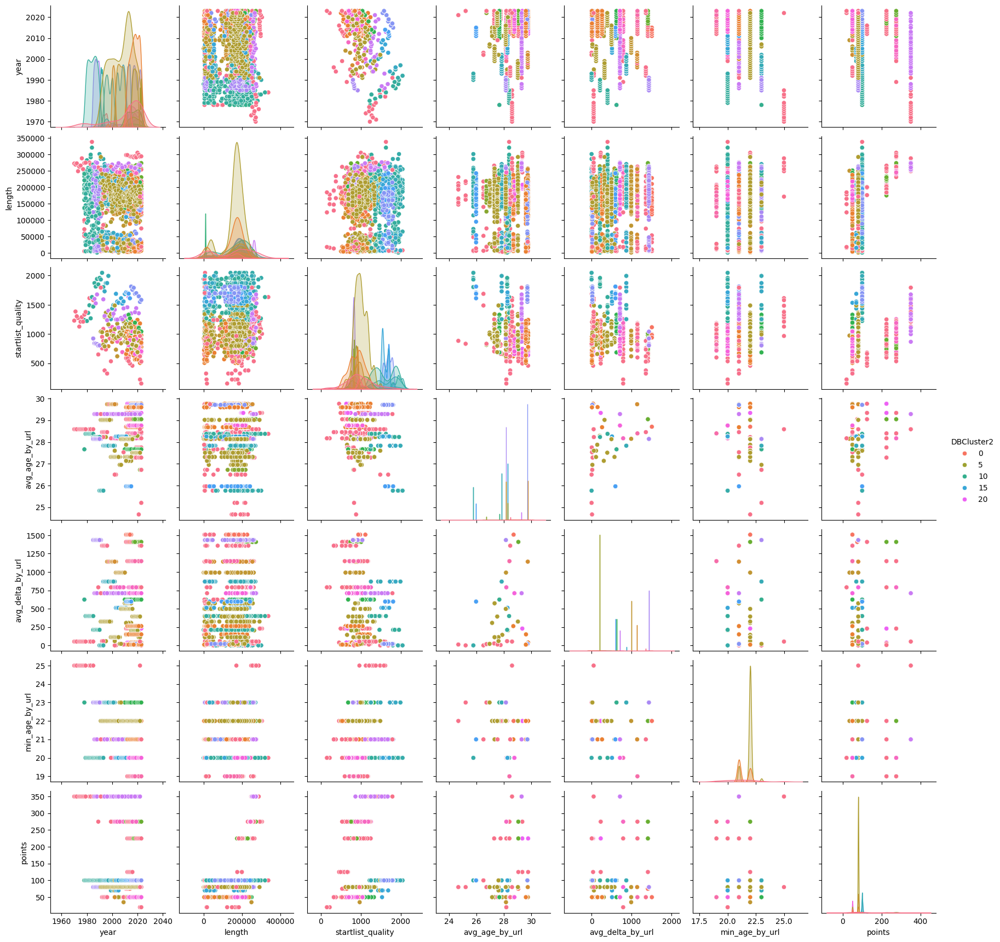

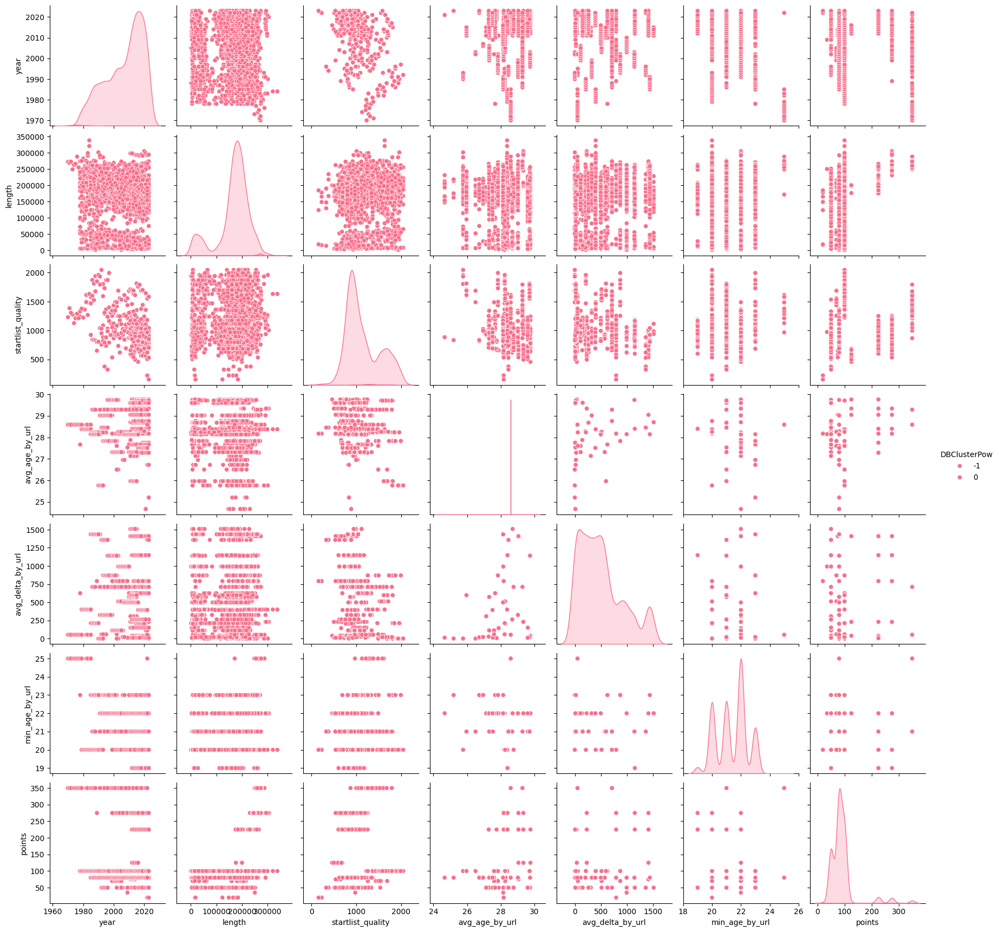

In [18]:
dbscan = DBSCAN(eps=1.1, min_samples=2*real_stages_df.shape[1], metric="precomputed", n_jobs=-1)
dbscan.fit_predict(dst_matrix_euclid_stages)
labels1 = dbscan.labels_

clustering.optimal_pair_plot(stages, 'DBCluster2', labels1)

dbscan = DBSCAN(eps=3.1, min_samples=pow(2,real_stages_df.shape[1]), metric="precomputed", n_jobs=-1)
dbscan.fit_predict(dst_matrix_euclid_stages)
labels2 = dbscan.labels_

clustering.optimal_pair_plot(stages, 'DBClusterPow', labels2)

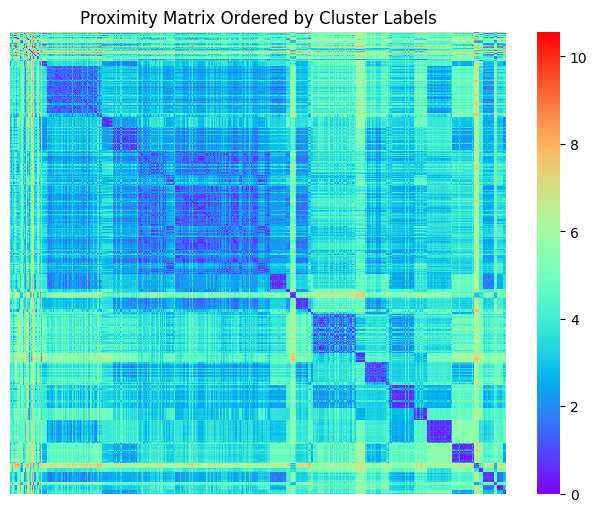

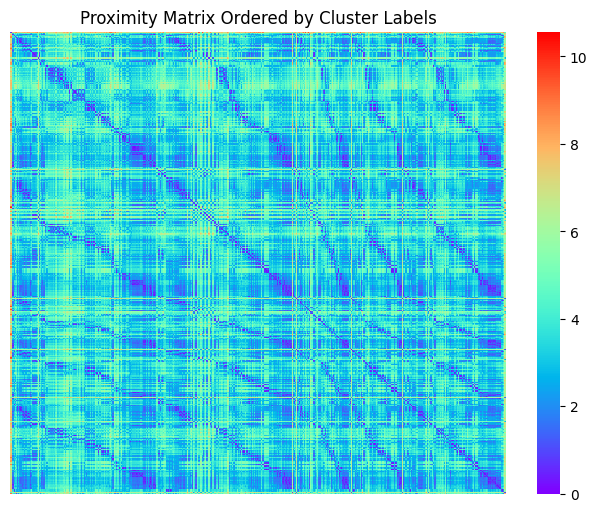

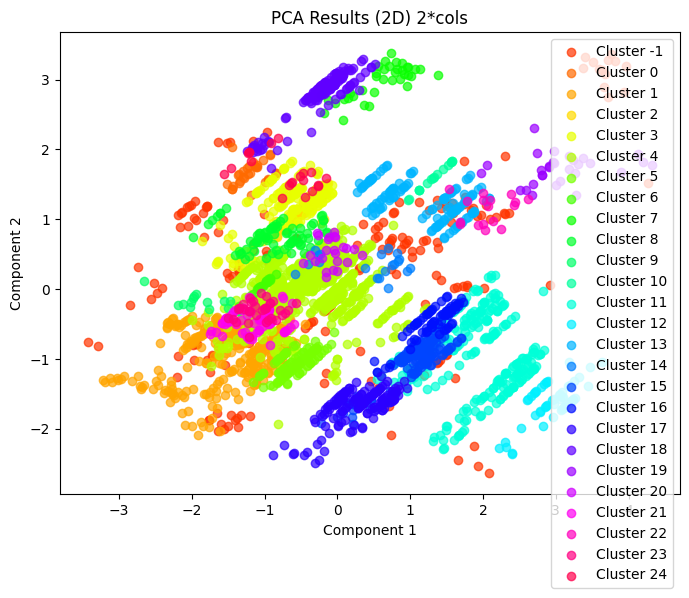

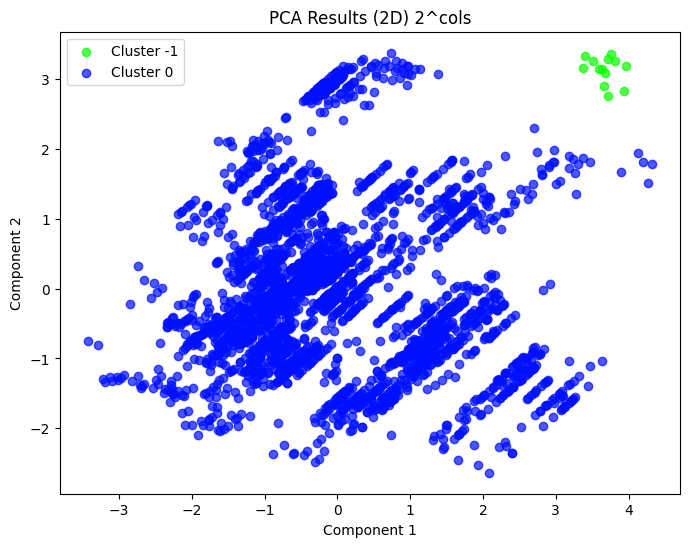

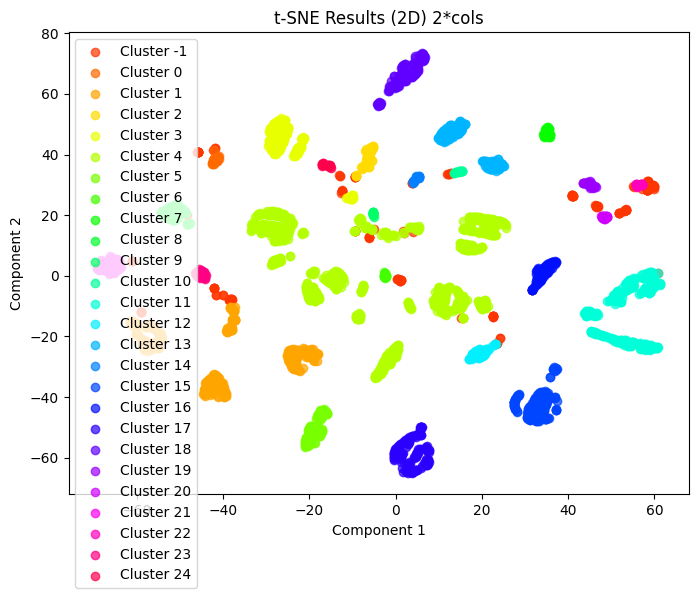

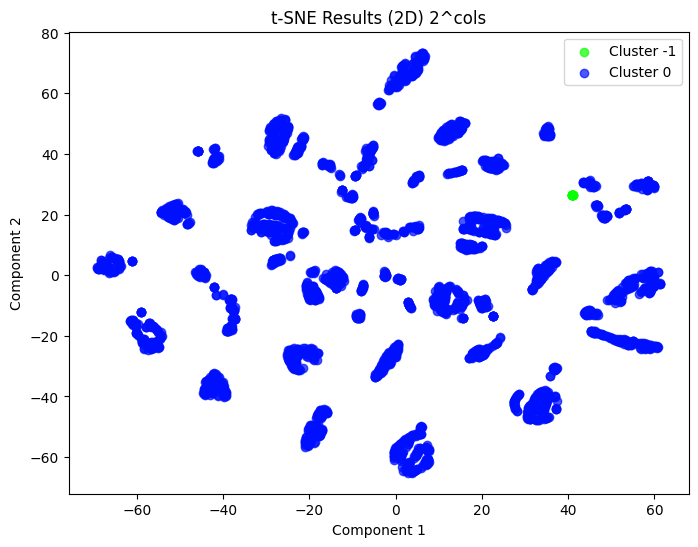

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


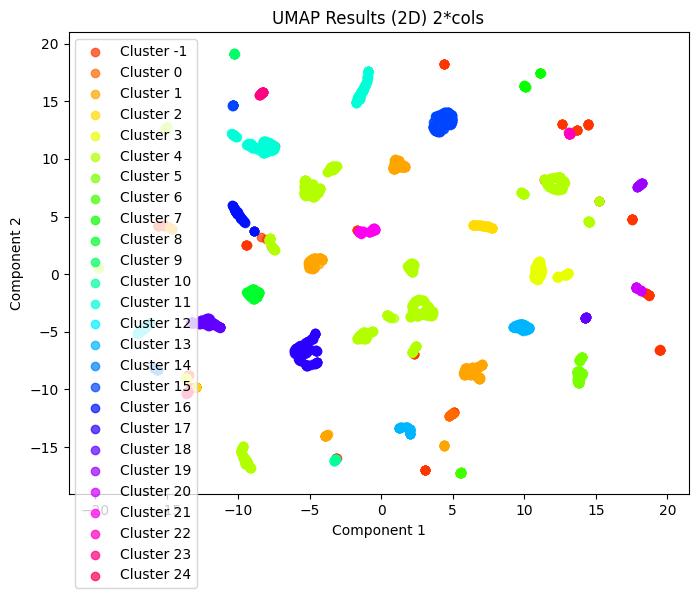

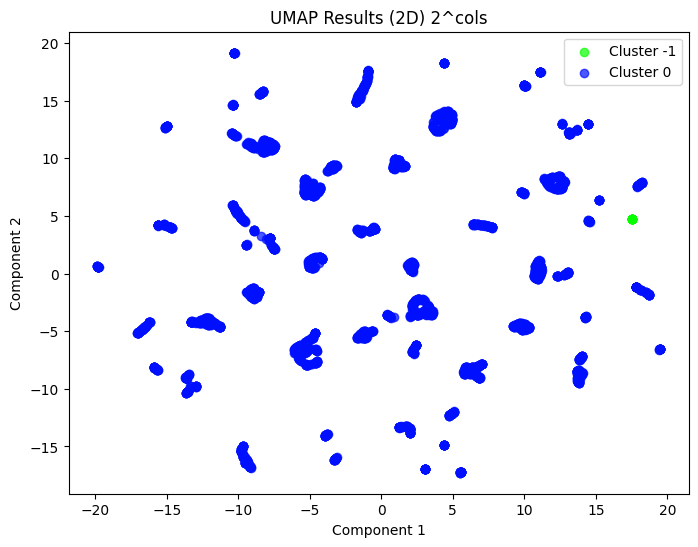

In [19]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels1)
clustering.similarity_matrix(real_stages_df, labels2)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels1, title="PCA Results (2D) 2*cols", dimensions=2)
plot_results(pca_2d, labels2, title="PCA Results (2D) 2^cols", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels1, title="t-SNE Results (2D) 2*cols", dimensions=2)
plot_results(tsne_2d, labels2, title="t-SNE Results (2D) 2^cols", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels1, title="UMAP Results (2D) 2*cols", dimensions=2)
plot_results(umap_2d, labels2, title="UMAP Results (2D) 2^cols", dimensions=2)

### Optics
Tuning according to https://www.sefidian.com/2022/12/18/how-to-determine-epsilon-and-minpts-parameters-of-dbscan-clustering/#:~:text=A%20value%20of%20MinPts%20%3D%202,largest%20to%20the%20smallest%20value.

### Optics Cyclists

Hyperparameters tuning

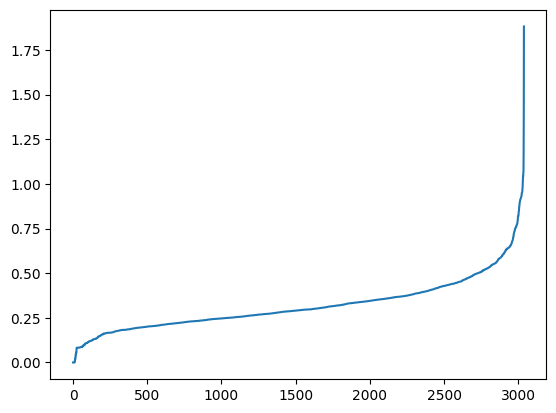

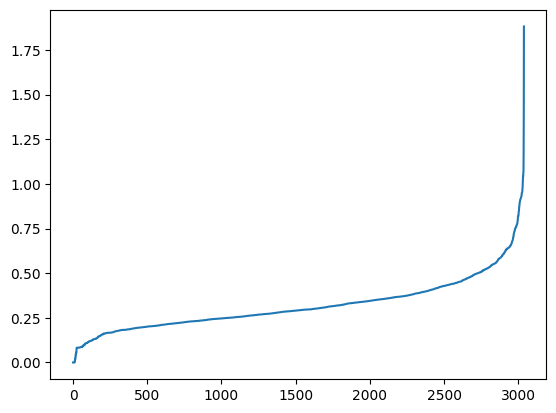

In [21]:
from sklearn.neighbors import NearestNeighbors
def knn_tune(df, samples):
    neighbors = NearestNeighbors(n_neighbors=samples)
    neighbors_fit = neighbors.fit(df)
    distances, indices = neighbors_fit.kneighbors(df)
    distances = np.sort(distances, axis=0)
    distances = distances[:,1]
    plt.plot(distances)
    plt.show()
knn_tune(real_cyclists_df, real_cyclists_df.shape[1]*2)
knn_tune(real_cyclists_df, pow(2,real_cyclists_df.shape[1]))   

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(


Results for different eps values:
     eps  Clusters   Noise
0   0.25       0.0  3039.0
1   0.26       0.0  3039.0
2   0.27       0.0  3039.0
3   0.28       0.0  3039.0
4   0.29       1.0  3030.0
5   0.30       1.0  3030.0
6   0.31       1.0  3030.0
7   0.32       3.0  3000.0
8   0.33       6.0  2971.0
9   0.34      10.0  2914.0
10  0.35      15.0  2841.0
11  0.36      15.0  2762.0
12  0.37      11.0  2700.0
13  0.38      12.0  2884.0
14  0.39      12.0  2868.0
15  0.40      19.0  2843.0
16  0.41      14.0  2851.0
17  0.42      11.0  2896.0
18  0.43      12.0  2899.0
19  0.44      10.0  2940.0
20  0.45      11.0  2932.0
21  0.46      12.0  2916.0
22  0.47      11.0  2928.0
23  0.48      10.0  2939.0
24  0.49      12.0  2912.0
25  0.50      11.0  2931.0
26  0.51      10.0  2944.0
27  0.52       9.0  2954.0
28  0.53      10.0  2945.0
29  0.54       9.0  2954.0
30  0.55       8.0  2963.0
31  0.56       8.0  2963.0
32  0.57       8.0  2963.0
33  0.58       8.0  2963.0
34  0.59       8.0  2

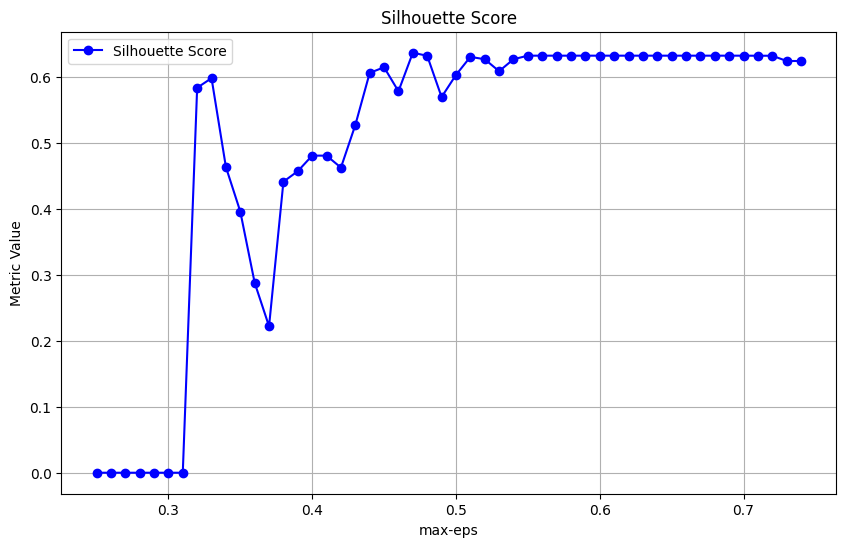

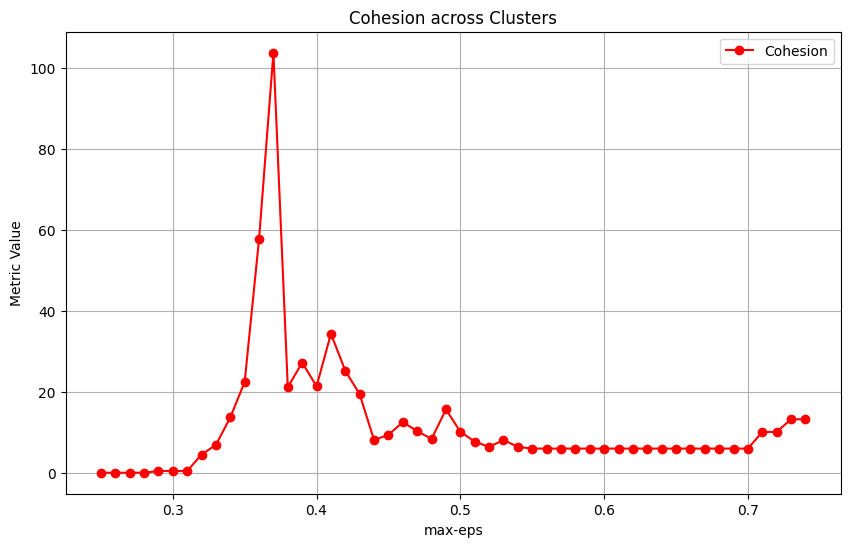

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.

Results for different eps values:
     eps  Clusters   Noise
0   0.25       0.0  3039.0
1   0.26       0.0  3039.0
2   0.27       0.0  3039.0
3   0.28       0.0  3039.0
4   0.29       0.0  3039.0
5   0.30       0.0  3039.0
6   0.31       0.0  3039.0
7   0.32       0.0  3039.0
8   0.33       0.0  3039.0
9   0.34       0.0  3039.0
10  0.35       0.0  3039.0
11  0.36       0.0  3039.0
12  0.37       0.0  3039.0
13  0.38       0.0  3039.0
14  0.39       0.0  3039.0
15  0.40       0.0  3039.0
16  0.41       1.0  3022.0
17  0.42       1.0  3003.0
18  0.43       3.0  2953.0
19  0.44       3.0  2877.0
20  0.45       8.0  2715.0
21  0.46       5.0  2573.0
22  0.47       2.0  2476.0
23  0.48       1.0  2373.0
24  0.49       1.0  2270.0
25  0.50       1.0  2096.0
26  0.51       1.0  3022.0
27  0.52       2.0  3000.0
28  0.53       1.0  3022.0
29  0.54       1.0  1644.0
30  0.55       1.0  1504.0
31  0.56       1.0  1380.0
32  0.57       1.0  1279.0
33  0.58       1.0  1212.0
34  0.59       1.0  1

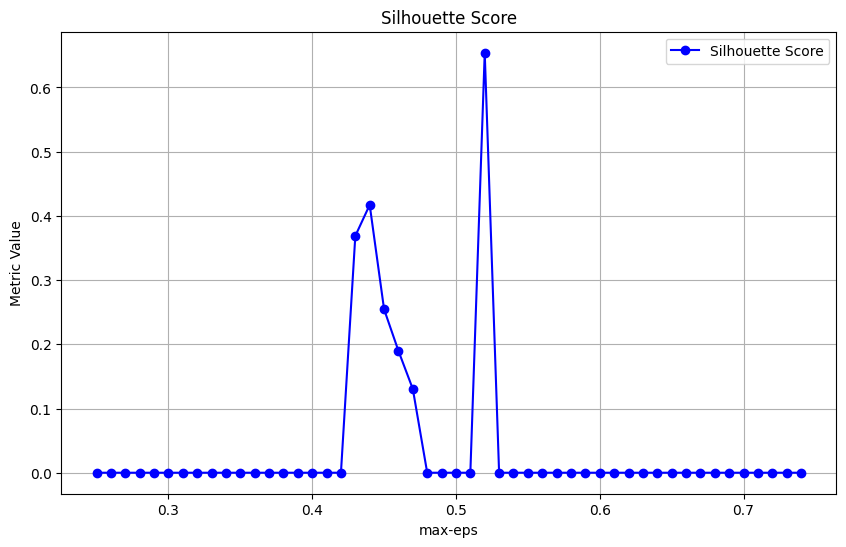

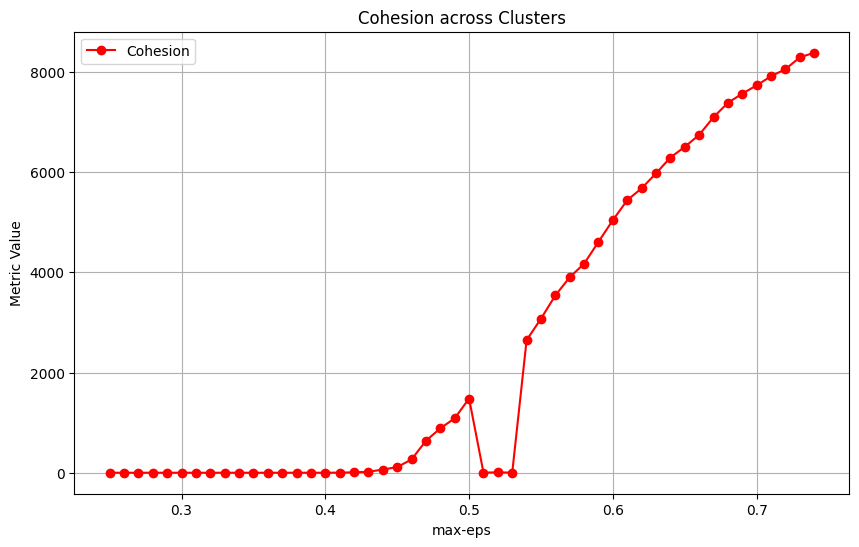

In [22]:
clustering.optics_tune(real_cyclists_df, np.arange(0.25, 0.75, 0.01), 2*real_cyclists_df.shape[1])
clustering.optics_tune(real_cyclists_df, np.arange(0.25, 0.75, 0.01), pow(2,real_cyclists_df.shape[1]))

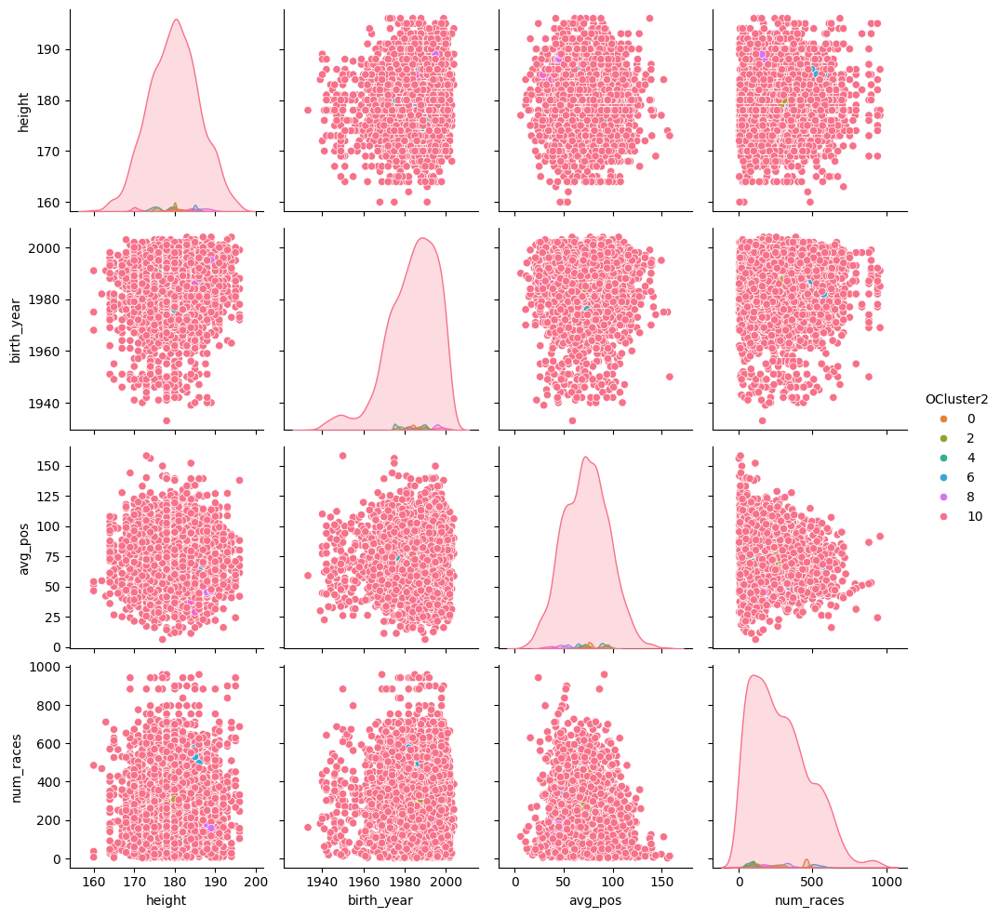

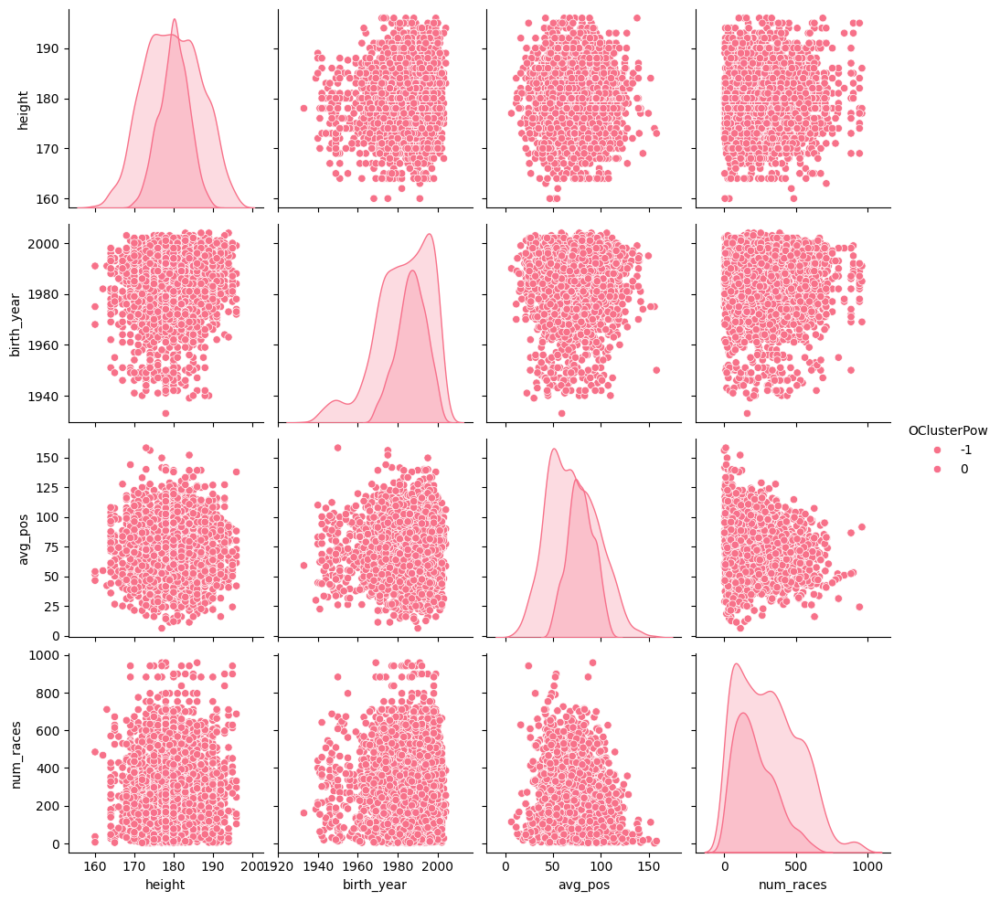

In [24]:
optics = OPTICS(max_eps=0.5, min_samples=2*real_cyclists_df.shape[1], metric='euclidean')
optics.fit(real_cyclists_df.values)

labels1 = optics.labels_
clustering.optimal_pair_plot(cyclists, 'OCluster2', labels1)

optics = OPTICS(max_eps=0.5, min_samples=pow(2,real_cyclists_df.shape[1]), metric='euclidean')
optics.fit(real_cyclists_df.values)

labels2 = optics.labels_
clustering.optimal_pair_plot(cyclists, 'OClusterPow', labels2)

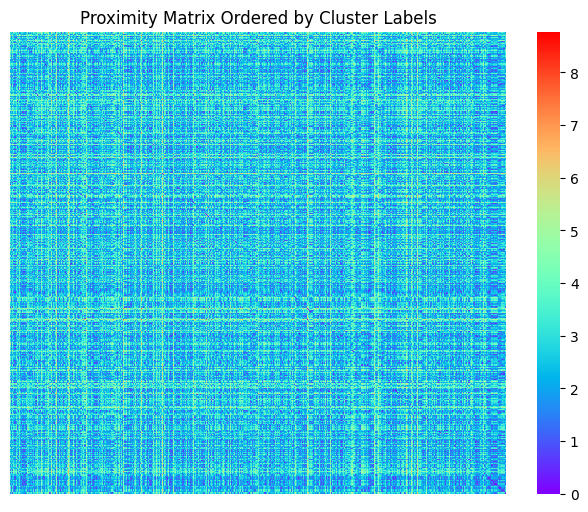

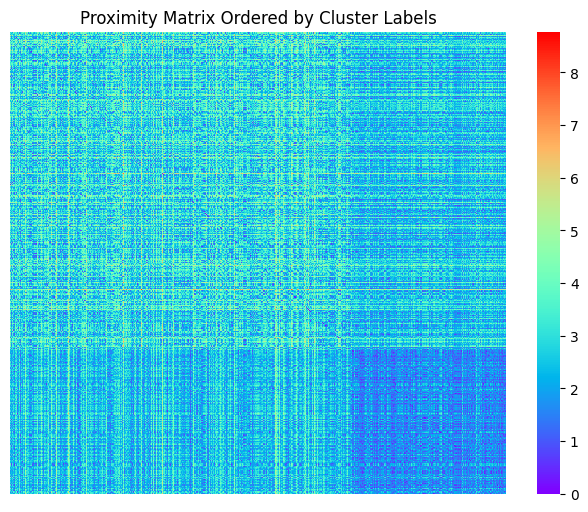

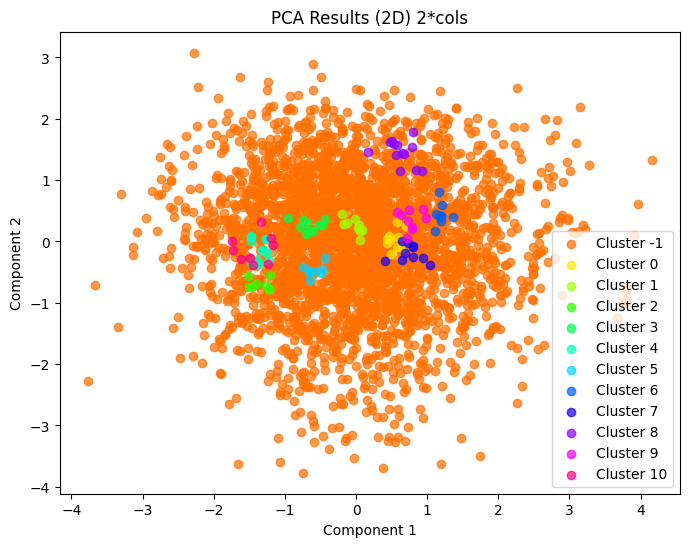

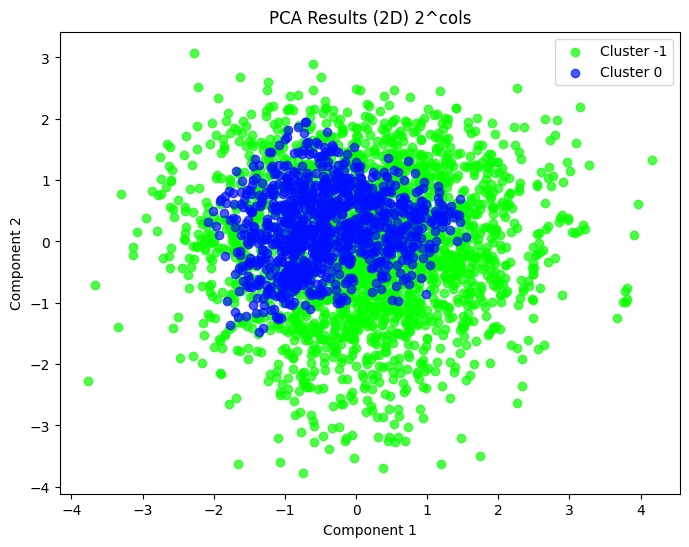

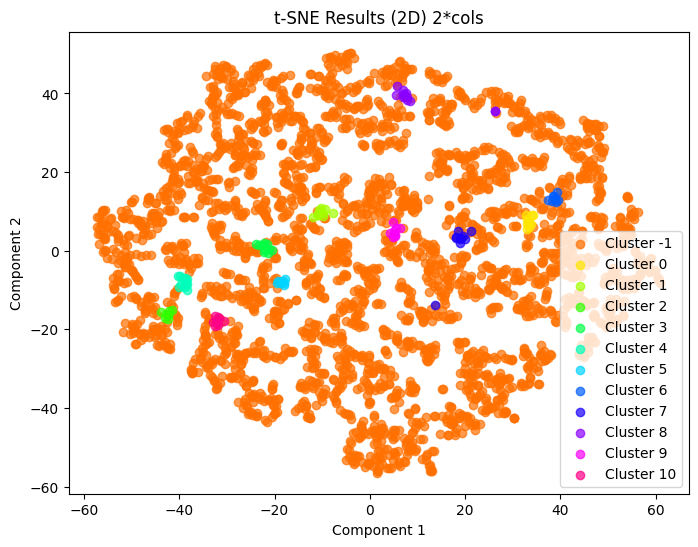

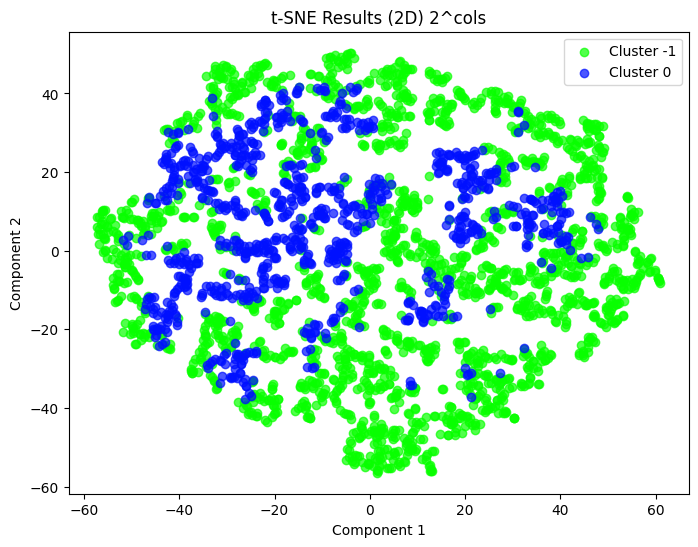

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


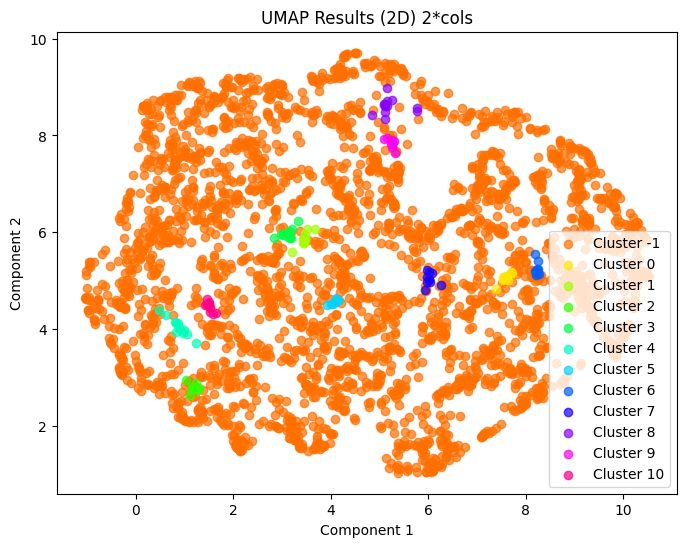

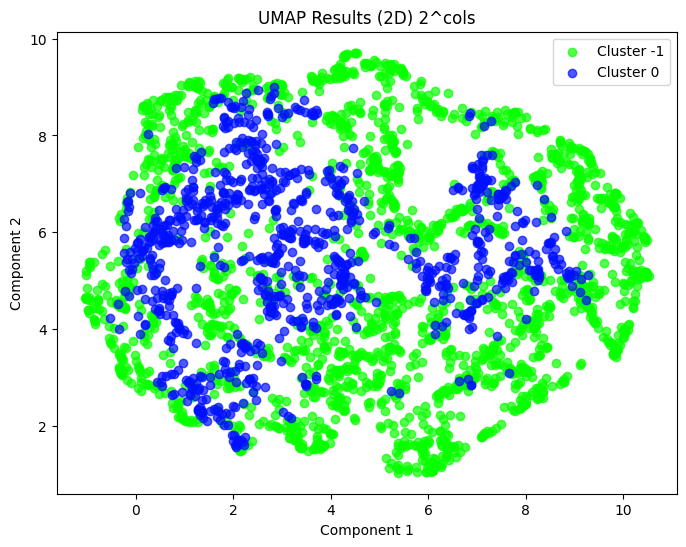

In [25]:
data_scaled = real_cyclists_df

clustering.similarity_matrix(real_cyclists_df, labels1)
clustering.similarity_matrix(real_cyclists_df, labels2)

pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels1, title="PCA Results (2D) 2*cols", dimensions=2)
plot_results(pca_2d, labels2, title="PCA Results (2D) 2^cols", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels1, title="t-SNE Results (2D) 2*cols", dimensions=2)
plot_results(tsne_2d, labels2, title="t-SNE Results (2D) 2^cols", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels1, title="UMAP Results (2D) 2*cols", dimensions=2)
plot_results(umap_2d, labels2, title="UMAP Results (2D) 2^cols", dimensions=2)

### Optics Stages

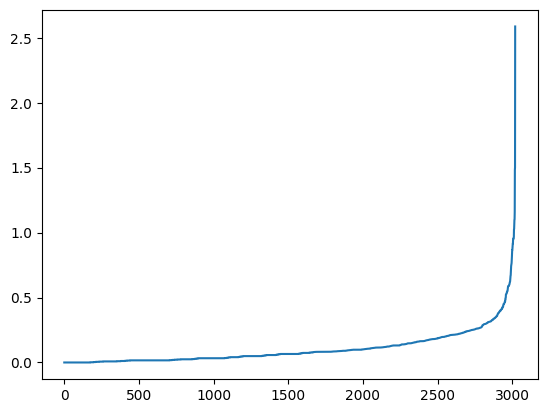

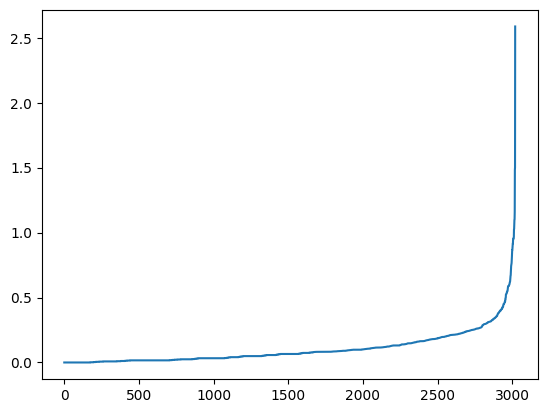

In [26]:
knn_tune(real_stages_df, 2*real_stages_df.shape[1])
knn_tune(real_stages_df, pow(2,real_stages_df.shape[1]))

Results for different eps values:
     eps  Clusters   Noise
0   0.30      30.0  2126.0
1   0.31      31.0  2092.0
2   0.32      33.0  2048.0
3   0.33      34.0  1994.0
4   0.34      35.0  2038.0
5   0.35      36.0  2014.0
6   0.36      40.0  1945.0
7   0.37      39.0  1921.0
8   0.38      41.0  1895.0
9   0.39      43.0  1843.0
10  0.40      45.0  1789.0
11  0.41      44.0  1848.0
12  0.42      47.0  1794.0
13  0.43      46.0  1800.0
14  0.44      47.0  1788.0
15  0.45      47.0  1773.0
16  0.46      47.0  1770.0
17  0.47      47.0  1769.0
18  0.48      49.0  1733.0
19  0.49      49.0  1731.0
20  0.50      48.0  1744.0
21  0.51      48.0  1743.0
22  0.52      49.0  1719.0
23  0.53      49.0  1718.0
24  0.54      49.0  1712.0
25  0.55      49.0  1709.0
26  0.56      49.0  1709.0
27  0.57      49.0  1710.0
28  0.58      50.0  1686.0
29  0.59      50.0  1680.0
30  0.60      51.0  1663.0
31  0.61      52.0  1647.0
32  0.62      52.0  1646.0
33  0.63      53.0  1630.0
34  0.64      54.0  1

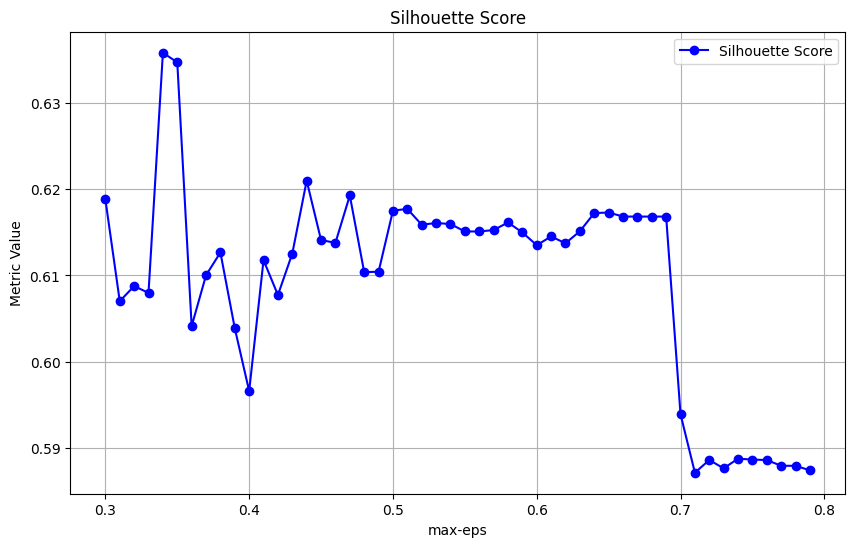

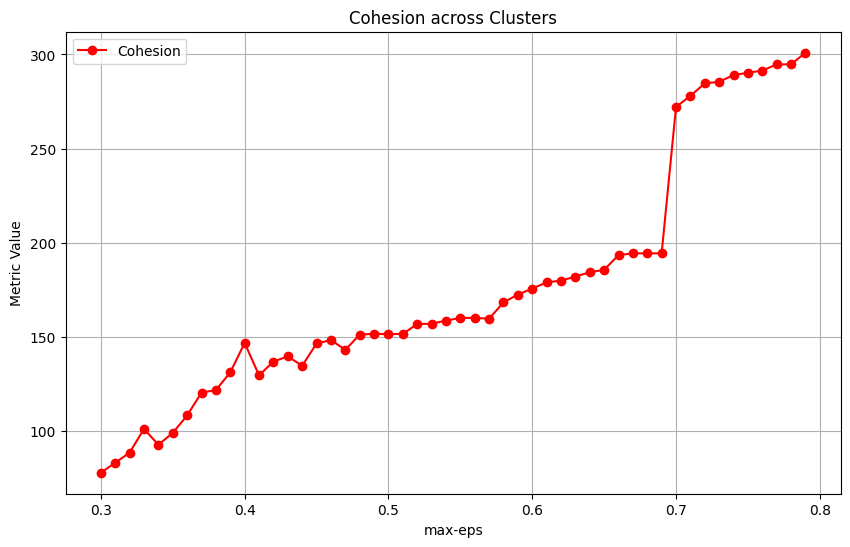

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(
C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.

Results for different eps values:
     eps  Clusters   Noise
0   0.30       0.0  3021.0
1   0.31       0.0  3021.0
2   0.32       0.0  3021.0
3   0.33       0.0  3021.0
4   0.34       0.0  3021.0
5   0.35       0.0  3021.0
6   0.36       0.0  3021.0
7   0.37       0.0  3021.0
8   0.38       0.0  3021.0
9   0.39       0.0  3021.0
10  0.40       0.0  3021.0
11  0.41       0.0  3021.0
12  0.42       0.0  3021.0
13  0.43       0.0  3021.0
14  0.44       0.0  3021.0
15  0.45       0.0  3021.0
16  0.46       0.0  3021.0
17  0.47       0.0  3021.0
18  0.48       0.0  3021.0
19  0.49       0.0  3021.0
20  0.50       0.0  3021.0
21  0.51       0.0  3021.0
22  0.52       0.0  3021.0
23  0.53       0.0  3021.0
24  0.54       0.0  3021.0
25  0.55       0.0  3021.0
26  0.56       0.0  3021.0
27  0.57       0.0  3021.0
28  0.58       0.0  3021.0
29  0.59       0.0  3021.0
30  0.60       0.0  3021.0
31  0.61       0.0  3021.0
32  0.62       0.0  3021.0
33  0.63       0.0  3021.0
34  0.64       0.0  3

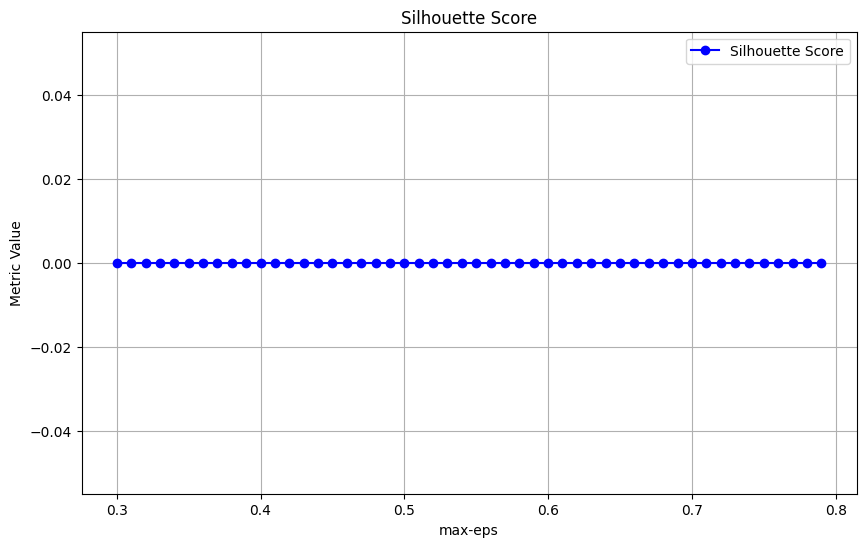

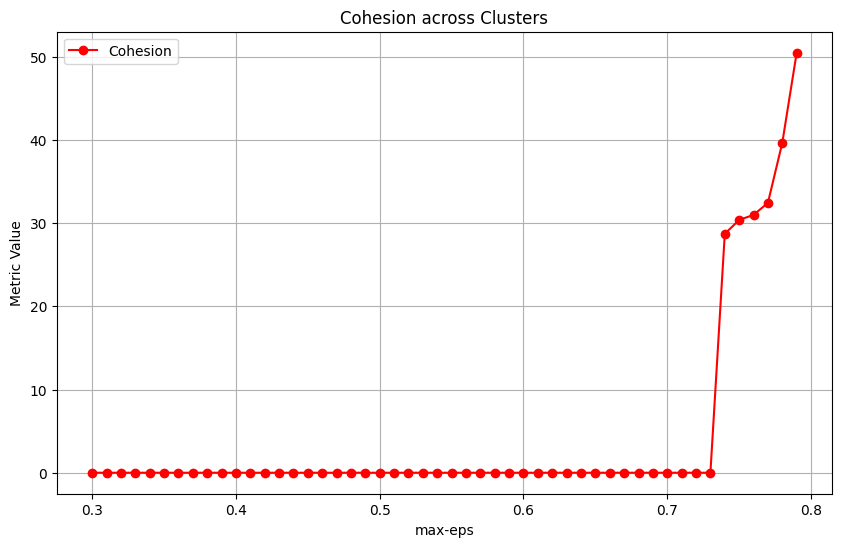

In [31]:
clustering.optics_tune(real_stages_df, np.arange(0.3, 0.8, 0.01), 2*real_stages_df.shape[1])
clustering.optics_tune(real_stages_df, np.arange(0.3, 0.8, 0.01), pow(2,real_stages_df.shape[1]))

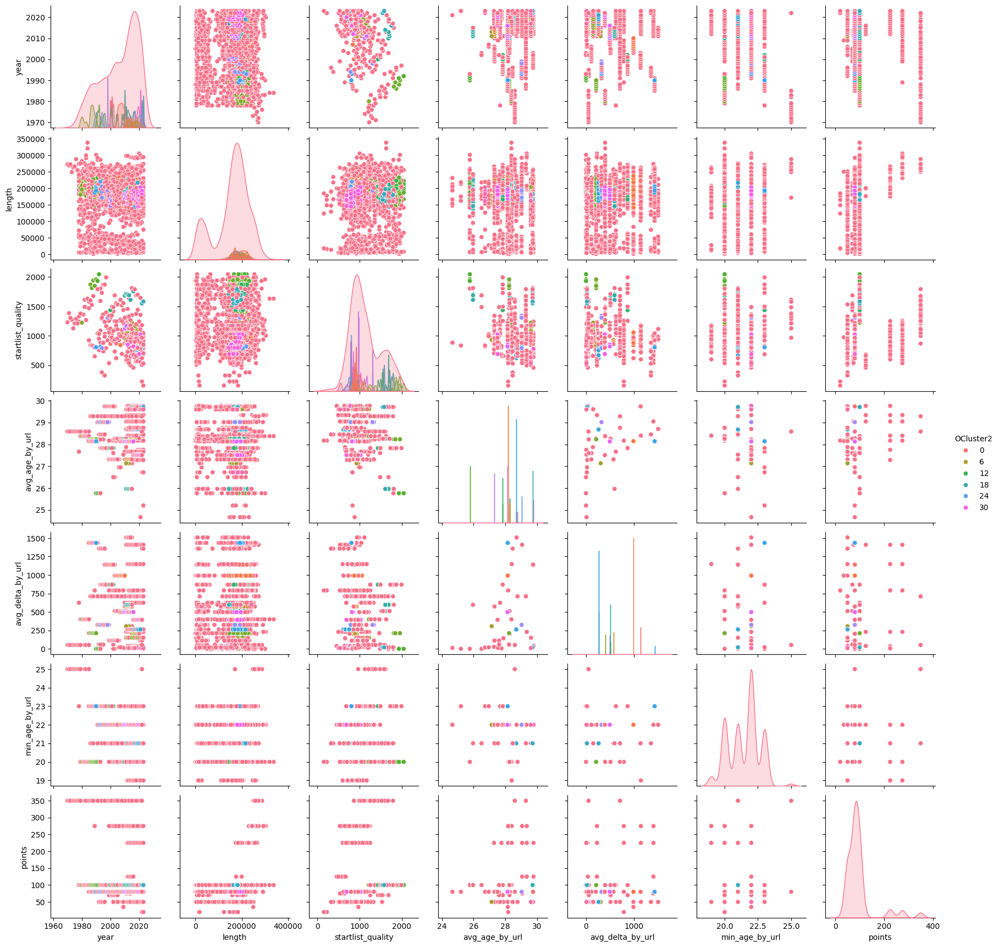

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\sklearn\cluster\_optics.py:661: UserWarning: All reachability values are inf. Set a larger max_eps or all data will be considered outliers.
  warnings.warn(


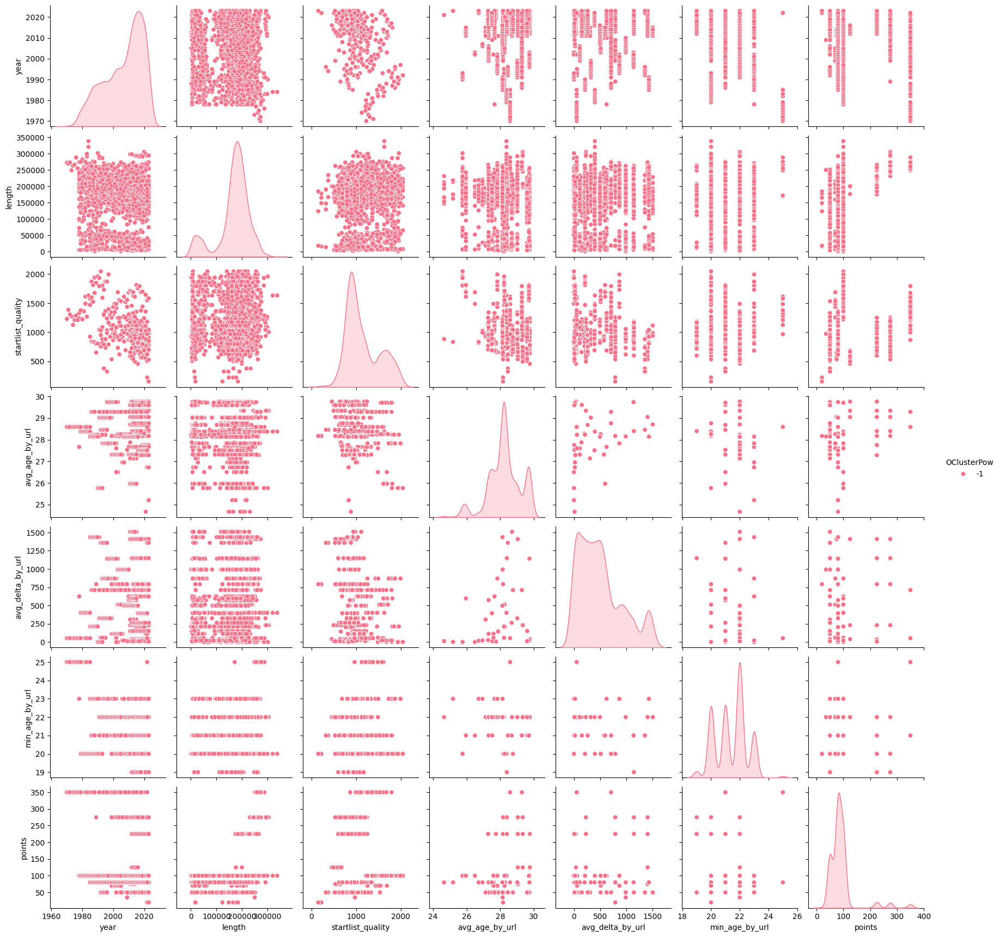

In [32]:
optics = OPTICS(max_eps=0.35, min_samples=2*real_stages_df.shape[1], metric='euclidean')
optics.fit(real_stages_df.values)

labels1 = optics.labels_
clustering.optimal_pair_plot(stages, 'OCluster2', labels1)

optics = OPTICS(max_eps=0.35, min_samples=pow(2,real_stages_df.shape[1]), metric='euclidean')
optics.fit(real_stages_df.values)

labels2 = optics.labels_
clustering.optimal_pair_plot(stages, 'OClusterPow', labels2)

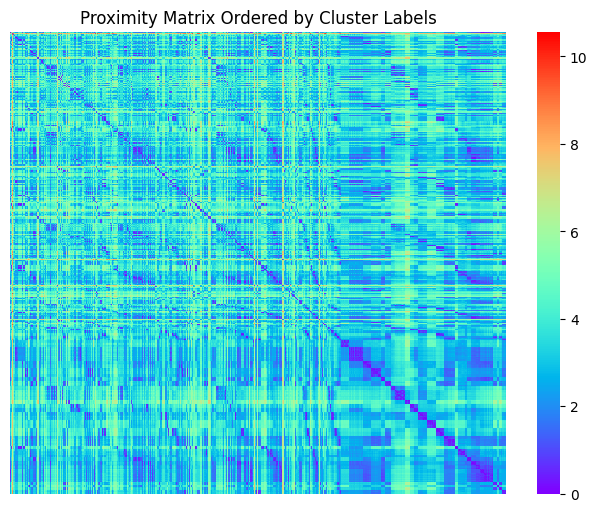

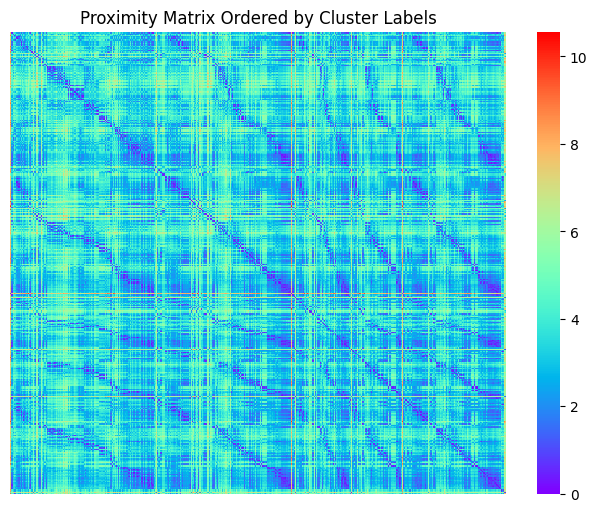

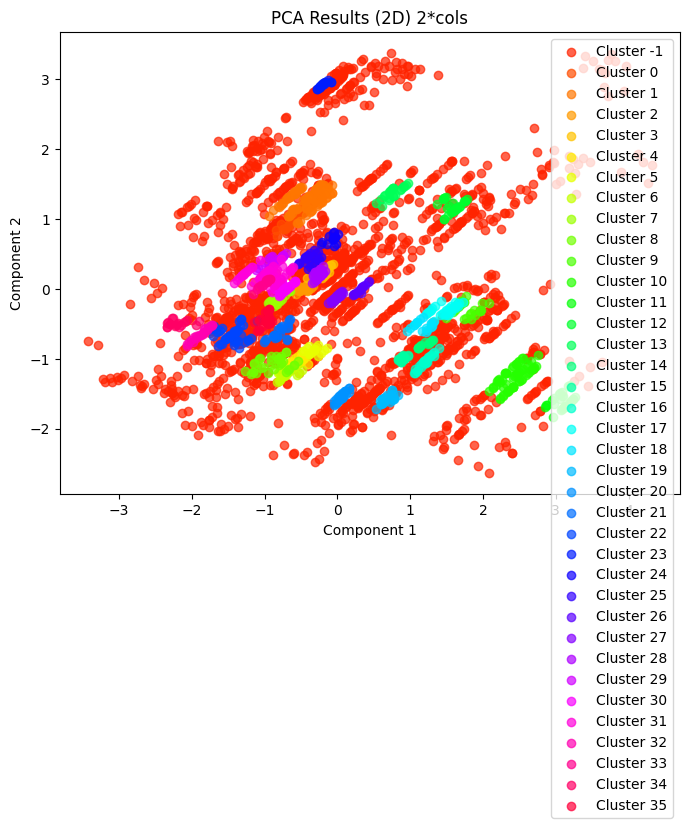

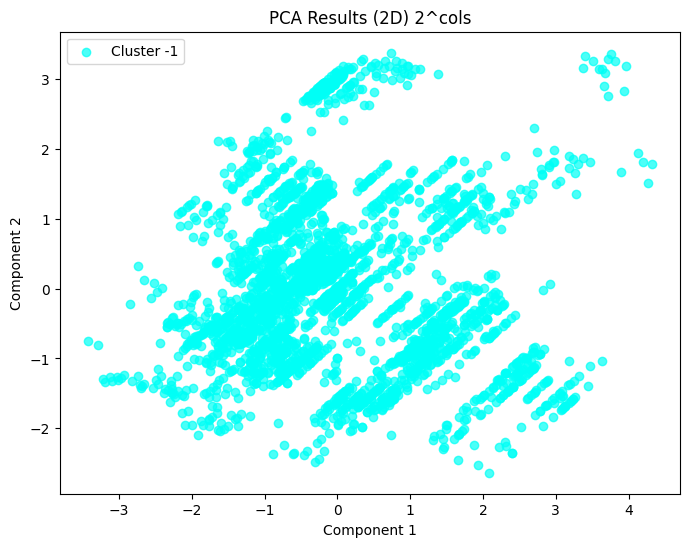

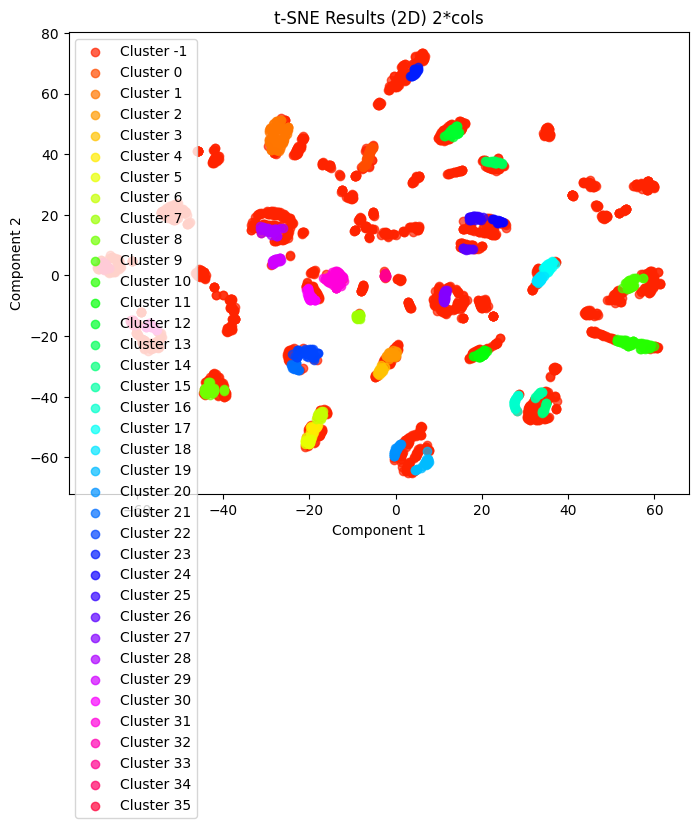

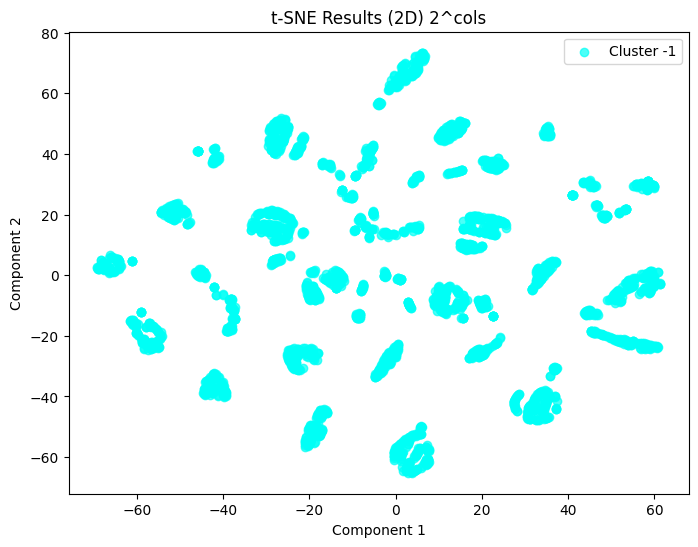

C:\Users\Tommaso\Documents\Studio\Progetti\Python\Test\.venv\Lib\site-packages\umap\umap_.py:1952: UserWarning: n_jobs value 1 overridden to 1 by setting random_state. Use no seed for parallelism.
  warn(


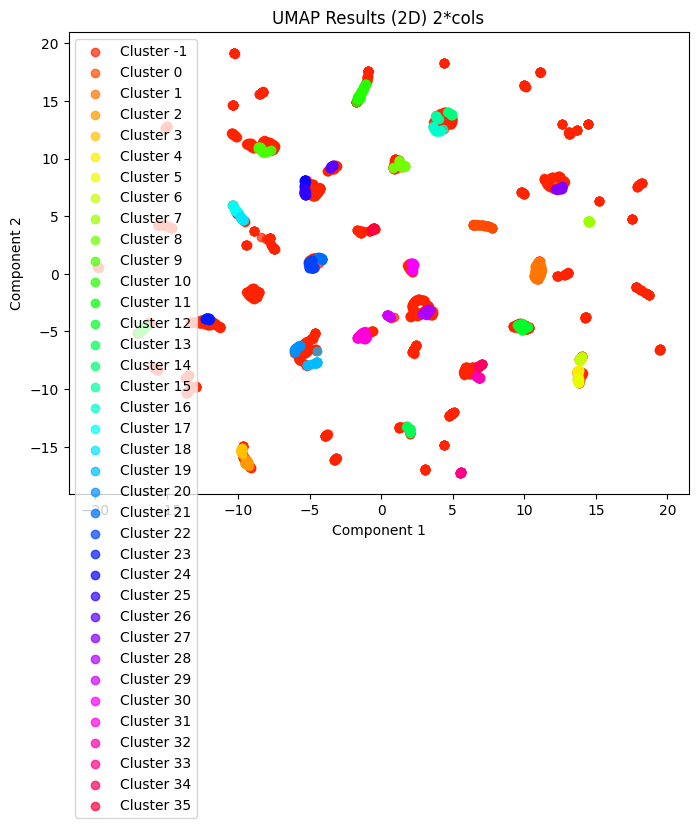

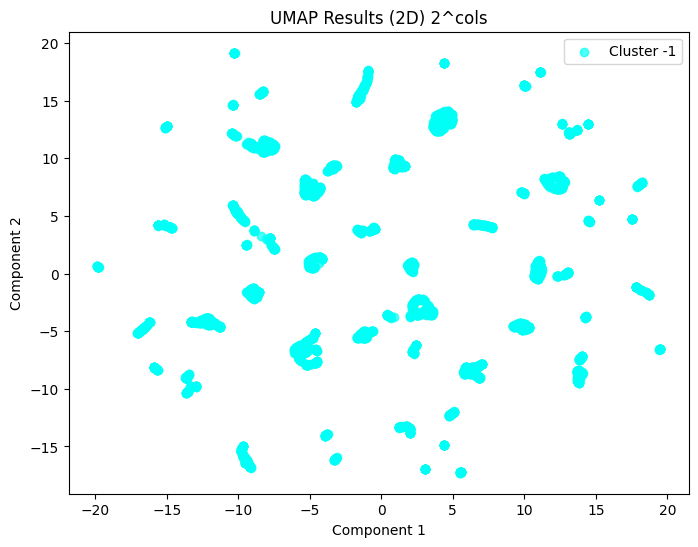

In [33]:
data_scaled = real_stages_df

clustering.similarity_matrix(real_stages_df, labels1)
clustering.similarity_matrix(real_stages_df, labels2)
# 2D PCA
pca_2d = apply_pca(data_scaled, dimensions=2)
plot_results(pca_2d, labels1, title="PCA Results (2D) 2*cols", dimensions=2)
plot_results(pca_2d, labels2, title="PCA Results (2D) 2^cols", dimensions=2)

# 2D t-SNE
tsne_2d = apply_tsne(data_scaled, dimensions=2)
plot_results(tsne_2d, labels1, title="t-SNE Results (2D) 2*cols", dimensions=2)
plot_results(tsne_2d, labels2, title="t-SNE Results (2D) 2^cols", dimensions=2)

# 2D UMAP
umap_2d = apply_umap(data_scaled, dimensions=2)
plot_results(umap_2d, labels1, title="UMAP Results (2D) 2*cols", dimensions=2)
plot_results(umap_2d, labels2, title="UMAP Results (2D) 2^cols", dimensions=2)